# The Final
![purple-divider](https://user-images.githubusercontent.com/7065401/52071927-c1cd7100-2562-11e9-908a-dde91ba14e59.png)

## Libraries

In [472]:
# !pip install mlxtend networkx matplotlib
# !pip install geopandas

In [473]:
import math
import numpy as np
import pandas as pd
import datetime as dt
import seaborn as sns
import networkx as nx
from scipy import stats
import matplotlib as mpl
from pylab import rcParams
import plotly.express as px
import statsmodels.api as sm
import matplotlib.pyplot as plt
from collections import Counter
from itertools import combinations
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
%matplotlib inline

pd.options.display.float_format = '{:.2f}'.format

## Functions

In [474]:
# selective call to function
class dataProfiling:

    def moreInfo(self, data):    
        # more data info
        print(f"MORE DATA INFO :")
        print("-" * 109)

        print(f"Data shape : {data.shape}\n")

        # counts no. total values in the data
        print(f"No. of values in the dataset : {data.size:,}")

        # counts no. of rows
        print(f"Total rows in the dataset : {len(data):,}")

        # counts no. of columns
        print(f"Total columns in the dataset : {len(data.columns):,}")

        # counts no. of missing values
        print(f"\nTotal null values : {data.isnull().sum().sum():,}")

        # counts no. of duplicates
        countDuplicates = data.duplicated().sum()
        print(f"Total duplicated rows : {format(countDuplicates, ',')}")

        # compute missing/duplicates ratio
        print(f"\nRATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :")
        print("-" * 109)

        # ratio for missing values
        isnull_ratio = (data.isnull().sum().sum() / data.size) * 100

        # ratio for duplicated values
        dup_ratio = (data.duplicated().sum() / len(data)) * 100

        # return results
        print(f"\nPercentage of null values in the data : {round(isnull_ratio, 2)}%")
        print(f"Percentage of duplicates in the data : {round(dup_ratio, 2)}%\n")

        # count unique values per column
        print(f"\nNUMBER OF UNIQUE VALUES PER COLUMN :")
        print("-" * 109)

        for column in data.columns:
            uniqueVal = data[column].nunique()
            print(f"Total unique values for column {column}: {uniqueVal:,}")

    def valueCounts(self, data):
        # count no. of values per column
        print(f"\nCOUNT VALUES FOR EACH COLUMN :")
        print("-" * 109)
        for column in data.columns:
            countValues = data[column].value_counts(dropna=False).to_frame()
            totalValues = data[column].count()
            print(f"VALUE_COUNTS for column '{column}' : {len(countValues)} rows, {totalValues} values in Total\n")
            display(countValues)
            print("-" * 109)

    def nullColumns(self, data):
        # displays no. of missing values per column
        print(f"\nTOTAL MISSING VALUES FOR EACH COLUMN :")
        display(data.isnull().sum().to_frame().rename(columns={0: "MISSING VALUES"}))
        print("\n")

    def nullGroupby(self, data, column):
        # displays no. of missing values per category
        print(f"\nTOTAL MISSING VALUES PER COLUMN FOR EACH UNIQUE VALUE :")        
        display(data.isna().groupby(data[column]).sum())

        print("\n")
    def visualizeNulls(self, data):
        # visualize missing values
        print(f"VISAULIZE MISSNG VALUES :")
        print("-" * 109)

        # method 1
        print("METHOD 1")
        sns.heatmap(data.isnull().T,
                    xticklabels=False,
                    cmap="viridis",
                    cbar_kws={"label": "Missing Values"})

        plt.tight_layout()
        plt.show()
        print("\n")

        # method 2
        print("METHOD 2")
        plt.imshow(data.isna(), aspect="auto", interpolation="nearest", cmap="gray")
        plt.xlabel("Column Number")
        plt.ylabel("Sample Number");
        print("\n")

    def nullFeature(self, data, column):
        # displays rows where missing values are found of a specific column 
        print(f"DISPLAYS ROWS WHERE MISSING VALUES ARE FOUND OF A SPECIFIC FEATURE:")
        display(data[data[column].isna()])
        print("\n")

    def nullData(self, data):
        # displays rows where missing values are found
        print(f"DISPLAYS ROWS WHERE MISSING VALUES ARE FOUND :")
        display(data[data.isnull().any(axis=1)])
        print("\n")

    def allStats(self, data):
        # overall descerptive analysis (nuemrical and categorical)
        print(f"FULL DATA DESCRIPTIVE STATISTICS :")
        print("-" * 109)
        display(data.describe(include="all"))
        print("\n")

    def descriptiveData(self, data):
        # do quick descriptive statistics
        print(f"QUICK DESCRIPTIVE ANALYSIS :")
        print("-" * 109)
        display(data.describe())
        print("\n")

    def nonNumericStats(self, data):
        # categorical statistics
        print(f"NON-NUMERICAL STATISTICS :")
        print("-" * 109)
        display(data.describe(exclude="number"))
        print("\n")

    def uniqueColumns(self, data):
        # view all unique values for each column
        print(f"UNIQUE VALUES FOR EACH COLUMN :")
        print("-" * 109)

        for column in data.columns:
            uniqueValues = data[column].unique()
            uniqueCount = data[column].nunique()
            print(f"UNIQUE VALUES for column '{column}' : {len(uniqueValues)} including NaN values, {uniqueCount} excluding Nan values\n")
            print(f"{uniqueValues}\n")
            print("-" * 109)

    def plotUniques(self, data):
        # for each numerical feature compute number of unique entries
        unique_values = data.select_dtypes(include="number").nunique().sort_values()

        # plot information with y-axis in log-scale
        unique_values.plot.bar(logy=False, title="No. of unique values per feature", figsize=(25,7))
        plt.xticks(rotation=0)
        plt.tight_layout()
        plt.show()

# instance of the dataProfiling class
profiler = dataProfiling()

## Load dataset

In [475]:
data = pd.read_csv("/Users/katrinajmd/Documents/Data/IronHack/IronHack_GitHub/Final Project/Original Dataset/OnlineRetail.csv", encoding="WINDOWS-1252")
data = data[["InvoiceNo", "InvoiceDate", "StockCode", "Description", "Quantity", "UnitPrice", "CustomerID", "Country"]]

backup = data.copy()

display(data)

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
0,536365,12/1/2010 8:26,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,17850.00,United Kingdom
1,536365,12/1/2010 8:26,71053,WHITE METAL LANTERN,6,3.39,17850.00,United Kingdom
2,536365,12/1/2010 8:26,84406B,CREAM CUPID HEARTS COAT HANGER,8,2.75,17850.00,United Kingdom
3,536365,12/1/2010 8:26,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,17850.00,United Kingdom
4,536365,12/1/2010 8:26,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,17850.00,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,12/9/2011 12:50,22613,PACK OF 20 SPACEBOY NAPKINS,12,0.85,12680.00,France
541905,581587,12/9/2011 12:50,22899,CHILDREN'S APRON DOLLY GIRL,6,2.10,12680.00,France
541906,581587,12/9/2011 12:50,23254,CHILDRENS CUTLERY DOLLY GIRL,4,4.15,12680.00,France
541907,581587,12/9/2011 12:50,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,4.15,12680.00,France


## Investigate data

Let's check our data types first so we can fix them first before moving forward

In [476]:
display(data.dtypes)

InvoiceNo       object
InvoiceDate     object
StockCode       object
Description     object
Quantity         int64
UnitPrice      float64
CustomerID     float64
Country         object
dtype: object

There are few changes to do in our data:
- InvoiceNo to int64
- InvoiceDate to datetime[ns]
- Add Revenue column
- CustomerID to int64

Let's investigate further

In [477]:
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (541909, 8)

No. of values in the dataset : 4,335,272
Total rows in the dataset : 541,909
Total columns in the dataset : 8

Total null values : 136,534
Total duplicated rows : 5,268

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 3.15%
Percentage of duplicates in the data : 0.97%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 25,900
Total unique values for column InvoiceDate: 23,260
Total unique values for column StockCode: 4,070
Total unique values for column Description: 4,223
Total unique values for column Quantity: 722
Total unique values for column

We have 5,268 duplicates out of 541,909 rows. <br>
Let's focus on that first

# Clean data

## Duplicates

In [478]:
data[data.duplicated(keep=False)]

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
485,536409,12/1/2010 11:45,22111,SCOTTIE DOG HOT WATER BOTTLE,1,4.95,17908.00,United Kingdom
489,536409,12/1/2010 11:45,22866,HAND WARMER SCOTTY DOG DESIGN,1,2.10,17908.00,United Kingdom
494,536409,12/1/2010 11:45,21866,UNION JACK FLAG LUGGAGE TAG,1,1.25,17908.00,United Kingdom
517,536409,12/1/2010 11:45,21866,UNION JACK FLAG LUGGAGE TAG,1,1.25,17908.00,United Kingdom
521,536409,12/1/2010 11:45,22900,SET 2 TEA TOWELS I LOVE LONDON,1,2.95,17908.00,United Kingdom
...,...,...,...,...,...,...,...,...
541675,581538,12/9/2011 11:34,22068,BLACK PIRATE TREASURE CHEST,1,0.39,14446.00,United Kingdom
541689,581538,12/9/2011 11:34,23318,BOX OF 6 MINI VINTAGE CRACKERS,1,2.49,14446.00,United Kingdom
541692,581538,12/9/2011 11:34,22992,REVOLVER WOODEN RULER,1,1.95,14446.00,United Kingdom
541699,581538,12/9/2011 11:34,22694,WICKER STAR,1,2.10,14446.00,United Kingdom


In [479]:
print(f"Number of rows with duplicates: {len(data):,}")
print(f"Number of duplicates: {data.duplicated().sum():,}")
print(f"Number of rows without duplicates: {len(data.drop_duplicates()):,}\n")

data.drop_duplicates(inplace=True)
print(f"Verify results (dataset after removing duplicates): {len(data):,}")

Number of rows with duplicates: 541,909
Number of duplicates: 5,268
Number of rows without duplicates: 536,641

Verify results (dataset after removing duplicates): 536,641


Duplicate removals went well with coherent results, bsaed on the information previously (_cf_ `profiler.moreInfo(data)`). <br>
Now, let's go ahead and work on the missing values

## Missing values

In [480]:
profiler.nullColumns(data)


TOTAL MISSING VALUES FOR EACH COLUMN :


,MISSING VALUES
InvoiceNo,0
InvoiceDate,0
StockCode,0
Description,1454
Quantity,0
UnitPrice,0
CustomerID,135037
Country,0


In [481]:
display(profiler.nullFeature(data, "CustomerID"))

print("Unique values for CustomerID with InvoiceNo 581498")
data.loc[data["InvoiceNo"] == "581498"]["CustomerID"].unique()

DISPLAYS ROWS WHERE MISSING VALUES ARE FOUND OF A SPECIFIC FEATURE:


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
622,536414,12/1/2010 11:52,22139,NaN,56,0.00,NaN,United Kingdom
1443,536544,12/1/2010 14:32,21773,DECORATIVE ROSE BATHROOM BOTTLE,1,2.51,NaN,United Kingdom
1444,536544,12/1/2010 14:32,21774,DECORATIVE CATS BATHROOM BOTTLE,2,2.51,NaN,United Kingdom
1445,536544,12/1/2010 14:32,21786,POLKADOT RAIN HAT,4,0.85,NaN,United Kingdom
1446,536544,12/1/2010 14:32,21787,RAIN PONCHO RETROSPOT,2,1.66,NaN,United Kingdom
...,...,...,...,...,...,...,...,...
541536,581498,12/9/2011 10:26,85099B,JUMBO BAG RED RETROSPOT,5,4.13,NaN,United Kingdom
541537,581498,12/9/2011 10:26,85099C,JUMBO BAG BAROQUE BLACK WHITE,4,4.13,NaN,United Kingdom
541538,581498,12/9/2011 10:26,85150,LADIES & GENTLEMEN METAL SIGN,1,4.96,NaN,United Kingdom
541539,581498,12/9/2011 10:26,85174,S/4 CACTI CANDLES,1,10.79,NaN,United Kingdom


None

Unique values for CustomerID with InvoiceNo 581498


array([nan])

In [482]:
profiler.nullFeature(data, "Description")

DISPLAYS ROWS WHERE MISSING VALUES ARE FOUND OF A SPECIFIC FEATURE:


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
622,536414,12/1/2010 11:52,22139,NaN,56,0.00,NaN,United Kingdom
1970,536545,12/1/2010 14:32,21134,NaN,1,0.00,NaN,United Kingdom
1971,536546,12/1/2010 14:33,22145,NaN,1,0.00,NaN,United Kingdom
1972,536547,12/1/2010 14:33,37509,NaN,1,0.00,NaN,United Kingdom
1987,536549,12/1/2010 14:34,85226A,NaN,1,0.00,NaN,United Kingdom
...,...,...,...,...,...,...,...,...
535322,581199,12/7/2011 18:26,84581,NaN,-2,0.00,NaN,United Kingdom
535326,581203,12/7/2011 18:31,23406,NaN,15,0.00,NaN,United Kingdom
535332,581209,12/7/2011 18:35,21620,NaN,6,0.00,NaN,United Kingdom
536981,581234,12/8/2011 10:33,72817,NaN,27,0.00,NaN,United Kingdom


We will proceed in dropping the missing values which account for 3.15% in our second data.

In [483]:
print(f"Number of rows with null values: {len(data):,}")
print(f"Number of null values: {data.isnull().sum().sum():,}")
print(f"Number of rows without null values: {len(data.dropna()):,}\n")

data.dropna(inplace=True)
print(f"Verify results (dataset after removing null values): {len(data):,}")

Number of rows with null values: 536,641
Number of null values: 136,491
Number of rows without null values: 401,604

Verify results (dataset after removing null values): 401,604


Let's check our data

In [484]:
profiler.nullColumns(data)


TOTAL MISSING VALUES FOR EACH COLUMN :


,MISSING VALUES
InvoiceNo,0
InvoiceDate,0
StockCode,0
Description,0
Quantity,0
UnitPrice,0
CustomerID,0
Country,0


## Data types

Let's fix data types now. <br>
Then we'll investigate the difference between `Description` and `StockCode` columns in both data

In [485]:
data.dtypes

InvoiceNo       object
InvoiceDate     object
StockCode       object
Description     object
Quantity         int64
UnitPrice      float64
CustomerID     float64
Country         object
dtype: object

It might be that the InvoiceNo column contains alphanumeric values instead of only numeric ones. Let's verify our theory.

In [486]:
non_numeric_invoice = data[~data['InvoiceNo'].apply(lambda x: str(x).isnumeric())]
display(non_numeric_invoice)

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
141,C536379,12/1/2010 9:41,D,Discount,-1,27.50,14527.00,United Kingdom
154,C536383,12/1/2010 9:49,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,4.65,15311.00,United Kingdom
235,C536391,12/1/2010 10:24,22556,PLASTERS IN TIN CIRCUS PARADE,-12,1.65,17548.00,United Kingdom
236,C536391,12/1/2010 10:24,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,0.29,17548.00,United Kingdom
237,C536391,12/1/2010 10:24,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,0.29,17548.00,United Kingdom
...,...,...,...,...,...,...,...,...
540449,C581490,12/9/2011 9:57,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,0.83,14397.00,United Kingdom
541541,C581499,12/9/2011 10:28,M,Manual,-1,224.69,15498.00,United Kingdom
541715,C581568,12/9/2011 11:57,21258,VICTORIAN SEWING BOX LARGE,-5,10.95,15311.00,United Kingdom
541716,C581569,12/9/2011 11:58,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,1.25,17315.00,United Kingdom


In [487]:
data.loc[data["Quantity"] < 0]

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
141,C536379,12/1/2010 9:41,D,Discount,-1,27.50,14527.00,United Kingdom
154,C536383,12/1/2010 9:49,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,4.65,15311.00,United Kingdom
235,C536391,12/1/2010 10:24,22556,PLASTERS IN TIN CIRCUS PARADE,-12,1.65,17548.00,United Kingdom
236,C536391,12/1/2010 10:24,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,0.29,17548.00,United Kingdom
237,C536391,12/1/2010 10:24,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,0.29,17548.00,United Kingdom
...,...,...,...,...,...,...,...,...
540449,C581490,12/9/2011 9:57,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,0.83,14397.00,United Kingdom
541541,C581499,12/9/2011 10:28,M,Manual,-1,224.69,15498.00,United Kingdom
541715,C581568,12/9/2011 11:57,21258,VICTORIAN SEWING BOX LARGE,-5,10.95,15311.00,United Kingdom
541716,C581569,12/9/2011 11:58,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,1.25,17315.00,United Kingdom


Our theory was right. <br>


Upon examining the quantity values, we see some negative values. <br>
These negative values can be interpreted as refunds. <br><br>

Since analyzing refunds might be important later on, I have taken the step to store them in a separate dataframe (_later after data cleaning_) and eliminate them from the primary dataframe.

Let's focus on data types first. <br>
Columns to fix:
- InvoiceNo to int64 (_later just before separating dataRefund from our main data_)
- InvoiceDate to datetime[ns]
- Add Revenue column
- CustomerID to int64

In [488]:
data["InvoiceDate"] = pd.to_datetime(data["InvoiceDate"])
data["Revenue"] = round(data["Quantity"] * data["UnitPrice"], 2)
data["CustomerID"] = data["CustomerID"].astype(int)

data = data[["InvoiceNo", "InvoiceDate", "StockCode", "Description", "Quantity", "UnitPrice", "Revenue", "CustomerID", "Country"]]
data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
0,536365,2010-12-01 08:26:00,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,15.30,17850,United Kingdom
1,536365,2010-12-01 08:26:00,71053,WHITE METAL LANTERN,6,3.39,20.34,17850,United Kingdom
2,536365,2010-12-01 08:26:00,84406B,CREAM CUPID HEARTS COAT HANGER,8,2.75,22.00,17850,United Kingdom
3,536365,2010-12-01 08:26:00,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,20.34,17850,United Kingdom
4,536365,2010-12-01 08:26:00,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,20.34,17850,United Kingdom


Let's verify once more

In [489]:
data.dtypes

InvoiceNo              object
InvoiceDate    datetime64[ns]
StockCode              object
Description            object
Quantity                int64
UnitPrice             float64
Revenue               float64
CustomerID              int64
Country                object
dtype: object

## StockCode and Description

In [490]:
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (401604, 9)

No. of values in the dataset : 3,614,436
Total rows in the dataset : 401,604
Total columns in the dataset : 9

Total null values : 0
Total duplicated rows : 0

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 0.0%
Percentage of duplicates in the data : 0.0%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 22,190
Total unique values for column InvoiceDate: 20,460
Total unique values for column StockCode: 3,684
Total unique values for column Description: 3,896
Total unique values for column Quantity: 436
Total unique values for column UnitPrice: 

We were supposed to have one StockCode per item, <br>
but we have quite a difference of 212/213 unique values between StockCode and Description. <br>
Let's take a look into that right away!

### Description

In [491]:
# Identify the StockCode that have multiple Description
StockCode_Description_counts = data.groupby('StockCode')['Description'].nunique()

# Filter the StockCode that have multiple Description
StockCode_with_multiple_Description = StockCode_Description_counts[StockCode_Description_counts > 1]

# Show
StockCode_with_multiple_Description.to_frame().reset_index()

,StockCode,Description
0,16156L,2
1,17107D,3
2,20622,2
3,20725,2
4,20914,2
...,...,...
208,85184C,2
209,85185B,2
210,90014A,2
211,90014B,2


In [492]:
# Filter the original dataset based on StockCode that have multiple Description
filtered_data = data[data['StockCode'].isin(StockCode_with_multiple_Description.index)]

# View all columns for StockCode that have multiple Description
filtered_data = filtered_data.groupby(['StockCode', 'Description'])['Revenue'].sum().to_frame()

# Show
# pd.set_option("display.max_rows", None)
filtered_data.head()

Revenue
StockCode Description                                 
16156L    WRAP CAROUSEL                         157.50
          WRAP, CAROUSEL                         42.00
17107D    FLOWER FAIRY 5 DRAWER LINERS          150.45
          FLOWER FAIRY 5 SUMMER DRAW LINERS      15.30
          FLOWER FAIRY,5 SUMMER B'DRAW LINERS   267.75

Let's clean Description using NFX from NeatText Functions

#### NFX

In [493]:
# !pip install neattext

# Load Text Cleaning Pkgs
import neattext as nt # Method 1: OOP using TextFrame
import neattext.functions as nfx # Method 2: Using Functional Approach

# dir(nt)
# dir(nfx)
# ?nfx.clean_text

beforeNFX_data = data.copy()

data["Description"] = data["Description"].apply(lambda x: nfx.clean_text(x, puncts=True, special_char=True, contractions=True))
data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
0,536365,2010-12-01 08:26:00,85123A,white hanging heart tlight holder,6,2.55,15.30,17850,United Kingdom
1,536365,2010-12-01 08:26:00,71053,white metal lantern,6,3.39,20.34,17850,United Kingdom
2,536365,2010-12-01 08:26:00,84406B,cream cupid hearts coat hanger,8,2.75,22.00,17850,United Kingdom
3,536365,2010-12-01 08:26:00,84029G,knitted union flag hot water bottle,6,3.39,20.34,17850,United Kingdom
4,536365,2010-12-01 08:26:00,84029E,red woolly hottie white heart,6,3.39,20.34,17850,United Kingdom


Let's verify!

In [494]:
cleanedDesc_NFX = beforeNFX_data["Description"].nunique() - data["Description"].nunique()
print(f"Number of cleaned Description using NFX: {cleanedDesc_NFX:,}")

Number of cleaned Description using NFX: 42


In [495]:
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (401604, 9)

No. of values in the dataset : 3,614,436
Total rows in the dataset : 401,604
Total columns in the dataset : 9

Total null values : 0
Total duplicated rows : 0

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 0.0%
Percentage of duplicates in the data : 0.0%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 22,190
Total unique values for column InvoiceDate: 20,460
Total unique values for column StockCode: 3,684
Total unique values for column Description: 3,854
Total unique values for column Quantity: 436
Total unique values for column UnitPrice: 

After using NFX from NeatText Functions, we are able to clean 42 Descriptions and narrow down from 213 to 191 rows. <br>
Not bad, but not huge either.

For the sake of time saving, as this project is very time constraint, we will:

---

Combine all the words in one. <br>
For example, from:
```python
22199	frying pan red polkadot
22199	frying pan red retrospot
```
To:
```python
22129 frying pan red polkadot retrospot
```

---

Put necessary spaces. <br>
For example, from:
```python
20622 vippassport cover
```
To:
```python
20622 vip passport cover
```

---

Put space before and after a digit. <br>
For example, from:
```python
17107D	flower fairy5 drawer liners
```
To:
```python
17107D flower fairy 5 drawer liners
```

---

Delete unnecessary spaces before and after each sentence (only 1 space between words). <br>
For example, from:
```python
21175   gin tonic diet   metal sign   
```
To:
```python
21175 gin tonic diet metal sign
```

---

We will need to create a function that meets our requirements, and use:
- pandas library for data manipulation
- re library for regular expressions, which will help with string manipulation

Let me explain the function:

- It first combines all the descriptions per StockCode_fixed.
- It then creates a new DataFrame with the combined descriptions.
- The function then adds necessary spaces, for example changing 'vippassport cover' to 'vip passport cover'. <br>
It does this by adding a space between any lower-case letter followed by an upper-case letter.
- Then it adds a space before and after a digit.
- Lastly, it removes any unnecessary spaces in the description.

#### RegEx

In [496]:
import re
from collections import defaultdict

def process_data(df):
    # Combine all the words in one per StockCode
    combined = defaultdict(set) # use a set to avoid duplicates
    for _, row in df.iterrows():
        for word in row['Description'].split():
            combined[row['StockCode']].add(word)

    # Prepare new descriptions
    new_descriptions = {}
    for stock_code in combined.keys():
        description = " ".join(combined[stock_code])
        new_descriptions[stock_code] = description

    # Add necessary spaces
    for stock_code in new_descriptions.keys():
        new_descriptions[stock_code] = re.sub(r'(\w)([A-Z])', r'\1 \2', new_descriptions[stock_code])

    # Add space before and after a digit
    for stock_code in new_descriptions.keys():
        new_descriptions[stock_code] = re.sub(r'(\D)(\d)', r'\1 \2', new_descriptions[stock_code])
        new_descriptions[stock_code] = re.sub(r'(\d)(\D)', r'\1 \2', new_descriptions[stock_code])

    # Delete unnecessary spaces
    for stock_code in new_descriptions.keys():
        new_descriptions[stock_code] = ' '.join(new_descriptions[stock_code].split())

    # Update Description column in the original dataframe
    df['Description'] = df['StockCode'].map(new_descriptions)

    return df

beforeRegex_data = data.copy()

data = process_data(data)
data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
0,536365,2010-12-01 08:26:00,85123A,cream holder tlight white hanging heart,6,2.55,15.30,17850,United Kingdom
1,536365,2010-12-01 08:26:00,71053,moroccan white lantern metal,6,3.39,20.34,17850,United Kingdom
2,536365,2010-12-01 08:26:00,84406B,cream coat hanger cupid hearts,8,2.75,22.00,17850,United Kingdom
3,536365,2010-12-01 08:26:00,84029G,water flag bottle hot knitted union,6,3.39,20.34,17850,United Kingdom
4,536365,2010-12-01 08:26:00,84029E,red hottie white heart woolly,6,3.39,20.34,17850,United Kingdom


In [497]:
# Identify the StockCode that have multiple Description
StockCode_Description_counts = data.groupby('StockCode')['Description'].nunique()

# Filter the StockCode that have multiple Description
StockCode_with_multiple_Description = StockCode_Description_counts[StockCode_Description_counts > 1]

# Show
StockCode_with_multiple_Description.to_frame().reset_index()

,StockCode,Description


In [498]:
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (401604, 9)

No. of values in the dataset : 3,614,436
Total rows in the dataset : 401,604
Total columns in the dataset : 9

Total null values : 0
Total duplicated rows : 2

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 0.0%
Percentage of duplicates in the data : 0.0%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 22,190
Total unique values for column InvoiceDate: 20,460
Total unique values for column StockCode: 3,684
Total unique values for column Description: 3,647
Total unique values for column Quantity: 436
Total unique values for column UnitPrice: 

In [499]:
cleanedDesc_Regex = beforeRegex_data["Description"].nunique() - data["Description"].nunique()
cleanedDesc_Total = beforeNFX_data["Description"].nunique() - data["Description"].nunique()

print(f"Number of Description from the original data: {beforeNFX_data['Description'].nunique():,}")
print(f"Number of Description in our current data: {data['Description'].nunique():,}")

print(f"\nNumber of cleaned Description using NFX: {cleanedDesc_NFX:,}")
print(f"Number of cleaned Description after Regex: {cleanedDesc_Regex:,}")

print(f"\nNumber of Description fixed in total: {cleanedDesc_Total:,}")

Number of Description from the original data: 3,896
Number of Description in our current data: 3,647

Number of cleaned Description using NFX: 42
Number of cleaned Description after Regex: 207

Number of Description fixed in total: 249


As we see, we have reduced 6.4% of Descriptions. <br>
But the main issue still lies in our data..  _**StockCode still doesn't match the number of Description**_

So we'll take a look at StockCode now

### StockCode

In [500]:
# Identify the Description that have multiple StockCode
Description_StockCode_counts = data.groupby('Description')['StockCode'].nunique()

# Filter the Description that have multiple StockCode
Description_with_multiple_StockCode = Description_StockCode_counts[Description_StockCode_counts > 1]

# Show
Description_with_multiple_StockCode.to_frame().reset_index()

,Description,StockCode
0,bamboo white ribs lampshade,2
1,bathroom metal sign,2
2,brown tube colouring pencils,2
3,candle columbian round,3
4,cherry decorative blossom flask,2
5,cherry square blossom cabinet,2
6,cube candle columbian,2
7,dinner metal sign served,2
8,du cushion sud cover rose,2
9,fairy cushion cake cover pink,2


In [501]:
# Filter the original dataset based on Description that have multiple StockCode
filtered_data = data[data["Description"].isin(Description_with_multiple_StockCode.index)]

# View all columns for Description that have multiple StockCode
filtered_data = filtered_data.groupby(["Description", "StockCode", "UnitPrice"])["Revenue"].sum().to_frame()

# Show
# pd.set_option("display.max_rows", None)
filtered_data.head(20)

Revenue
Description                  StockCode UnitPrice         
bamboo white ribs lampshade  40001     0.64        195.20
                                       0.85        366.35
                             40003     0.95         91.20
                                       1.25         63.75
bathroom metal sign          21171     1.25        300.00
                                       1.45        266.80
                             82580     0.42        450.24
                                       0.55       1866.15
                                       0.73        394.20
                                       0.74         71.04
                                       0.92         88.32
                                       1.25         20.00
brown tube colouring pencils 10133     0.42        853.44
                                       0.85        281.35
                             10135     0.25          9.00
                                       0.42        310.80
                                       1.06        318.00
                                       1.25       1000.00
                                       2.46        145.14
candle columbian round       72127     1.06         10.60

There are 29 Description with multiple StockCode. <br>
Let's fix those by choosing only one primary `StockCode`, and change the rest to the selected main/primary `StockCode`. <br><br>

We'll stay careful though and rename the "original" `StockCode` to `StockCode_old` for reference, so we can verify if the process went well as we'd like to. <br><br>

What that meant is, to make sure we are not loosing any data or rows during the `drop_duplicates()` and `merge()`steps. <br>
In short, the number of rows from our orginal data should equal after the operation.

In [502]:
# Count number of rows before operation
print(f"Number of rows before operation: {len(data):,}")

# Create a DataFrame mapping of unique Descriptions to one StockCode
mapping = data.drop_duplicates('Description')[['StockCode', 'Description']]

# Merge the mapping onto the original data
data = data.merge(mapping, on='Description', suffixes=('_old', '_fixed'))

# Rename StockCode_fixed to StockCode
data = data.rename({"StockCode_fixed": "StockCode"}, axis=1)

# Rearrange data
data = data[["InvoiceNo", "InvoiceDate", "StockCode_old", "StockCode", "Description", "Quantity", "UnitPrice", "Revenue", "CustomerID", "Country"]]

# Drop the old StockCode column
# data = data.drop(columns='StockCode_old')

# Count number of rows after operation
print(f"Number of rows after operation: {len(data):,}")

Number of rows before operation: 401,604
Number of rows after operation: 401,604


In [503]:
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (401604, 10)

No. of values in the dataset : 4,016,040
Total rows in the dataset : 401,604
Total columns in the dataset : 10

Total null values : 0
Total duplicated rows : 2

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 0.0%
Percentage of duplicates in the data : 0.0%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 22,190
Total unique values for column InvoiceDate: 20,460
Total unique values for column StockCode_old: 3,684
Total unique values for column StockCode: 3,647
Total unique values for column Description: 3,647
Total unique values for column Qu

Yay! StockCode and Description are now aligned! <br>
We'll just have to get rid of the 2 duplicates and we can move on

In [504]:
data[data.duplicated(keep=False)]

,InvoiceNo,InvoiceDate,StockCode_old,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
340137,554084,2011-05-22 11:52:00,23298,23298,spotty bunting,3,4.95,14.85,12909,United Kingdom
340138,554084,2011-05-22 11:52:00,23298,23298,spotty bunting,3,4.95,14.85,12909,United Kingdom
343582,575335,2011-11-09 13:56:00,23203,23203,jumbo bag doily patterns doiley vintage,300,1.79,537.00,12931,United Kingdom
343583,575335,2011-11-09 13:56:00,23203,23203,jumbo bag doily patterns doiley vintage,300,1.79,537.00,12931,United Kingdom


In [505]:
data = data.drop_duplicates()
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (401602, 10)

No. of values in the dataset : 4,016,020
Total rows in the dataset : 401,602
Total columns in the dataset : 10

Total null values : 0
Total duplicated rows : 0

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 0.0%
Percentage of duplicates in the data : 0.0%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 22,190
Total unique values for column InvoiceDate: 20,460
Total unique values for column StockCode_old: 3,684
Total unique values for column StockCode: 3,647
Total unique values for column Description: 3,647
Total unique values for column Qu

Let's check whether there are other anomalies we can fix

In [506]:
data.describe(include='all')

,InvoiceNo,InvoiceDate,StockCode_old,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
count,401602,401602,401602,401602,401602,401602.00,401602.00,401602.00,401602.00,401602
unique,22190,NaN,3684,3647,3647,NaN,NaN,NaN,NaN,37
top,576339,NaN,85123A,85123A,cream holder tlight white hanging heart,NaN,NaN,NaN,NaN,United Kingdom
freq,542,NaN,2065,2065,2065,NaN,NaN,NaN,NaN,356726
mean,NaN,2011-07-10 12:08:08.129839872,NaN,NaN,NaN,12.18,3.47,20.61,15281.17,NaN
min,NaN,2010-12-01 08:26:00,NaN,NaN,NaN,-80995.00,0.00,-168469.60,12346.00,NaN
25%,NaN,2011-04-06 15:02:00,NaN,NaN,NaN,2.00,1.25,4.25,13939.00,NaN
50%,NaN,2011-07-29 15:40:00,NaN,NaN,NaN,5.00,1.95,11.70,15145.00,NaN
75%,NaN,2011-10-20 11:58:00,NaN,NaN,NaN,12.00,3.75,19.80,16784.00,NaN
max,NaN,2011-12-09 12:50:00,NaN,NaN,NaN,80995.00,38970.00,168469.60,18287.00,NaN


What did we find out:
- Quantity, UnitPrice, and Revenue have values of 0 going negative, which is unusual <br>
_It may be that these items were gifted to clients. Let's see later_

- Quantity has a maximum of 80,995 <br>
_This is also unsual, let's see what it's about later as well_

- There is a UnitPrice of 38,970.75 <br>
_We'll take a look on it_

- Revenue of 168,469 <br>
_We'll find out more on this_

In [507]:
profiler.uniqueColumns(data)

UNIQUE VALUES FOR EACH COLUMN :
-------------------------------------------------------------------------------------------------------------
UNIQUE VALUES for column 'InvoiceNo' : 22190 including NaN values, 22190 excluding Nan values

['536365' '536373' '536375' ... '579108' '581483' 'C581484']

-------------------------------------------------------------------------------------------------------------
UNIQUE VALUES for column 'InvoiceDate' : 20460 including NaN values, 20460 excluding Nan values

<DatetimeArray>
['2010-12-01 08:26:00', '2010-12-01 09:02:00', '2010-12-01 09:32:00',
 '2010-12-01 10:19:00', '2010-12-01 10:39:00', '2010-12-01 10:51:00',
 '2010-12-01 11:21:00', '2010-12-01 11:33:00', '2010-12-01 12:36:00',
 '2010-12-01 12:43:00',
 ...
 '2011-11-28 09:11:00', '2011-11-29 09:14:00', '2011-12-02 11:50:00',
 '2011-12-07 17:22:00', '2011-12-09 12:21:00', '2011-12-06 10:28:00',
 '2011-12-05 09:04:00', '2011-11-28 11:44:00', '2011-12-09 09:15:00',
 '2011-12-09 09:27:00']
Lengt

Other stuffs to take into account:
- perhaps renaming few countries for clearer information
    - EIRE to Ireland
    - RSA to replubic of South Africa
    - [European Community](https://en.wikipedia.org/wiki/European_Communities) to European Community (EEC, ECSC, and EAEC)

For reference:
- [EEC](https://en.wikipedia.org/wiki/European_Economic_Community)
    - European Economic Community
    - renamed the European Community (EC) in 1993 by the [Maastricht Treaty](https://en.wikipedia.org/wiki/Maastricht_Treaty) establishing the [European Union](https://en.wikipedia.org/wiki/European_Union)
- [ECSC](https://en.wikipedia.org/wiki/European_Coal_and_Steel_Community)
    - European Coal and Steel Community
- [EAEC or Euratom](https://en.wikipedia.org/wiki/European_Atomic_Energy_Community)
    - European Atomic Energy Community

In [508]:
data.sort_values(by="UnitPrice", ascending=False).head(25)

,InvoiceNo,InvoiceDate,StockCode_old,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
195929,C556445,2011-06-10 15:31:00,M,M,manual,-1,38970.00,-38970.00,15098,United Kingdom
18602,C551685,2011-05-03 12:51:00,POST,POST,postage,-1,8142.75,-8142.75,16029,United Kingdom
18603,551697,2011-05-03 13:46:00,POST,POST,postage,1,8142.75,8142.75,16029,United Kingdom
195892,C551699,2011-05-03 14:12:00,M,M,manual,-1,6930.00,-6930.00,16029,United Kingdom
195970,C560372,2011-07-18 12:26:00,M,M,manual,-1,4287.63,-4287.63,17448,United Kingdom
196112,573077,2011-10-27 14:13:00,M,M,manual,1,4161.06,4161.06,12536,France
196114,573080,2011-10-27 14:20:00,M,M,manual,1,4161.06,4161.06,12536,France
196113,C573079,2011-10-27 14:15:00,M,M,manual,-2,4161.06,-8322.12,12536,France
196094,C571750,2011-10-19 11:16:00,M,M,manual,-1,3949.32,-3949.32,12744,Singapore
196096,571751,2011-10-19 11:18:00,M,M,manual,1,3949.32,3949.32,12744,Singapore


We notice only character values in the StockCode column, <br>
which is different from the usual alpahnumeric. <br><br>
Let's take a closer look on those

In [509]:
# Filter only character values from StockCode
alphaStockCode = data[data['StockCode'].str.isalpha()]

# Count unique values from the specified columns
unique_counts = {
    "StockCode_old": alphaStockCode["StockCode_old"].nunique(),
    "StockCode": alphaStockCode["StockCode"].nunique(),
    "Description": alphaStockCode["Description"].nunique()
}

# Get unique values from the specified columns
unique_values = {
    "StockCode_old": alphaStockCode["StockCode_old"].unique(),
    "StockCode": alphaStockCode["StockCode"].unique(),
    "Description": alphaStockCode["Description"].unique()
}

# Print count of unique values
for column, count in unique_counts.items():
    print(f"Number of unique values in column {column}: {count}")

print()

# Print unique values
for column, values in unique_values.items():
    print(f"Unique values in column {column}: {values}")

Number of unique values in column StockCode_old: 6
Number of unique values in column StockCode: 6
Number of unique values in column Description: 6

Unique values in column StockCode_old: ['POST' 'D' 'M' 'PADS' 'DOT' 'CRUK']
Unique values in column StockCode: ['POST' 'D' 'M' 'PADS' 'DOT' 'CRUK']
Unique values in column Description: ['postage' 'discount' 'manual' 'cushions match pads' 'dotcom postage'
 'cruk commission']


In [510]:
alphaStockCode.groupby(["StockCode", "Description"])[["Quantity", "Revenue"]].sum().reset_index().sort_values(by="Revenue")

,StockCode,Description,Quantity,Revenue
3,M,manual,2944,-58745.46
0,CRUK,cruk commission,-16,-7933.43
1,D,discount,-1194,-5696.22
4,PADS,cushions match pads,4,0.00
2,DOT,dotcom postage,16,11906.36
5,POST,postage,3002,66710.24


In [511]:
backup.loc[backup["StockCode"] == "PADS"]

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,CustomerID,Country
157195,550193,4/15/2011 9:27,PADS,PADS TO MATCH ALL CUSHIONS,1,0.00,13952.00,United Kingdom
279045,561226,7/26/2011 10:13,PADS,PADS TO MATCH ALL CUSHIONS,1,0.00,15618.00,United Kingdom
358655,568158,9/25/2011 12:22,PADS,PADS TO MATCH ALL CUSHIONS,1,0.00,16133.00,United Kingdom
359871,568200,9/25/2011 14:58,PADS,PADS TO MATCH ALL CUSHIONS,1,0.00,16198.00,United Kingdom


In [512]:
labels = ["M", "CRUK", "D", "DOT", "POST"]
description = ["manual", "commission cruk", "discount", "dotcom postage", "postage"]

for label, desc in zip(labels, description):
    print(f"{label}: {desc}")
    display(alphaStockCode[alphaStockCode["StockCode"] == label][["UnitPrice"]].describe().reset_index())
    print("-" * 20)

M: manual


,index,UnitPrice
0,count,460.00
1,mean,338.04
2,std,1945.27
3,min,0.00
4,25%,0.85
5,50%,3.25
6,75%,110.92
7,max,38970.00


--------------------
CRUK: commission cruk


,index,UnitPrice
0,count,16.00
1,mean,495.84
2,std,364.16
3,min,1.60
4,25%,284.25
5,50%,471.77
6,75%,668.98
7,max,1100.44


--------------------
D: discount


,index,UnitPrice
0,count,77.00
1,mean,72.48
2,std,219.27
3,min,0.01
4,25%,13.88
5,50%,22.97
6,75%,57.60
7,max,1867.86


--------------------
DOT: dotcom postage


,index,UnitPrice
0,count,16.00
1,mean,744.15
2,std,540.83
3,min,11.17
4,25%,389.08
5,50%,715.85
6,75%,998.63
7,max,1599.26


--------------------
POST: postage


,index,UnitPrice
0,count,1196.00
1,mean,37.89
2,std,334.12
3,min,1.00
4,25%,18.00
5,50%,18.00
6,75%,18.00
7,max,8142.75


--------------------


- The Description labeled as 'Manual' is quite vague. <br>
Considering the lack of specific information about the company's operations, my assumption is that 'Manual' refers to services provided in conjunction with the purchase of other items. <br>
However, there are significant irregularities in these transactions that do not directly relate to individual product sales. <br>
Therefore, we will remove records associated with 'Manual' as well. <br><br>

- The label 'CRUK Commission' suggests a payment made to an external organization, and a quick search revealed its association with Cancer Research UK. This payment may be part of an initiative to contribute proceeds to cancer research. <br>
Since it is not directly related to sales, we should exclude rows with 'CRUK Commission' from our analysis. <br><br>

- It seems quite obvious that the category 'Discount' refers to the discounts offered for the sold products. <br>
This is supported by the fact that all these transactions have negative sales quantities. <br>
Since discounts directly affect the product prices and have a direct impact on sales, it is reasonable to keep the 'Discount' category in the dataframe. <br><br>

- As for 'CUSHION MATCH PADS', it's just a normal product the shop is selling, so we won't eliminate this label. <br><br>

- It appears that the label 'DOTCOM POSTAGE' indicates the amount customers spent on postage. <br><br>

- Additionally, including postage in the analysis might distort the amount spent by different groups of customers. <br>
We will also remove another similar label, 'POSTAGE'. <br><br>

In [513]:
labels = ["M", "CRUK", "DOT", "POST"]

allStockCode_data = data.copy()

print(f"StockCode unique values before the process: {data['StockCode'].nunique():,}")
print(f"Number of unique values to eliminate: {len(labels):,}")

data = data.loc[~data["StockCode"].isin(labels)]

print(f"StockCode unique values after the process: {data['StockCode'].nunique():,}")

StockCode unique values before the process: 3,647
Number of unique values to eliminate: 4
StockCode unique values after the process: 3,643


Let's actually not forget to drop the StockCode_old column since we don't really need it anymore

In [514]:
with_oldStockCode = data.copy()
data = data.drop("StockCode_old", axis=1)
data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
0,536365,2010-12-01 08:26:00,85123A,cream holder tlight white hanging heart,6,2.55,15.30,17850,United Kingdom
1,536373,2010-12-01 09:02:00,85123A,cream holder tlight white hanging heart,6,2.55,15.30,17850,United Kingdom
2,536375,2010-12-01 09:32:00,85123A,cream holder tlight white hanging heart,6,2.55,15.30,17850,United Kingdom
3,536390,2010-12-01 10:19:00,85123A,cream holder tlight white hanging heart,64,2.55,163.20,17511,United Kingdom
4,536394,2010-12-01 10:39:00,85123A,cream holder tlight white hanging heart,32,2.55,81.60,13408,United Kingdom


PERFECT! Time to work on the countries

## Country

This was what we have decided earlier:
- rename countries for clearer information
    - EIRE to Ireland
    - RSA to replubic of South Africa
    - [European Community](https://en.wikipedia.org/wiki/European_Communities) to European Community (EEC, ECSC, and EAEC)

For reference:
- [EEC](https://en.wikipedia.org/wiki/European_Economic_Community)
    - European Economic Community
    - renamed the European Community (EC) in 1993 by the [Maastricht Treaty](https://en.wikipedia.org/wiki/Maastricht_Treaty) establishing the [European Union](https://en.wikipedia.org/wiki/European_Union)
- [ECSC](https://en.wikipedia.org/wiki/European_Coal_and_Steel_Community)
    - European Coal and Steel Community
- [EAEC or Euratom](https://en.wikipedia.org/wiki/European_Atomic_Energy_Community)
    - European Atomic Energy Community

Time to update them!

In [515]:
data.loc[data["Country"] == "EIRE", "Country"] = "Ireland"
data.loc[data["Country"] == "RSA", "Country"] = "Republic of South Africa"
data.loc[data["Country"] == "European Community", "Country"] = "European Community (EEC, ECSC, and EAEC)"

# Verify
sorted(data["Country"].unique())

['Australia',
 'Austria',
 'Bahrain',
 'Belgium',
 'Brazil',
 'Canada',
 'Channel Islands',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'European Community (EEC, ECSC, and EAEC)',
 'Finland',
 'France',
 'Germany',
 'Greece',
 'Iceland',
 'Ireland',
 'Israel',
 'Italy',
 'Japan',
 'Lebanon',
 'Lithuania',
 'Malta',
 'Netherlands',
 'Norway',
 'Poland',
 'Portugal',
 'Republic of South Africa',
 'Saudi Arabia',
 'Singapore',
 'Spain',
 'Sweden',
 'Switzerland',
 'USA',
 'United Arab Emirates',
 'United Kingdom',
 'Unspecified']

There is a customer with 2 countries. <br>
This client changed country from Switzerland to Cyprus 5 days after its last purchase.. <br>
We may have to do something about it, specially when transferring subset to SQL

In [516]:
data[data["CustomerID"] == 12457].sort_values(by="InvoiceDate")

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country
7179,550188,2011-04-14 18:57:00,22623,blocks box jigsaw vintage,3,4.95,14.85,12457,Switzerland
281548,550188,2011-04-14 18:57:00,47594A,design carousel washbag,6,1.95,11.70,12457,Switzerland
316748,550188,2011-04-14 18:57:00,84086C,pinkpurple retro radio,12,2.95,35.40,12457,Switzerland
258379,550188,2011-04-14 18:57:00,47566,bunting party,8,4.95,39.60,12457,Switzerland
244288,550188,2011-04-14 18:57:00,22636,set breakfast childs parade circus,1,0.00,0.00,12457,Switzerland
...,...,...,...,...,...,...,...,...,...
390747,566756,2011-09-14 15:54:00,23388,backpack woodland mini rucksack,8,4.15,33.20,12457,Switzerland
43276,567188,2011-09-19 09:04:00,15056N,edwardian parasol natural,33,5.95,196.35,12457,Cyprus
43292,569489,2011-10-04 13:13:00,15056N,edwardian parasol natural,33,5.95,196.35,12457,Cyprus
43293,C569490,2011-10-04 13:15:00,15056N,edwardian parasol natural,-33,5.95,-196.35,12457,Cyprus


In [517]:
data.loc[data["CustomerID"] == 12457, "Country"] = "Switzerland"

## Augement data with dates

In [518]:
data["invoiceDate_norm"] = data["InvoiceDate"].dt.normalize()       # keeps dtype as datetime64[ns]
data["Year"] = data["invoiceDate_norm"].dt.year                     # extracts year
data["YearMonth"] = data["invoiceDate_norm"].dt.strftime("%Y-%m")   # Year-Month
data["Month"] = data["invoiceDate_norm"].dt.month                   # returns the month as a number from 1 through 12
data["MonthDate"] = data["invoiceDate_norm"].dt.strftime("%m-%d")   # Month-Day
data["DayofMonth"] = data["invoiceDate_norm"].dt.day                # returns the number of days into the month the day is
data["Hour"] = data["InvoiceDate"].dt.hour                          # extracts hour
data["DayofWeek"] = data["invoiceDate_norm"].dt.weekday             # returns the weekday number starting at 0 for Mondays
data["Month_name"] = data["invoiceDate_norm"].dt.month_name()       # returns the locale’s named month, allowing us to pass in a different locale
data["Day_name"] = data["invoiceDate_norm"].dt.day_name()           # returns the name of the day based a given locale
# data["invoiceDay_year"] = data["invoiceDate_norm"].dt.dayofyear   # returns the number of days into the year the day is

data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,536365,2010-12-01 08:26:00,85123A,cream holder tlight white hanging heart,6,2.55,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
1,536373,2010-12-01 09:02:00,85123A,cream holder tlight white hanging heart,6,2.55,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
2,536375,2010-12-01 09:32:00,85123A,cream holder tlight white hanging heart,6,2.55,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
3,536390,2010-12-01 10:19:00,85123A,cream holder tlight white hanging heart,64,2.55,163.20,17511,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday
4,536394,2010-12-01 10:39:00,85123A,cream holder tlight white hanging heart,32,2.55,81.60,13408,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday


Good. <br>
We have one more problem though.. <br><br>

I just found out we have unseen duplicated values in our data. <br>
The only thing that differenciated (_which made the duplicates hidden_) is the Quantity field. <br>
Let me show you:

## Quantity

In [519]:
subset_data = data.duplicated(subset=["InvoiceNo", "InvoiceDate", "StockCode", "Description", "UnitPrice"], keep=False)
dups = data[subset_data]
dups

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
42,537051,2010-12-05 11:12:00,85123A,cream holder tlight white hanging heart,3,2.95,8.85,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
43,537051,2010-12-05 11:12:00,85123A,cream holder tlight white hanging heart,2,2.95,5.90,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
44,537054,2010-12-05 11:40:00,85123A,cream holder tlight white hanging heart,2,2.95,5.90,16931,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
45,537054,2010-12-05 11:40:00,85123A,cream holder tlight white hanging heart,1,2.95,2.95,16931,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
83,537769,2010-12-08 12:17:00,85123A,cream holder tlight white hanging heart,1,2.95,2.95,15021,United Kingdom,2010-12-08,2010,2010-12,12,12-08,8,12,2,December,Wednesday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
401473,578936,2011-11-27 13:00:00,23575,paisley park tray snack,1,1.95,1.95,16923,United Kingdom,2011-11-27,2011,2011-11,11,11-27,27,13,6,November,Sunday
401481,580137,2011-12-01 19:54:00,23575,paisley park tray snack,8,1.95,15.60,17566,United Kingdom,2011-12-01,2011,2011-12,12,12-01,1,19,3,December,Thursday
401482,580137,2011-12-01 19:54:00,23575,paisley park tray snack,2,1.95,3.90,17566,United Kingdom,2011-12-01,2011,2011-12,12,12-01,1,19,3,December,Thursday
401532,580884,2011-12-06 12:21:00,23576,tray snack red doily vintage,1,1.95,1.95,15907,United Kingdom,2011-12-06,2011,2011-12,12,12-06,6,12,1,December,Tuesday


As we see, everything is the same besides the Quantity. <br>
Therefore, we have to combine these similar fields by aggregating the Quantity column. <br><br>

In [520]:
# Create aggregation on Quantity and Revenue to see what it looks like fixed
aggs = data.groupby(["InvoiceNo", "InvoiceDate", "StockCode", "Description", "UnitPrice", "CustomerID", "Country", "invoiceDate_norm", "Year", "YearMonth", "Month", "MonthDate", "DayofMonth", "Hour", "DayofWeek", "Month_name", "Day_name"], as_index=False).agg({"Quantity": "sum", "Revenue": "sum"})
aggs = aggs[["InvoiceNo", "InvoiceDate", "StockCode", "Description", "Quantity", "UnitPrice", "Revenue", "CustomerID", "Country", "invoiceDate_norm", "Year", "YearMonth", "Month", "MonthDate", "DayofMonth", "Hour", "DayofWeek", "Month_name", "Day_name"]]
aggs


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,536365,2010-12-01 08:26:00,21730,holder star frosted tlight glass,6,4.25,25.50,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
1,536365,2010-12-01 08:26:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
2,536365,2010-12-01 08:26:00,71053,moroccan white lantern metal,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
3,536365,2010-12-01 08:26:00,84029E,red hottie white heart woolly,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
4,536365,2010-12-01 08:26:00,84029G,water flag bottle hot knitted union,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
394906,C581490,2011-12-09 09:57:00,22178,victorian hanging glass tlight,-12,1.95,-23.40,14397,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,9,4,December,Friday
394907,C581490,2011-12-09 09:57:00,23144,holder small zinc tlight stars,-11,0.83,-9.13,14397,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,9,4,December,Friday
394908,C581568,2011-12-09 11:57:00,21258,victorian box sewing large,-5,10.95,-54.75,15311,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,11,4,December,Friday
394909,C581569,2011-12-09 11:58:00,20979,tube retrospot pencils red 36,-5,1.25,-6.25,17315,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,11,4,December,Friday


We can't see anything yet, that's why it was hard to detect at first sight cause it's "hidden" or "unseen". <br>
Let's take a random InvoiceNo and compare the before and after aggregation

In [521]:
# Before aggregation
sample = dups.loc[dups["InvoiceNo"] == "537051"].sort_values(by="StockCode")
sample

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
128533,537051,2010-12-05 11:12:00,21916,set chalk white retro 12 sticks,1,0.42,0.42,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
128534,537051,2010-12-05 11:12:00,21916,set chalk white retro 12 sticks,4,0.42,1.68,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
199913,537051,2010-12-05 11:12:00,22725,bakelike clock alarm chocolate,1,3.75,3.75,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
199914,537051,2010-12-05 11:12:00,22725,bakelike clock alarm chocolate,2,3.75,7.50,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
12489,537051,2010-12-05 11:12:00,22726,bakelike clock alarm green,2,3.75,7.50,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
12490,537051,2010-12-05 11:12:00,22726,bakelike clock alarm green,1,3.75,3.75,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
11569,537051,2010-12-05 11:12:00,22727,bakelike clock alarm red,2,3.75,7.50,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
11570,537051,2010-12-05 11:12:00,22727,bakelike clock alarm red,1,3.75,3.75,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
74493,537051,2010-12-05 11:12:00,22729,bakelike clock alarm orange,2,3.75,7.50,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
74494,537051,2010-12-05 11:12:00,22729,bakelike clock alarm orange,1,3.75,3.75,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday


In [522]:
# After aggregation
aggs.loc[(aggs["InvoiceNo"] == "537051") & (aggs["StockCode"].isin(sample["StockCode"].unique()))].sort_values(by="StockCode")

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
5119,537051,2010-12-05 11:12:00,21916,set chalk white retro 12 sticks,5,0.42,2.10,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
5133,537051,2010-12-05 11:12:00,22725,bakelike clock alarm chocolate,3,3.75,11.25,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
5134,537051,2010-12-05 11:12:00,22726,bakelike clock alarm green,3,3.75,11.25,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
5135,537051,2010-12-05 11:12:00,22727,bakelike clock alarm red,3,3.75,11.25,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
5136,537051,2010-12-05 11:12:00,22729,bakelike clock alarm orange,3,3.75,11.25,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday
5145,537051,2010-12-05 11:12:00,85123A,cream holder tlight white hanging heart,5,2.95,14.75,15708,United Kingdom,2010-12-05,2010,2010-12,12,12-05,5,11,6,December,Sunday


Eactly what we wanted!
Now, let's apply aggregation to our main data

In [523]:
beforeAggregation_Quantity = data.copy()

data = data.groupby(["InvoiceNo", "InvoiceDate", "StockCode", "Description", "UnitPrice", "CustomerID", "Country", "invoiceDate_norm", "Year", "YearMonth", "Month", "MonthDate", "DayofMonth", "Hour", "DayofWeek", "Month_name", "Day_name"], as_index=False).agg({"Quantity": "sum", "Revenue": "sum"})
data = data[["InvoiceNo", "InvoiceDate", "StockCode", "Description", "Quantity", "UnitPrice", "Revenue", "CustomerID", "Country", "invoiceDate_norm", "Year", "YearMonth", "Month", "MonthDate", "DayofMonth", "Hour", "DayofWeek", "Month_name", "Day_name"]]
data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,536365,2010-12-01 08:26:00,21730,holder star frosted tlight glass,6,4.25,25.50,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
1,536365,2010-12-01 08:26:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
2,536365,2010-12-01 08:26:00,71053,moroccan white lantern metal,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
3,536365,2010-12-01 08:26:00,84029E,red hottie white heart woolly,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
4,536365,2010-12-01 08:26:00,84029G,water flag bottle hot knitted union,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday


In [524]:
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (394911, 19)

No. of values in the dataset : 7,503,309
Total rows in the dataset : 394,911
Total columns in the dataset : 19

Total null values : 0
Total duplicated rows : 0

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 0.0%
Percentage of duplicates in the data : 0.0%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 21,867
Total unique values for column InvoiceDate: 20,203
Total unique values for column StockCode: 3,643
Total unique values for column Description: 3,643
Total unique values for column Quantity: 433
Total unique values for column UnitPrice

## Returns dataset

In [525]:
# last backup copy before sepration
beforeReturns_data = data.copy()

# returns dataset
returns = data[data["Quantity"] <= 0].copy()

print(f"Number of rows with returned items: {len(data):,}")
print(f"Number of returned items: {len(returns):,}")

# main dataset
data = data[data["Quantity"] >= 0].copy()

# convert InvoiceNo to int64 from our current dataset
data["InvoiceNo"] = data["InvoiceNo"].astype(int)

print(f"Number of rows after removing returned items: {len(data):,}")

Number of rows with returned items: 394,911
Number of returned items: 8,551
Number of rows after removing returned items: 386,360


In [526]:
returns.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
386360,C536379,2010-12-01 09:41:00,D,discount,-1,27.50,-27.50,14527,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
386361,C536383,2010-12-01 09:49:00,35004C,ducks set coloured flying 3,-1,4.65,-4.65,15311,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
386362,C536391,2010-12-01 10:24:00,21484,water chick bottle hot grey,-12,3.45,-41.40,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday
386363,C536391,2010-12-01 10:24:00,21980,pack retrospot red tissues 12,-24,0.29,-6.96,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday
386364,C536391,2010-12-01 10:24:00,21983,pack paisley tissues 12 blue,-24,0.29,-6.96,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday


Let's just ensure everything is fine until here

In [527]:
data.dtypes

InvoiceNo                    int64
InvoiceDate         datetime64[ns]
StockCode                   object
Description                 object
Quantity                     int64
UnitPrice                  float64
Revenue                    float64
CustomerID                   int64
Country                     object
invoiceDate_norm    datetime64[ns]
Year                         int32
YearMonth                   object
Month                        int32
MonthDate                   object
DayofMonth                   int32
Hour                         int32
DayofWeek                    int32
Month_name                  object
Day_name                    object
dtype: object

In [528]:
profiler.moreInfo(data)

MORE DATA INFO :
-------------------------------------------------------------------------------------------------------------
Data shape : (386360, 19)

No. of values in the dataset : 7,340,840
Total rows in the dataset : 386,360
Total columns in the dataset : 19

Total null values : 0
Total duplicated rows : 0

RATIO OF MISSING AND DUPLICATED VALUES IN OUR DATA :
-------------------------------------------------------------------------------------------------------------

Percentage of null values in the data : 0.0%
Percentage of duplicates in the data : 0.0%


NUMBER OF UNIQUE VALUES PER COLUMN :
-------------------------------------------------------------------------------------------------------------
Total unique values for column InvoiceNo: 18,419
Total unique values for column InvoiceDate: 17,182
Total unique values for column StockCode: 3,625
Total unique values for column Description: 3,625
Total unique values for column Quantity: 303
Total unique values for column UnitPrice

# Export data for MySQL

## Prepare data and subsets

In [529]:
data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,536365,2010-12-01 08:26:00,21730,holder star frosted tlight glass,6,4.25,25.50,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
1,536365,2010-12-01 08:26:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
2,536365,2010-12-01 08:26:00,71053,moroccan white lantern metal,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
3,536365,2010-12-01 08:26:00,84029E,red hottie white heart woolly,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
4,536365,2010-12-01 08:26:00,84029G,water flag bottle hot knitted union,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday


In [530]:
returns.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
386360,C536379,2010-12-01 09:41:00,D,discount,-1,27.50,-27.50,14527,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
386361,C536383,2010-12-01 09:49:00,35004C,ducks set coloured flying 3,-1,4.65,-4.65,15311,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
386362,C536391,2010-12-01 10:24:00,21484,water chick bottle hot grey,-12,3.45,-41.40,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday
386363,C536391,2010-12-01 10:24:00,21980,pack retrospot red tissues 12,-24,0.29,-6.96,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday
386364,C536391,2010-12-01 10:24:00,21983,pack paisley tissues 12 blue,-24,0.29,-6.96,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday


We can divide our main dataset into four tables:
- Customer information
- Invoice information
- Product information
- Sales information

Here's a way to structure our tables, along with suggested primary and foreign keys:

1. Customer Information:
   - client_id (Primary Key)
   - CustomerID 
   - Country

2. Product Information:
   - product_id (Primary Key)
   - StockCode 
   - UnitPrice
   - Description

3. Invoice Information:
   - invoice_id (Primary Key)
   - InvoiceNo
   - InvoiceDate
   - invoiceDate_norm
   - Year
   - YearMonth
   - Month
   - MonthDate
   - DayofMonth
   - Hour
   - DayofWeek
   - Month_name
   - Day_name

4. Sales Information:
   - invoice_id (Foreign Key: links to the Invoice Information table)
   - product_id (Foreign Key: links to the Product Information table)
   - client_id (Foreign Key: links to the Customer Information table)
   - Quantity

In the above structure, `client_id`, `product_id`, and `invoice_id` are used as primary keys for their respective tables. <br>
These keys are unique identifiers for each record in the tables, ensuring each record can be uniquely identified.

The Foreign keys in the Sales Information entity are:
- `invoice_id` in the Invoice Information table,
- `product_id` in the Invoice Information table, and
- `client_id` in the customer Information table <br><br>

These keys are used to link the tables together. <br>
The values in these foreign key columns correspond to the values in the primary key columns of the referenced tables. <br>
This allows us to join data across multiple tables.

### Verify unique combinations

In [531]:
# # Check for any duplicates in what we presume are unique columns
# assert data['InvoiceNo'].is_unique
# assert data['CustomerID'].is_unique
# assert data['StockCode'].is_unique


In [532]:
# trys = data.drop_duplicates(subset=["InvoiceNo", "InvoiceDate"])

# # Check if the combination of InvoiceNo and InvoiceDate is unique
# is_unique = trys.duplicated(subset=["InvoiceNo", "InvoiceDate"]).any() == False

# print("The combination of InvoiceNo and InvoiceDate is unique:", is_unique)

### Customer subset

In [533]:
# SUBSET 1: customer
# First, drop duplicates based on CustomerID and Country
customer_labels = data.drop_duplicates(subset=["CustomerID", "Country"])

# Then, create a DataFrame with unique combinations of CustomerID and Country
customer = pd.DataFrame(columns=["client_id", "CustomerID", "Country"])

for i, (index, row) in enumerate(customer_labels.iterrows()):
    customer.loc[i] = {"client_id": i, "CustomerID": row["CustomerID"], "Country": row["Country"]}

customer

,client_id,CustomerID,Country
0,0,17850,United Kingdom
1,1,13047,United Kingdom
2,2,12583,France
3,3,13748,United Kingdom
4,4,15100,United Kingdom
...,...,...,...
4338,4338,13436,United Kingdom
4339,4339,15520,United Kingdom
4340,4340,13298,United Kingdom
4341,4341,14569,United Kingdom


### Product subset

In [534]:
# SUBSET 2: product
# First, drop duplicates based on StockCode and UnitPrice
product_labels = data.drop_duplicates(subset=["StockCode", "UnitPrice"])

# Then, create a DataFrame with unique combinations of StockCode and UnitPrice
product = pd.DataFrame(columns=["product_id", "StockCode", "UnitPrice"])

for i, (index, row) in enumerate(product_labels.iterrows()):
    product.loc[i] = {"product_id": i, "StockCode": row["StockCode"], "UnitPrice": row["UnitPrice"]}

# Create a dictionary mapping StockCode and UnitPrice to Description
product_description_mapping = data.set_index(["StockCode", "UnitPrice"])["Description"].to_dict()

# Create a new column "Description" in product subset
product["Description"] = product.set_index(["StockCode", "UnitPrice"]).index.map(product_description_mapping)

# Rename "Description" to prevent issues with MySQL
product = product.rename({"Description": "Product"}, axis=1)

product

,product_id,StockCode,UnitPrice,Product
0,0,21730,4.25,holder star frosted tlight glass
1,1,22752,7.65,7 set nesting babushka boxes
2,2,71053,3.39,moroccan white lantern metal
3,3,84029E,3.39,red hottie white heart woolly
4,4,84029G,3.39,water flag bottle hot knitted union
...,...,...,...,...
8398,8398,23526,3.90,wall dog art licence
8399,8399,23535,3.90,saftey bicycle safety art wall
8400,8400,21253,0.79,set stickers picture frame
8401,8401,23843,2.08,little paper birdie craft


### Invoice subset

In [535]:
# SUBSET 3: invoice
# First, drop duplicates based on InvoiceNo and InvoiceDate
invoice_labels = data.drop_duplicates(subset=["InvoiceNo", "InvoiceDate"])

# Create a list of columns for invoice DataFrame
columns = ["invoice_id", "InvoiceNo", "InvoiceDate", "invoiceDate_norm", "Year", "YearMonth", "Month", "MonthDate", "DayofMonth", "Hour", "DayofWeek", "Month_name", "Day_name"]

# Then, create a DataFrame with the unique combinations of InvoiceNo and InvoiceDate, and the additional columns
invoice = pd.DataFrame(columns=columns)

for i, (index, row) in enumerate(invoice_labels.iterrows()):
    invoice.loc[i] = {
        "invoice_id": i, 
        "InvoiceNo": row["InvoiceNo"],  
        "InvoiceDate": row["InvoiceDate"], 
        "invoiceDate_norm": row["invoiceDate_norm"], 
        "Year": row["Year"], 
        "YearMonth": row["YearMonth"], 
        "Month": row["Month"], 
        "MonthDate": row["MonthDate"], 
        "DayofMonth": row["DayofMonth"], 
        "Hour": row["Hour"], 
        "DayofWeek": row["DayofWeek"], 
        "Month_name": row["Month_name"], 
        "Day_name": row["Day_name"]
    }

invoice

,invoice_id,InvoiceNo,InvoiceDate,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,0,536365,2010-12-01 08:26:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
1,1,536366,2010-12-01 08:28:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
2,2,536367,2010-12-01 08:34:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
3,3,536368,2010-12-01 08:34:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
4,4,536369,2010-12-01 08:35:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18444,18444,581583,2011-12-09 12:23:00,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
18445,18445,581584,2011-12-09 12:25:00,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
18446,18446,581585,2011-12-09 12:31:00,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
18447,18447,581586,2011-12-09 12:49:00,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday


### Sales subset

In [536]:
# SUBSET 4: sales
pd.set_option("display.max_columns", None)

sales = data[["InvoiceNo", "InvoiceDate", "StockCode", "Quantity", "UnitPrice", "CustomerID"]].copy()
sales = sales.merge(customer, on="CustomerID", how="left")
sales = sales.merge(product, on=["StockCode", "UnitPrice"], how="left")
sales = sales.merge(invoice, on=["InvoiceNo", "InvoiceDate"], how="left")
sample = sales.copy()
sales = sales[["invoice_id", "product_id", "client_id", "Quantity"]]
sales.index.name = "sales_id"
sales = sales.reset_index()
sales 

,sales_id,invoice_id,product_id,client_id,Quantity
0,0,0,0,0,6
1,1,0,1,0,2
2,2,0,2,0,6
3,3,0,3,0,6
4,4,0,4,0,6
...,...,...,...,...,...
387177,387177,18448,211,3254,4
387178,387178,18448,454,3254,6
387179,387179,18448,4493,3254,4
387180,387180,18448,4511,3254,4


Looking awesome so far! <br>
Let's check our subsets

## Double check tables

In [537]:
dataframes = {"customer": customer, "invoice": invoice, "product": product, "sales": sales, "returns": returns}

for name, dataset in dataframes.items():
    print(f"{name} dataset")
    print(f"Number of rows: {len(dataset):,}")
    print(f"Number of columns: {len(dataset.columns):,}")
    display(dataset.head())
    print()

customer dataset
Number of rows: 4,343
Number of columns: 3


,client_id,CustomerID,Country
0,0,17850,United Kingdom
1,1,13047,United Kingdom
2,2,12583,France
3,3,13748,United Kingdom
4,4,15100,United Kingdom



invoice dataset
Number of rows: 18,449
Number of columns: 13


,invoice_id,InvoiceNo,InvoiceDate,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,0,536365,2010-12-01 08:26:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
1,1,536366,2010-12-01 08:28:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
2,2,536367,2010-12-01 08:34:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
3,3,536368,2010-12-01 08:34:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
4,4,536369,2010-12-01 08:35:00,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday



product dataset
Number of rows: 8,403
Number of columns: 4


,product_id,StockCode,UnitPrice,Product
0,0,21730,4.25,holder star frosted tlight glass
1,1,22752,7.65,7 set nesting babushka boxes
2,2,71053,3.39,moroccan white lantern metal
3,3,84029E,3.39,red hottie white heart woolly
4,4,84029G,3.39,water flag bottle hot knitted union



sales dataset
Number of rows: 387,182
Number of columns: 5


,sales_id,invoice_id,product_id,client_id,Quantity
0,0,0,0,0,6
1,1,0,1,0,2
2,2,0,2,0,6
3,3,0,3,0,6
4,4,0,4,0,6



returns dataset
Number of rows: 8,551
Number of columns: 19


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
386360,C536379,2010-12-01 09:41:00,D,discount,-1,27.50,-27.50,14527,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
386361,C536383,2010-12-01 09:49:00,35004C,ducks set coloured flying 3,-1,4.65,-4.65,15311,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
386362,C536391,2010-12-01 10:24:00,21484,water chick bottle hot grey,-12,3.45,-41.40,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday
386363,C536391,2010-12-01 10:24:00,21980,pack retrospot red tissues 12,-24,0.29,-6.96,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday
386364,C536391,2010-12-01 10:24:00,21983,pack paisley tissues 12 blue,-24,0.29,-6.96,17548,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,10,2,December,Wednesday


Okay, looking pretty I guess. <br>
Let's export our main dataset and them subsets into csv files and prepare them for SQL

## csv files

In [538]:
# data.to_csv("data.csv")
# customer.to_csv("customer.csv")
# invoice.to_csv("invoice.csv")
# product.to_csv("product.csv")
# sales.to_csv("sales.csv")
# returns.to_csv("returns.csv")

## SQL tables

In [539]:
# import getpass
# import pymysql.cursors
# from sqlalchemy import create_engine
# from sqlalchemy import text

# # Prompt user to enter MySQL root password
# sql_pass = getpass.getpass()

# # Create connection string and engine to connect to MySQL database
# connection_string = "mysql+pymysql://root:" + sql_pass + "@localhost:3306/TheFinal"
# engine = create_engine(connection_string)

# # Write DataFrames to SQL
# customer.to_sql("customer", engine, "TheFinal", if_exists="replace", index=False)
# invoice.to_sql("invoice", engine, "TheFinal", if_exists="replace", index=False)
# product.to_sql("product", engine, "TheFinal", if_exists="replace", index=False)
# sales.to_sql("sales", engine, "TheFinal", if_exists="replace", index=False)
# returns.to_sql("returns", engine, "TheFinal", if_exists="replace", index=False)

# # Define primary keys using raw SQL
# with engine.connect() as conn:
#     conn.execute("ALTER TABLE customer ADD PRIMARY KEY (client_id);")
#     conn.execute("ALTER TABLE invoice ADD PRIMARY KEY (invoice_id);")
#     conn.execute("ALTER TABLE product ADD PRIMARY KEY (product_id);")
#     conn.execute("ALTER TABLE sales ADD PRIMARY KEY (sales_id);")

# # Define auto-incremented primary keys using raw SQL
# with engine.connect() as conn:
#     conn.execute("ALTER TABLE returns ADD COLUMN id INT AUTO_INCREMENT PRIMARY KEY;")

# # Move Primary Keys in the first column
# with engine.connect() as conn:
#     conn.execute("ALTER TABLE returns MODIFY id INT AUTO_INCREMENT FIRST;")

# # Specify Foreign Keys in the sales table
# with engine.connect() as conn:
#     conn.execute("ALTER TABLE sales ADD FOREIGN KEY (client_id) REFERENCES customer(client_id);")
#     conn.execute("ALTER TABLE sales ADD FOREIGN KEY (invoice_id) REFERENCES invoice(invoice_id);")
#     conn.execute("ALTER TABLE sales ADD FOREIGN KEY (product_id) REFERENCES product(product_id);")

# Exploratory Data Analysis

## Introduction

This phase outlines our comprehensive strategy that utilizes data analytics to understand our current business landscape and guide future initiatives. <br>
The aim is to harness our existing data, extract valuable insights, and transform them into actionable strategies. <br>
We've identified several key areas of focus that align with our business objectives. <br><br>

- **Understand Customer Buying Behavior** <br>
    - To enhance our marketing strategies, we aim to delve deeper into customer buying behavior. <br>
    - By investigating our top-selling products and patterns in purchased items, we can glean insights into consumer preferences. <br>
    - Bar charts will demonstrate product popularity, while network diagrams will illustrate associations between products. <br><br>

- **Increase Sales Revenue** <br>
    - To boost our revenue, we will examine when most sales occur and how revenue is distributed per transaction. <br>
    - This analysis will help us understand our peak sales periods and the factors affecting transaction value. <br>
    - A heatmap will visualize sales volume across various time frames, and histograms or box plots will depict the distribution of revenue per transaction. <br><br>

- **Expand Customer Base** <br>
    - As part of our growth strategy, we plan to analyze the geographic distribution of our customers. <br>
    - By identifying underrepresented regions, we can strategically target these areas for expansion. <br>
    - A geographic heatmap will illustrate the spread of our customer base. <br><br>

- **Increase Sales During Low-Activity Periods** <br>
    - Our aim is to maintain a steady sales volume throughout the year. <br>
    - To address low-activity periods, we will examine sales trends across different time periods. <br>
    - A time-series plot will be utilized to depict these trends and identify periods that require our attention. <br><br>

- **Increase Average Order Value** <br>
    - To increase the value of each order, we will analyze the relationship between unit price and quantity sold. <br>
    - Scatterplots will be used to visualize this data, enabling us to identify optimal pricing strategies that could encourage customers to purchase more. <br><br>

- **Identify Popular Products** <br>
    - To ensure we always meet demand, we will determine the most commonly sold items. <br>
    - This analysis will help us manage inventory effectively. <br>
    - Histograms will represent the quantity of items purchased. <br><br>

- **Improve Product Recommendations** <br>
    - We aim to enhance our product recommendation system by identifying patterns in the types of items bought together. <br>
    - A network diagram will illustrate these associations, helping us suggest relevant products to customers, enhancing their shopping experience, and potentially increasing sales. <br><br>

- **Optimize Pricing Strategy** <br>
    - Through studying the relationship between unit price and quantity sold, we intend to optimize our pricing strategy. <br>
    - Scatterplots will provide a visual representation of this relationship, guiding us in setting competitive yet profitable prices. <br><br>

- **Enhance Customer Retention Strategy** <br>
    - To improve customer loyalty, we will track the number of purchases customers make over a specific period. <br>
    - Bar charts or line plots will help visualize these trends, informing our customer retention strategies. <br><br>

- **Develop Seasonality and Trend Forecast Models** <br>
    - Lastly, we aim to forecast sales trends and seasonality. <br>
    - This will enable us to anticipate future demand and adjust our strategies accordingly. <br>
    - A decomposition plot will illustrate sales trends, seasonality, and residuals. <br><br>

This comprehensive approach will allow us to make data-driven decisions and effectively steer our business towards its goals. Further updates will be provided as we progress through each stage of this analysis.

## Overview

**DRAFT No 1**

| Business Goals/Objectives        | Questions to Explore                                      | Visualization Planner                           |
|----------------------------------|-----------------------------------------------------------|-------------------------------------------------|
| Sales performance analysis | 1. What is the overall trend in revenue over time? <br>2. How does the revenue vary across different countries? <br>3. Which are the top-selling products based on quantity sold or revenue generated? | - Time series plot: Revenue over time (x-axis: InvoiceDate or YearMonth, y-axis: Revenue) <br> - Bar chart: Revenue by Country (x-axis: Country, y-axis: Revenue) <br> - Bar chart or Stacked bar chart: Top-selling products (x-axis: Product, y-axis: Quantity or Revenue) |
| Customer behavior analysis | 1. Which customers contribute the most to the revenue? <br>2. When do customers make most of their purchases? <br>3. Are there any patterns in the types of items bought together? | - Bar chart: Top customers by revenue (x-axis: CustomerID, y-axis: Revenue) <br> - Heatmap: Purchase frequency by time (day of the week, hour of the day) <br> - Network graph: Frequently bought together items |
| Geographic market analysis | 1. How does sales and revenue vary across different countries? <br>2. Are there any specific products or categories that are popular in certain countries? | - Choropleth map: Sales or Revenue by country (x-axis: Country, color intensity: Revenue) <br> - Bar chart: Top products by country (x-axis: Product, y-axis: Quantity or Revenue, color: Country) |
| Seasonal and trend analysis | 1. Are there any seasonal patterns or trends in sales or revenue? <br>2. How does revenue vary across different days of the week or months? | - Line plot or Area plot: Revenue over time (x-axis: InvoiceDate or YearMonth, y-axis: Revenue) <br> - Heatmap or Box plot: Revenue by month or day of the week (x-axis: Month or Day of the Week, y-axis: Revenue) |
| Forecasting and predictive analysis | 1. Can we forecast future sales based on historical data? | - Line plot: Actual vs. forecasted sales (x-axis: Time, y-axis: Sales) |
| Product analysis | 1. What products generate the most revenue? <br>2. What is the distribution of quantity sold for different products? | - Bar chart: Top products by revenue (x-axis: Product, y-axis: Revenue) <br> - Histogram: Distribution of quantity for different products (x-axis: Product, y-axis: Quantity) |
| Hourly sales analysis | 1. What is the most profitable time of day? <br>2. How does the hour of the day influence the quantity sold? | - Line plot: Revenue by hour of day (x-axis: Hour, y-axis: Revenue) <br> - Heatmap: Quantity sold by hour of day (x-axis: Hour, y-axis: Quantity) |
| Day of the week sales analysis | 1. What is the most profitable day of the week? <br>2. How does the day of the week influence the quantity sold? | - Bar chart: Revenue by day of the week (x-axis: Day_name, y-axis: Revenue) <br> - Heatmap: Quantity sold by day of the week (x-axis: Day_name, y-axis: Quantity) |

**DRAFT No 2**

| Business Goals/Objectives | Questions | Visualization Planner |
| ------------- | ------------- | ------------- |
| Understand customer buying behavior to improve marketing strategies | 1. What are the top selling products? <br> 2. Are there any patterns in the types of items bought together? | - Bar chart showing the top selling products (x-axis: Products, y-axis: Sales Volume) <br> - Association rules visualization (like a network diagram, Nodes: Products, Edges: Association rules) |
| Increase sales revenue | 1. When (day of the week, time of the day) do most sales occur? <br> 2. What is the distribution of revenue per transaction? | - Heatmap of sales volume by day of the week and hour of the day (x-axis: Day of the Week, y-axis: Hour of the Day, Heat: Sales Volume) <br> - Histogram or boxplot of revenue per transaction (x-axis: Transactions, y-axis: Revenue) |
| Expand customer base in underrepresented regions | 1. What is the geographic distribution of customers? | - Geographic heatmap showing customer distribution (Geographic regions: Country, Heat: Number of Customers) |
| Increase sales during low-activity periods | 1. How do sales vary by time (month, day, year)? | - Time series plot of sales/revenue over time (x-axis: Time, y-axis: Sales/Revenue) |
| Increase average order value | 1. How does unit price relate to quantity sold? | - Scatterplot of unit price versus quantity (x-axis: Unit Price, y-axis: Quantity) |
| Identify popular products to ensure adequate inventory | 1. What is the most common quantity of items per purchase? | - Histogram of quantity per purchase (x-axis: Quantity, y-axis: Frequency) |
| Improve product recommendations | 1. Are there any patterns in the types of items bought together? | - Association rules visualization (like a network diagram, Nodes: Products, Edges: Association rules) |
| Optimize pricing strategy | 1. How does unit price relate to quantity sold? | - Scatterplot of unit price versus quantity (x-axis: Unit Price, y-axis: Quantity) |
| Enhance customer retention strategy | 1. How many purchases do customers make over a certain period? | - Bar chart or line plot of purchases per customer over time (x-axis: Time, y-axis: Number of Purchases) |
| Develop seasonality and trend forecast models | 1. How do sales trends change over the year? | - Decomposition plot showing sales trends, seasonality, and residuals (x-axis: Time, y-axis: Sales, overlaid lines for trend, seasonality, and residuals) |

**FINAL**

| Business Goals/Objectives | Questions to Explore | Visualization Planner |
| ------------- | ------------- | ------------- |
| Sales performance analysis | 1. What is the overall trend in revenue over time? <br> 2. How does revenue vary across different days of the week or months? <br> 3. Which are the top-selling products based on quantity sold or revenue generated? | - Time series plot: Revenue over time (x-axis: InvoiceDate or YearMonth, y-axis: Revenue) <br> - Heatmap <br> - Bar chart or Stacked bar chart: Top-selling products (x-axis: Product, y-axis: Quantity or Revenue) |
| Customer behavior analysis | 1. Which customers contribute the most to the revenue? <br> 2. Which customers buy most frequently? <br> 3. Which customers bought the most items? <br> 4. When do customers make most of their purchases? <br> 5. What are the most common quantities of items per purchase? | - Bar chart: Top customers by revenue (x-axis: CustomerID, y-axis: Revenue) <br> - Bar chart <br> - Bar chart <br>- Heatmap: Purchase frequency by time (day of the week, hour of the day) <br> - Histogram of quantity per purchase (x-axis: Quantity, y-axis: Frequency) |
| Geographic market analysis | 1. How does sales and revenue vary across different countries? <br> 2. Are there any specific products or categories that are popular in certain countries? <br> 3. What is the geographic distribution of customers? | - Choropleth map: Sales or Revenue by country (x-axis: Country, color intensity: Revenue) <br> - Bar chart: Top products by country (x-axis: Product, y-axis: Quantity or Revenue, color: Country) <br> - Geographic heatmap showing customer distribution (Geographic regions: Country, Heat: Number of Customers) |
| Temporal sales patterns | 1. What is the most profitable time of day? <br> 2. What is the most profitable day of the week? <br> 3. Are there any seasonal patterns or trends in sales or revenue? <br> 4. How do sales trends change over the year? <br> 5. How does the hour of the day influence the quantity sold? <br> 6. How does the day of the week influence the quantity sold? | - Line plot: Revenue by hour of day (x-axis: Hour, y-axis: Revenue) <br> - Bar chart: Revenue by day of the week (x-axis: Day_name, y-axis: Revenue) <br> - Line plot or Area plot: Revenue over time (x-axis: InvoiceDate or YearMonth, y-axis: Revenue) <br> - Decomposition plot showing sales trends, seasonality, and residuals (x-axis: Time, y-axis: Sales, overlaid lines for trend, seasonality, and residuals) <br> - Heatmap <br> - Heatmap |
| Product strategy | 1. What products generate the most revenue? <br> 2. What is the distribution of quantity sold for different products? <br> 3. Are there any patterns in the types of items bought together? <br> 4. Which product pairings are most frequently bought together? | - Bar chart: Top products by revenue (x-axis: Product, y-axis: Revenue) <br> - Histogram: Distribution of quantity for different products (x-axis: Product, y-axis: Quantity) <br> - Association rules visualization (like a network diagram, Nodes: Products, Edges: Association rules) <br> - Counter function from collections library|
| Pricing strategy | 1. How does unit price relate to quantity sold? <br> 2. What is the distribution of revenue per transaction? | - Scatterplot of unit price versus quantity (x-axis: Unit Price, y-axis: Quantity) <br> - Histogram or boxplot of revenue per transaction (x-axis: Transactions, y-axis: Revenue) |
| Customer retention strategy | 1. How many purchases do customers make over a certain period? | - Bar chart or line plot of purchases per customer over time (x-axis: Time, y-axis: Number of Purchases) |
| Forecasting and predictive analysis | 1. Can we forecast future sales based on historical data? | - Line plot: Actual vs. forecasted sales (x-axis: Time, y-axis: Sales) -- machine learning using Time Series Analysis|

In this Final table, the following objectives from the second table have been distributed across the objectives of the first table or renamed to eliminate redundancy:
- "Understand customer buying behavior to improve marketing strategies"
- "Increase sales revenue"
- "Expand customer base in underrepresented regions"
- "Increase sales during low-activity periods"
- "Increase average order value"
- "Identify popular products to ensure adequate inventory"
- "Improve product recommendations"
- "Optimize pricing strategy"
- "Enhance customer retention strategy"
- "Develop seasonality and trend forecast models" <br>

## Data comprehension

### Set categorical columns

In [540]:
# map month and day names to categorical order
months = ["January",
          "February",
          "March",
          "April",
          "May",
          "June",
          "July",
          "August",
          "September",
          "October",
          "November",
          "December"]

days = ["Sunday",
       "Monday",
       "Tuesday",
       "Wednesday",
       "Thursday",
       "Friday",
       "Saturday"]

data["Month_name"] = pd.CategoricalIndex(data["Month_name"], ordered=True, categories=months)
data["Day_name"] = pd.CategoricalIndex(data["Day_name"], ordered=True, categories=days)

# do the same for the last backup
beforeReturns_data
beforeReturns_data["Month_name"] = pd.CategoricalIndex(beforeReturns_data["Month_name"], ordered=True, categories=months)
beforeReturns_data["Day_name"] = pd.CategoricalIndex(beforeReturns_data["Day_name"], ordered=True, categories=days)

### Functions

In [541]:
def LineArea_plot(x):
    aggs = data.groupby(x)["Revenue"].sum().reset_index()

    # Line Plot
    plt.figure(figsize=(30,5))
    sns.lineplot(x=x, y="Revenue", data=aggs)
    plt.title("Revenue over Time (Line Plot)")
    plt.xlabel(x)
    plt.ylabel("Revenue")
    plt.show()

    # Area Plot
    plt.figure(figsize=(30,5))
    plt.fill_between(aggs[x], aggs["Revenue"], color="skyblue", alpha=0.4)
    plt.plot(aggs[x], aggs["Revenue"], color="skyblue", alpha=0.7)
    plt.title("Revenue over Time (Area Plot)")
    plt.xlabel(x)
    plt.ylabel("Revenue")
    plt.show()

### Aerial view

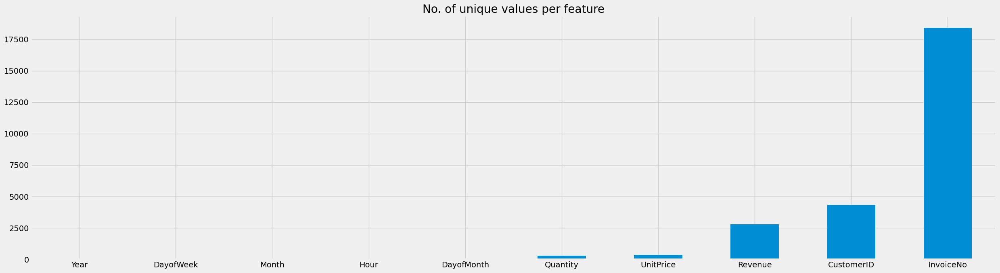

In [542]:
profiler.plotUniques(data)

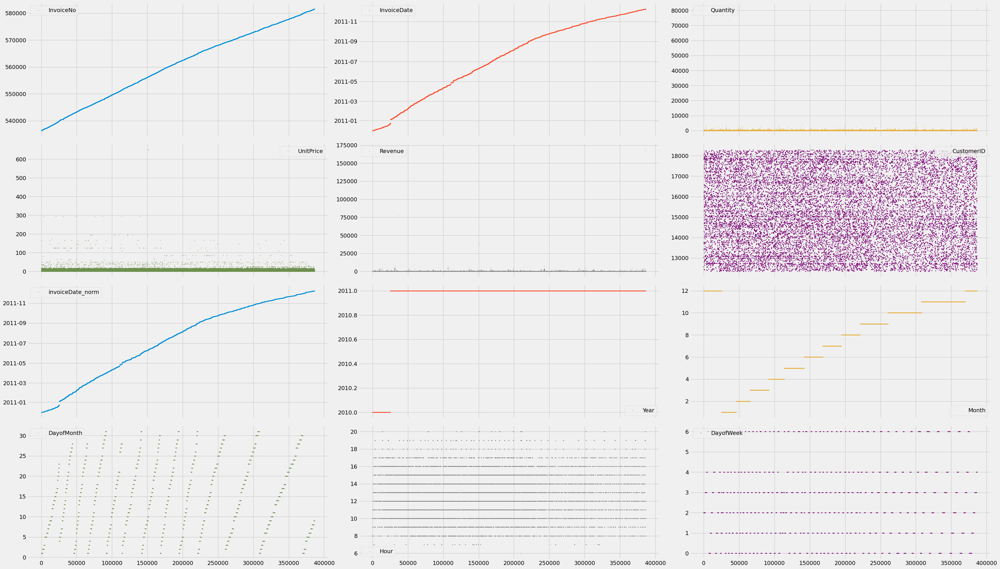

In [543]:
pd.set_option("display.max_columns", None)
# pd.set_option("display.float_format", "{:.2f}".format)
# pd.options.display.float_format = "{:.2f}".format

mpl.rcParams["text.color"] = "k"
plt.style.use("fivethirtyeight")

# params = {"legend.fontsize":"x-large",
#           "figure.figsize":(30,20),
#           "lines.linewidth":1.5,
#           "axes.labelsize":"x-large",
#           "axes.labelpad":15,
#           "axes.labelweight":"bold",
#           "axes.titlesize":35,
#           "axes.titleweight":"bold",
#           "xtick.labelsize":"x-large",
#           "ytick.labelsize":"x-large"}
# mpl.rcParams.update(params)

data.plot(lw=0, marker=".", layout=(4,3), subplots=True, markersize=1, figsize=(35, 20))
plt.tight_layout()
plt.show()

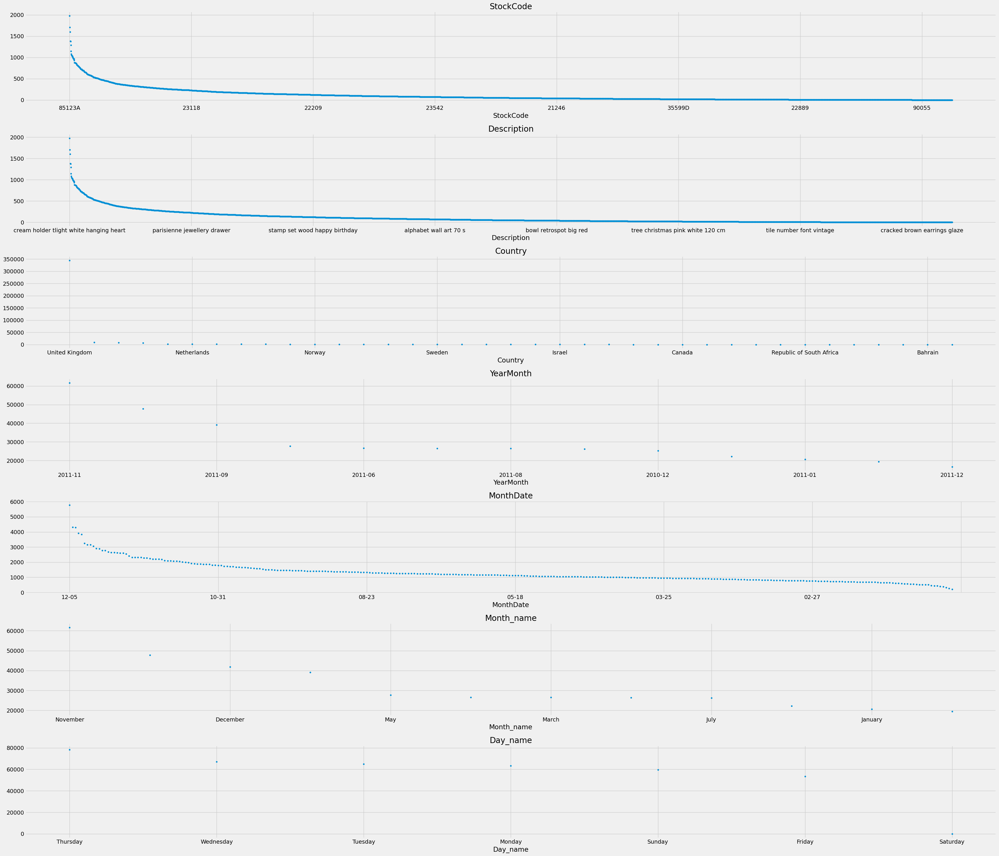

In [544]:
# create figure object with 3 subplots
fig, axes = plt.subplots(ncols=1, nrows=7, figsize=(35, 30))

# identify non-numerical features
data_non_numerical = data.select_dtypes(exclude=["number", "datetime"])

# loop through features and put each subplot on a matplotlib axis object
for col, ax in zip(data_non_numerical.columns, axes.ravel()):

    # selects one single feature and counts number of unique value
    data_non_numerical[col].value_counts().plot(

        # plots this information in a figure with log-scaled y-axis
        logy=False, title=col, lw=0, marker=".", ax=ax)
    
plt.tight_layout()
plt.show()

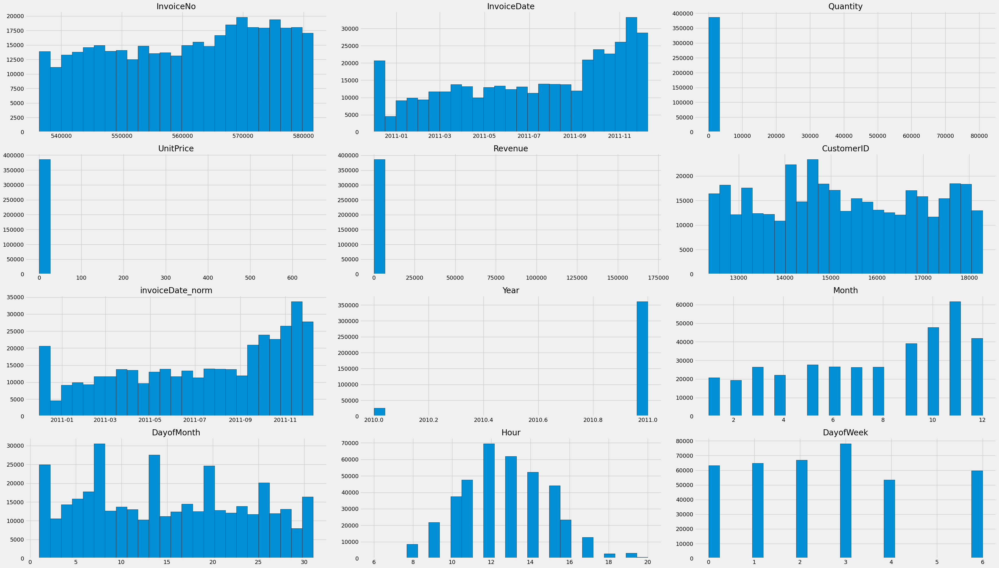

In [545]:
# plots the histogram for each numerical feature in a separate subplot
data.hist(bins=25, layout=(4, 3), edgecolor="black", figsize=(35, 20))
plt.tight_layout()
plt.show()

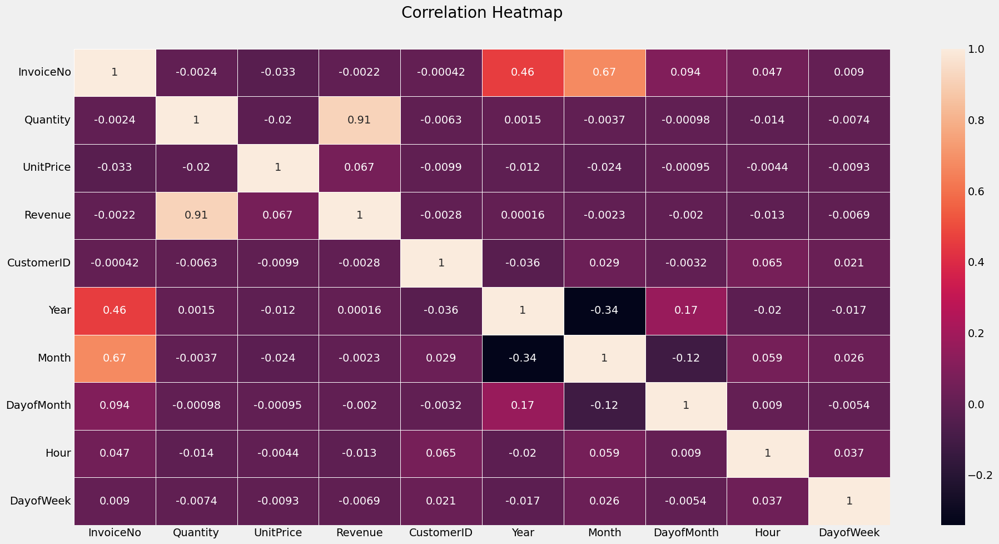

In [546]:
plt.figure(figsize=(20, 10))
sns.heatmap(data.corr(numeric_only=True), annot=True, linewidths=.5)
plt.title("Correlation Heatmap", pad=40)
plt.tight_layout()
plt.show()

We can conduct a correlation analysis with a mix of numeric and non-numeric or categorical data types in Python, but we'll have to treat the non-numeric or categorical variables differently from the numeric ones. 

For numerical data, we can use correlation techniques like Pearson's, Spearman's, or Kendall's.

However, for non-numeric or categorical variables, we should encode these before including them in your analysis. This is because correlation coefficients require numerical inputs.

Few common techniques to encode categorical variables:

1. **One-hot encoding**: This creates new columns indicating the presence (or absence) of each possible value in the original data.

2. **Ordinal encoding**: This converts each unique value of the categorical variable to a different integer.

3. **Target encoding**: This converts categories into the mean target value for that category. Be cautious when using this method as it can easily lead to overfitting.

Once our data is all in numeric format, we can compute the correlation matrix using the `pandas` library's `df.corr()` function. 

However, we should bear in mind that correlations can be misleading when applied to encoded categorical data. Correlation measures linear relationships between variables, and the numerical values assigned to categories through encoding are essentially arbitrary, so a "linear relationship" might not mean anything useful.

For relationships between categorical and numeric variables, there are different techniques such as ANOVA or Chi-Square test. There is also an algorithm named "Theil's U" or "Uncertainty Coefficient", which is suitable for both ordinal and nominal categorical data.

Finally, in case of dealing with both categorical and numerical data, more advanced techniques such as decision trees or random forests might be more appropriate since they can handle different types of data and capture complex relationships.

In [547]:
# plt.figure(figsize=(20, 20))
# sns.pairplot(data=data, hue="DayofWeek")
# plt.title("Pairplot", pad=40)
# plt.tight_layout()
# plt.show()

### Lens view

In [548]:
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    print(f"Lower outlier starts at: {lower_bound}€")
    print(f"Upper outlier starts at: {upper_bound}€")
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

def lower_outlier(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR

    print(f"Lower outlier starts at: {lower_bound}€")
    return df[(df[column] <= lower_bound)]

def upper_outlier(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    upper_bound = Q3 + 1.5 * IQR
    print(f"Upper outlier starts at: {upper_bound}€")
    return df[(df[column] >= upper_bound)]

# # Remove outliers for UnitPrice
# data = remove_outliers(data, 'UnitPrice')

# # Remove outliers for Revenue
# data = remove_outliers(data, 'Revenue')

In [549]:
remove_outliers(data, "UnitPrice")

Lower outlier starts at: -2.5€
Upper outlier starts at: 7.5€


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,536365,2010-12-01 08:26:00,21730,holder star frosted tlight glass,6,4.25,25.50,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
2,536365,2010-12-01 08:26:00,71053,moroccan white lantern metal,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
3,536365,2010-12-01 08:26:00,84029E,red hottie white heart woolly,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
4,536365,2010-12-01 08:26:00,84029G,water flag bottle hot knitted union,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
5,536365,2010-12-01 08:26:00,84406B,cream coat hanger cupid hearts,8,2.75,22.00,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386355,581587,2011-12-09 12:50:00,22730,bakelike clock ivory alarm,4,3.75,15.00,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386356,581587,2011-12-09 12:50:00,22899,apron childrens girl dolly,6,2.10,12.60,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386357,581587,2011-12-09 12:50:00,23254,kids dolly cutlery childrens girl,4,4.15,16.60,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386358,581587,2011-12-09 12:50:00,23255,parade childrens cutlery circus,4,4.15,16.60,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday


In [550]:
lower_outlier(data, "UnitPrice")

Lower outlier starts at: -2.5€


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name


In [551]:
upper_outlier(data, "UnitPrice")

Upper outlier starts at: 7.5€


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
1,536365,2010-12-01 08:26:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
11,536367,2010-12-01 08:34:00,21777,recipe box metal heart,4,7.95,31.80,13047,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
13,536367,2010-12-01 08:34:00,22622,alphabet box vintage blocks,2,9.95,19.90,13047,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
18,536367,2010-12-01 08:34:00,48187,new england doormat,4,7.95,31.80,13047,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
53,536373,2010-12-01 09:02:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,9,2,December,Wednesday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386215,581574,2011-12-09 12:09:00,23111,box sewing parisienne,2,12.50,25.00,12526,Germany,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386234,581578,2011-12-09 12:16:00,22622,alphabet box vintage blocks,6,11.95,71.70,12713,Germany,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386267,581579,2011-12-09 12:19:00,22941,lights 10 christmas reindeer,4,8.50,34.00,17581,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386300,581580,2011-12-09 12:20:00,22894,design apples tablecloth red,2,9.95,19.90,12748,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday


In [552]:
remove_outliers(data, "Revenue")

Lower outlier starts at: -17.325000000000003€
Upper outlier starts at: 42.075€


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
0,536365,2010-12-01 08:26:00,21730,holder star frosted tlight glass,6,4.25,25.50,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
1,536365,2010-12-01 08:26:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
2,536365,2010-12-01 08:26:00,71053,moroccan white lantern metal,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
3,536365,2010-12-01 08:26:00,84029E,red hottie white heart woolly,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
4,536365,2010-12-01 08:26:00,84029G,water flag bottle hot knitted union,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386355,581587,2011-12-09 12:50:00,22730,bakelike clock ivory alarm,4,3.75,15.00,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386356,581587,2011-12-09 12:50:00,22899,apron childrens girl dolly,6,2.10,12.60,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386357,581587,2011-12-09 12:50:00,23254,kids dolly cutlery childrens girl,4,4.15,16.60,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386358,581587,2011-12-09 12:50:00,23255,parade childrens cutlery circus,4,4.15,16.60,12680,France,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday


In [553]:
lower_outlier(data, "Revenue")

Lower outlier starts at: -17.325000000000003€


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name


In [554]:
upper_outlier(data, "Revenue")

Upper outlier starts at: 42.075€


,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name
19,536367,2010-12-01 08:34:00,84879,ornament assorted bird colour,32,1.69,54.08,13047,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
27,536370,2010-12-01 08:45:00,21035,retrospot red set 2 tea towels,18,2.95,53.10,12583,France,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
32,536370,2010-12-01 08:45:00,21913,jigsaw puzzles vintage seaside,12,3.75,45.00,12583,France,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
33,536370,2010-12-01 08:45:00,22326,set snack woodland round of 4 boxes,24,2.95,70.80,12583,France,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
37,536370,2010-12-01 08:45:00,22629,box spaceboy lunch,24,1.95,46.80,12583,France,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386317,581583,2011-12-09 12:23:00,85038,tlights love 6 heart chocolate,36,1.85,66.60,13777,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386318,581584,2011-12-09 12:25:00,20832,love red photo flock heart frame,72,0.72,51.84,13777,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386319,581584,2011-12-09 12:25:00,85038,tlights love 6 heart chocolate,48,1.85,88.80,13777,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday
386341,581586,2011-12-09 12:49:00,20685,doormat retrospot red,10,7.08,70.80,13113,United Kingdom,2011-12-09,2011,2011-12,12,12-09,9,12,4,December,Friday


## Business Intelligence: Insights

### Sales performance analysis

#### 1. What is the overall trend in revenue over time?

In [555]:
yearMonth_revenue = data.groupby(["YearMonth", "Month_name"])[["Revenue"]].sum()
yearMonth_revenue["Rank"] = yearMonth_revenue["Revenue"].rank(method="min", ascending=False)
yearMonth_revenue[["Revenue"]].reset_index()


,YearMonth,Month_name,Revenue
0,2010-12,January,0.00
1,2010-12,February,0.00
2,2010-12,March,0.00
3,2010-12,April,0.00
4,2010-12,May,0.00
...,...,...,...
151,2011-12,August,0.00
152,2011-12,September,0.00
153,2011-12,October,0.00
154,2011-12,November,0.00


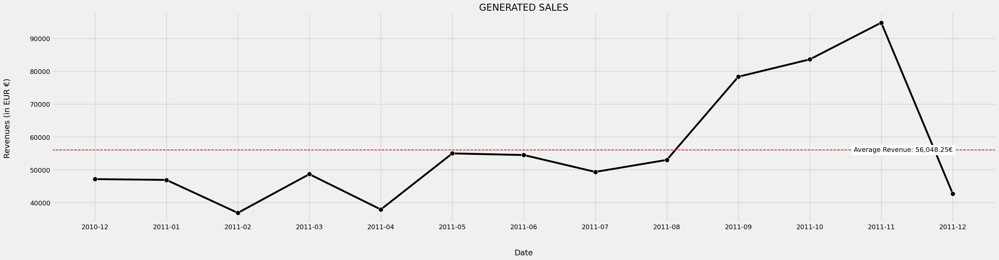

In [556]:
# plot
plt.figure(figsize=(30, 8))
ax = sns.lineplot(data=yearMonth_revenue, y="Revenue", x="YearMonth", marker="o", markersize=10, color="black", errorbar=None)

# configuration
ax.ticklabel_format(style="plain", axis="y")

# add a horizontal line at the mean revenue
mean_revenue = round(np.mean(yearMonth_revenue["Revenue"]),2)
plt.axhline(mean_revenue, color="r", linestyle="--", lw=1.5)
plt.text(data["YearMonth"].values[-1], mean_revenue, f"Average Revenue: {mean_revenue:,}€", va="center", ha="right", backgroundcolor="w")

# parameters
plt.title("GENERATED SALES")
plt.xlabel("Date", labelpad=40)
plt.ylabel("Revenues (in EUR €)", labelpad=40)
plt.tight_layout()
plt.show()

**Title: "Monthly Wholesale Revenue Trend Analysis: 2010 - 2011"** <br><br>

**Report:** <br>

The data presents the monthly wholesale revenue figures for a UK-based non-store retailer specializing in all-occasion gifts, for the period from December 2010 to December 2011.

The beginning of 2011 experienced relatively modest revenues, with a significant drop in February. However, starting from May, a marked increase was observed, and this trend continued until November. <br>
The strong performance from May to November suggests that this period might coincide with a peak buying season for wholesalers, potentially related to the preparation for major holidays or events.

Interestingly, there was a steep decline in revenue in December 2011. This could be due to a decrease in demand from wholesalers post their peak buying season. <br>Another possible reason might be that the wholesalers have already stocked up for the holiday season in the previous months.


**Key Insight:**

Understanding the buying patterns of the wholesalers is crucial for inventory management and demand forecasting. <br>
The significant growth from May to November followed by the sudden drop in December are notable patterns that need to be taken into account for future business planning.

In [557]:
data["Quarterly"] = data["invoiceDate_norm"].dt.to_period("Q")
data.head(2)

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name,Quarterly
0,536365,2010-12-01 08:26:00,21730,holder star frosted tlight glass,6,4.25,25.50,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday,2010Q4
1,536365,2010-12-01 08:26:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday,2010Q4


In [558]:
quarterly_data = data.groupby("Quarterly").agg({"Quantity":"sum", "Revenue":"sum"}).reset_index()

quarterly_data["percentage_TotalQuantity"] = ((quarterly_data["Quantity"] / quarterly_data["Quantity"].sum()) * 100).round(2)
quarterly_data["percentage_TotalRevenue"] = ((quarterly_data["Revenue"] / quarterly_data["Revenue"].sum()) * 100).round(2)

month_shift = quarterly_data["Revenue"].shift(1)
quarterly_data["percentage_change"] = (((quarterly_data["Revenue"] - month_shift) / month_shift)*100).round(2)

quarterly_transactions = data["Quarterly"].value_counts().to_frame().rename(columns={"count":"Transaction_count"}).reset_index()
quarterly_transactions["percentage_TotalTransactionCount"] = ((quarterly_transactions["Transaction_count"] / quarterly_transactions["Transaction_count"].sum()) * 100).round(2)

quarterly_data = quarterly_data.merge(quarterly_transactions, on="Quarterly")
quarterly_data = quarterly_data[["Quarterly", "Quantity", "Revenue", "percentage_change", "Transaction_count", "percentage_TotalQuantity", "percentage_TotalRevenue", "percentage_TotalTransactionCount"]]
quarterly_data

,Quarterly,Quantity,Revenue,percentage_change,Transaction_count,percentage_TotalQuantity,percentage_TotalRevenue,percentage_TotalTransactionCount
0,2010Q4,310648,565764.56,NaN,25215,6.03,6.47,6.53
1,2011Q1,960335,1589235.35,180.90,66581,18.63,18.18,17.23
2,2011Q2,1026545,1768299.44,11.27,76562,19.91,20.22,19.82
3,2011Q3,1307846,2167650.80,22.58,91874,25.37,24.79,23.78
4,2011Q4,1550134,2652576.64,22.37,126128,30.07,30.34,32.65


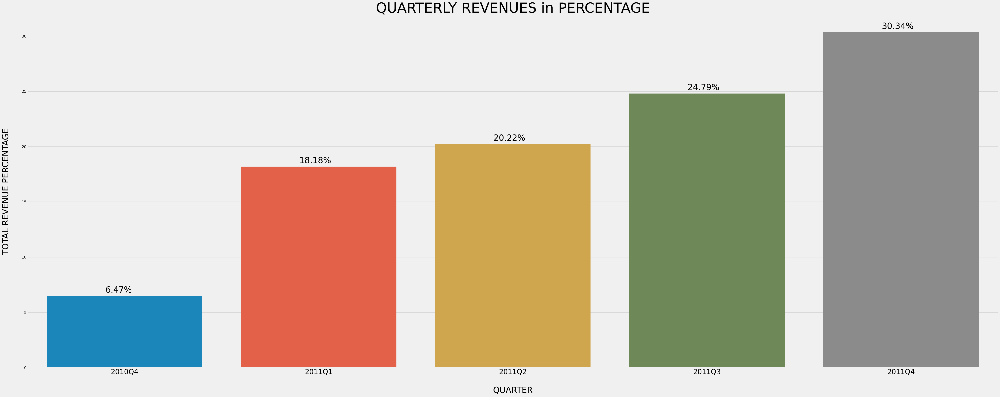

In [559]:
plt.figure(figsize=(50,20))

bar = sns.barplot(data=quarterly_data, x="Quarterly", y="percentage_TotalRevenue", errorbar=None)

bar.set_xlabel("QUARTER", fontsize=30, labelpad=40)
bar.set_ylabel("TOTAL REVENUE PERCENTAGE", fontsize=30, labelpad=40)

for p in bar.patches:
    bar.annotate(f"\n{p.get_height()}%", (p.get_x()+0.3, p.get_height()+0.3), color="k", fontsize=30)

plt.xticks(fontsize=25)
plt.title("QUARTERLY REVENUES in PERCENTAGE", fontsize=50)
plt.tight_layout()
plt.show()

**Title: "Quarterly Revenue and Transaction Analysis: 2010 - 2011"**

**Report:**

The provided data encapsulates the quarterly revenue, transaction count, and their respective changes for the UK-based non-store retail business that sells all-occasion gifts to wholesalers.

Starting with Q4 of 2010, the revenue was $565,764.56, which is considered the base for subsequent comparisons. <br>
The first quarter of 2011 (Q1) witnessed a significant rise in revenue by almost 181%, to $1,589,235.35, paired with a growth in transaction count to 66,581.

The growth trend continued into Q2 and Q3 of 2011, albeit at a slower pace. <br>
Q2 revenue grew by 11.27% to $1,768,299.44, while Q3 saw a more substantial increase of 22.58%, taking the revenue to $2,167,650.80.

Q4 of 2011 recorded the highest revenue and transaction count of the entire period. <br>
The revenue increased by another 22.37% from the previous quarter to $2,652,576.64, and the transaction count reached 126,128.

**Key Insights:**

1. Over the course of 2011, both revenue and transaction count demonstrated a steady growth quarter over quarter. This indicates an overall successful period for the business with consistent expansion.

2. Q1 2011 saw the most substantial quarterly growth in revenue, implying effective business strategies or market conditions that led to this surge. Identifying these contributing factors could be instrumental for future planning.

3. Despite slower revenue growth in Q2, the business picked up its pace in Q3 and Q4, showcasing its resilience and adaptability.

4. The highest percentage of total revenue, total transaction count, and total quantity was achieved in Q4, which could be related to the seasonal buying habits of the wholesalers, particularly for the holiday season. Hence, this trend should be factored into future business and inventory planning.

#### 2. How does revenue vary across different days of the week or months?

In [560]:
# Aggregating the data by the day of the week and month
grouped_data = data.groupby(["Month_name", "Day_name"])["Revenue"].sum().reset_index()
grouped_data

,Month_name,Day_name,Revenue
0,January,Sunday,39165.28
1,January,Monday,67208.53
2,January,Tuesday,182652.13
3,January,Wednesday,84050.65
4,January,Thursday,86138.62
...,...,...,...
79,December,Tuesday,143899.80
80,December,Wednesday,188494.31
81,December,Thursday,233166.95
82,December,Friday,303807.43


In [561]:
# Creating a pivot table for the heatmap
pivot_table = grouped_data.pivot(index="Month_name", columns="Day_name", values="Revenue")
pivot_table

Day_name,Sunday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday
Month_name,,,,,,,
January,39165.28,67208.53,182652.13,84050.65,86138.62,103682.70,0.00
February,27884.26,92972.33,106914.20,71074.17,74779.84,68868.79,0.00
March,42833.62,81389.60,114864.34,110131.11,150523.37,84101.81,0.00
April,29301.62,86011.97,91002.65,86121.49,100105.62,62312.53,0.00
May,66167.03,84949.71,145862.87,113002.51,147327.41,102369.11,0.00
June,66367.69,74281.38,116664.99,122495.20,166127.86,107827.80,0.00
July,88192.64,90815.34,107180.77,90791.66,143096.89,72026.49,0.00
August,38250.59,85551.31,92690.36,152336.31,189211.88,77823.93,0.00
September,98328.03,137366.91,205514.50,119455.99,230808.41,148208.79,0.00


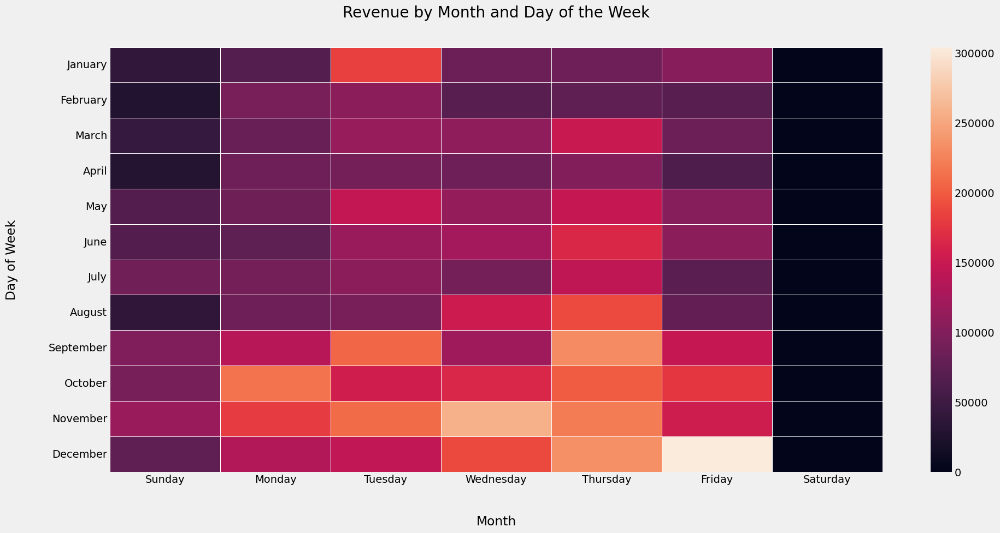

In [562]:
# Creating the heatmap
plt.figure(figsize=(20, 10))

sns.heatmap(pivot_table, linewidths=.5)

plt.title("Revenue by Month and Day of the Week", pad=40)
plt.xlabel("Month", labelpad=40)
plt.ylabel("Day of Week", labelpad=40)
plt.tight_layout()
plt.show()

**Title: "Analysis of Revenue Variation Across Different Days and Months"**

**Report:**

The provided dataset presents a detailed distribution of the revenue across different days of the week and months. This allows us to understand how the business's sales performance fluctuates over time, revealing several notable patterns and potential opportunities for targeted strategies.

**Key Insights:**

1. **Strong Sales During the Week** <br>
The company experiences solid sales from Monday to Friday, with a substantial increase in revenue in the middle of the week, particularly on Wednesdays, Thursdays, and Fridays. <br>
This trend suggests that promotional activities and customer engagement initiatives might be most effective if concentrated on these days.

2. **Saturday Lull** <br>
It is noteworthy that no sales are recorded on Saturdays across all months, suggesting that this non-store retail business may not be operating on this day.

3. **Significant Seasonality**<br>
The business seems to experience a strong seasonal pattern. Specifically, the revenue significantly increases from September to December, peaking in December. <br>
This period likely includes key sales events, such as Black Friday, Cyber Monday, and the holiday shopping season, which typically result in a surge in sales.

4. **Holiday Sales Boost**
<br>The revenue increase in December is particularly striking, with revenue on Fridays in December exceeding 300,000. <br>
This aligns with the holiday shopping trend, where consumers tend to make more purchases. <br>
The company could capitalize on this by offering holiday promotions or launching new products during this period.

5. **Mid-Year Dip**
<br>There is a relative dip in revenue during the middle of the year, specifically from April to July. <br>
This could be a period when sales naturally slow down after the start-of-year enthusiasm and before the holiday season rush. <br>
The company could consider introducing special deals or marketing campaigns during this period to boost sales.

By understanding how sales fluctuate over time, the business can optimize its sales strategies, aligning them with customer buying patterns to maximize revenue. <br>
This could include tailoring marketing initiatives to the times when customers are most likely to make purchases, or exploring opportunities to boost sales during quieter periods.

#### 3. Which are the top-selling products based on quantity sold or revenue generated?

In [563]:
# Group data by product and calculate total quantity sold and revenue generated for each product
product_data = data.groupby("Description").agg({"Quantity":"sum", "Revenue":"sum"}).reset_index()
product_data

,Description,Quantity,Revenue
0,0 tile cottage number garden,53,103.35
1,0 tile font number vintage,62,69.34
2,1 hook hanger garden magic,1198,965.26
3,1 tile cottage number garden,69,134.55
4,1 tile font number vintage,70,84.94
...,...,...,...
3620,zinc small watering vintage,16,79.20
3621,zinc sweetheart soap dish,59,104.41
3622,zinc tree painted christmas,2283,569.29
3623,zinc watering vintage,12,119.40


In [564]:
# Sort by quantity and plot top 10 products
top_products_quantity = product_data.sort_values("Quantity", ascending=False).head(10)
top_products_quantity

,Description,Quantity,Revenue
1949,little paper birdie craft,80995,168469.60
1794,jar storage medium ceramic,77916,81416.73
1058,designs world war asstd gliders 2,54319,13558.41
3085,small popcorn holder,49160,37206.88
1827,jumbo retrospot bag red,46078,85040.54
829,cream holder tlight white hanging heart,36763,100547.45
2207,ornament assorted bird colour,35263,56413.03
2222,pack 72 retrospot cake cases,33670,16381.88
2639,rabbit light night,27153,51251.24
3437,vintage paint set mini,26076,16039.24


In [565]:
# Sort by revenue and plot top 10 products
top_products_revenue = product_data.sort_values("Revenue", ascending=False).head(10)
top_products_revenue

,Description,Quantity,Revenue
1949,little paper birdie craft,80995,168469.60
3280,tier regency 3 cakestand,12384,142264.75
829,cream holder tlight white hanging heart,36763,100547.45
1827,jumbo retrospot bag red,46078,85040.54
1794,jar storage medium ceramic,77916,81416.73
456,bunting party,15283,68785.23
2207,ornament assorted bird colour,35263,56413.03
2639,rabbit light night,27153,51251.24
42,60 picnic small pieces basket wicker,1485,47348.35
1942,lights chilli,9646,46265.11


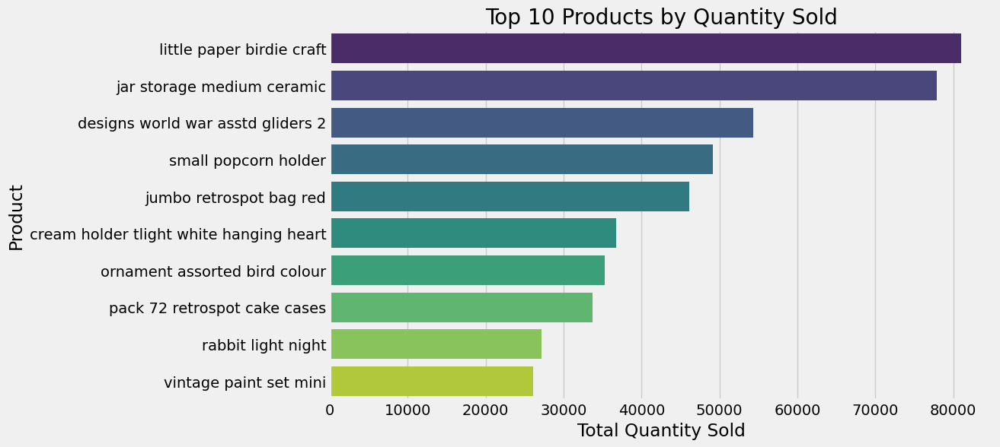

In [566]:
# Plot Products by quantity
plt.figure(figsize=(10,6))
sns.barplot(data=top_products_quantity, x="Quantity", y="Description", palette="viridis")
plt.title("Top 10 Products by Quantity Sold")
plt.xlabel("Total Quantity Sold")
plt.ylabel("Product")
plt.show()


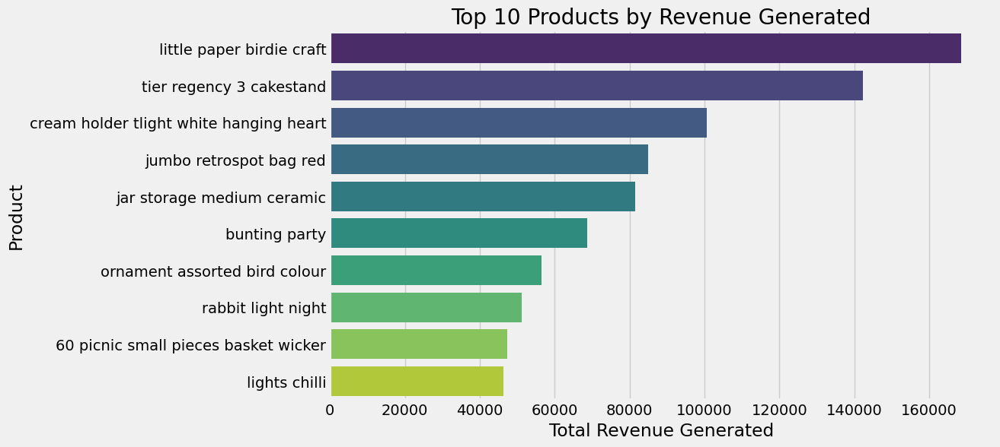

In [567]:
# Plot Products by revenue
plt.figure(figsize=(10,6))
sns.barplot(data=top_products_revenue, x="Revenue", y="Description", palette="viridis")
plt.title("Top 10 Products by Revenue Generated")
plt.xlabel("Total Revenue Generated")
plt.ylabel("Product")
plt.show()

**Title: "Top Selling Products: Quantity vs Revenue"**

**Report:**

The data provided showcases the top-selling products based on the quantity sold and the revenue generated.

When looking at the top-selling products based on quantity, the "little paper birdie craft" takes the lead with 80,995 units sold, followed by the "medium ceramic jar storage" with 77,916 units. <br>
This is interesting because despite having a slightly lower quantity sold, the "medium ceramic jar storage" does not match the revenue generated by the "little paper birdie craft." This might be due to a difference in unit prices.

In the revenue rankings, the "little paper birdie craft" continues to hold the top spot, generating $168,469.60. <br>
The "regency 3 tier cakestand," despite only selling 12,384 units (considerably lower in quantity), generated the second-highest revenue of $142,264.75. <br>
This implies that the "regency 3 tier cakestand" has a significantly higher unit price compared to most other products.

**Key Insights:**

1. The "little paper birdie craft" is a star product for the business, selling the most units and generating the most revenue. Its continued success could be dependent on product quality, price point, and demand consistency among the wholesalers.

2. The "regency 3 tier cakestand" ranks second in terms of revenue but is not among the top 10 for quantity sold. Its high revenue contribution despite lower sales volume suggests a high-profit-margin product.

3. Some products like "medium ceramic jar storage" and "red bag retrospot jumbo" have high sales volumes but do not generate equivalent high revenue, indicating lower-priced items. This might appeal to a different segment of wholesalers who are more price-sensitive.

4. Maintaining a mix of high-volume, low-margin items (like "medium ceramic jar storage") and lower-volume, high-margin items (like "regency 3 tier cakestand") could be a strategic approach to cater to the diverse needs of the wholesaler market.

### Customer behavior analysis

#### 1. Which customers contribute the most to the revenue?

In [568]:
customer_revenue = data.groupby(["CustomerID", "Country"])["Revenue"].sum().sort_values(ascending=False).reset_index()
customer_revenue

,CustomerID,Country,Revenue
0,14646,Netherlands,279138.02
1,18102,United Kingdom,259657.30
2,17450,United Kingdom,194390.79
3,16446,United Kingdom,168472.50
4,14911,Ireland,140336.83
...,...,...,...
4338,17956,United Kingdom,12.75
4339,14792,United Kingdom,6.20
4340,16454,United Kingdom,5.90
4341,16738,United Kingdom,3.75


In [569]:
top_customers_revenue = customer_revenue.head(20)
top_customers_revenue

,CustomerID,Country,Revenue
0,14646,Netherlands,279138.02
1,18102,United Kingdom,259657.30
2,17450,United Kingdom,194390.79
3,16446,United Kingdom,168472.50
4,14911,Ireland,140336.83
5,12415,Australia,124564.53
6,14156,Ireland,117210.08
7,17511,United Kingdom,91062.38
8,12346,United Kingdom,77183.60
9,16029,United Kingdom,72708.09


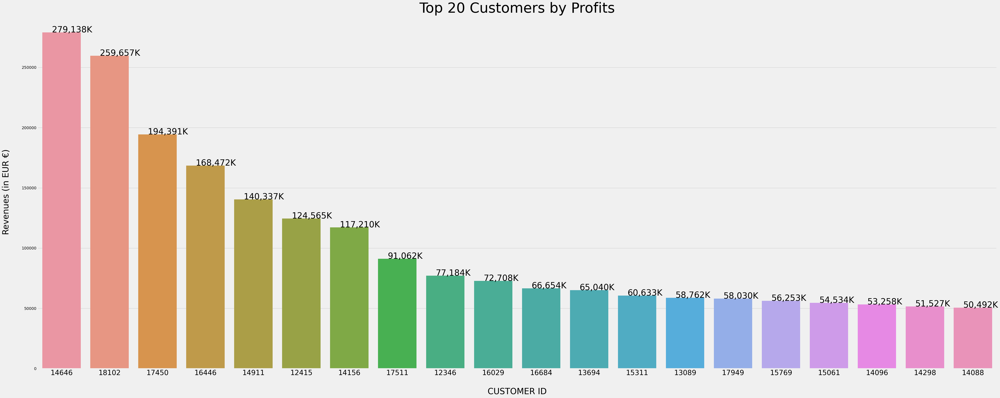

In [570]:
plt.figure(figsize=(50,20))

bar = sns.barplot(data=top_customers_revenue, x="CustomerID", y="Revenue", order=top_customers_revenue.sort_values("Revenue",ascending = False).CustomerID, errorbar=None)

bar.set_xlabel("CUSTOMER ID", fontsize=30, labelpad=40)
bar.set_ylabel("Revenues (in EUR €)", fontsize=30, labelpad=40)

for p in bar.patches:
    bar.annotate(f"\n{round(p.get_height()):,}K", (p.get_x()+0.2, p.get_height()+3), color="k", fontsize=30)

plt.xticks(fontsize=25)
# plt.xlabel("CUSTOMER ID", fontsize=30, labelpad=40)
# plt.ylabel("Revenues (in EUR €)", fontsize=30, labelpad=40)
plt.title("Top 20 Customers by Profits", fontsize=50)
plt.tight_layout()
plt.show()

**Top Revenue Contributing Customers Analysis**

The analysis of our sales data reveals important insights about customers contributing the most to the overall revenue. <br>
We have the following top 20 customers from various countries who have contributed the highest revenue to our company (cf figure above)

**Key insights**

- The majority of our top revenue contributors are based in the United Kingdom, reflecting the strong customer base in this location.
- Customer 14646 from the Netherlands tops the list with a substantial total revenue of 279,138.02, demonstrating the presence of high-value customers outside of the UK as well.
- There are significant revenue contributions from customers in Ireland and Australia, indicating potential markets for further exploration and expansion.
- The revenue distribution among the top 20 customers varies from approximately 50,491.81 to 279,138.02, which signifies the need for different customer engagement strategies based on their contribution.
- The diversity of these top revenue contributors suggests the importance of international sales and the need to maintain a diverse and globally distributed customer base.

#### 2. Which customers buy most frequently?

In [571]:
customer_frequency = data.groupby(["CustomerID", "Country"]).size().sort_values(ascending=False).to_frame().reset_index().rename({0: "Number_Purchase"}, axis=1)
top_customer_frequency = customer_frequency.head(20)
top_customer_frequency

,CustomerID,Country,Number_Purchase
0,17841,United Kingdom,7465
1,14911,Ireland,5667
2,14096,United Kingdom,5090
3,12748,United Kingdom,4272
4,14606,United Kingdom,2654
5,15311,United Kingdom,2357
6,14646,Netherlands,2064
7,13089,United Kingdom,1812
8,13263,United Kingdom,1647
9,14298,United Kingdom,1632


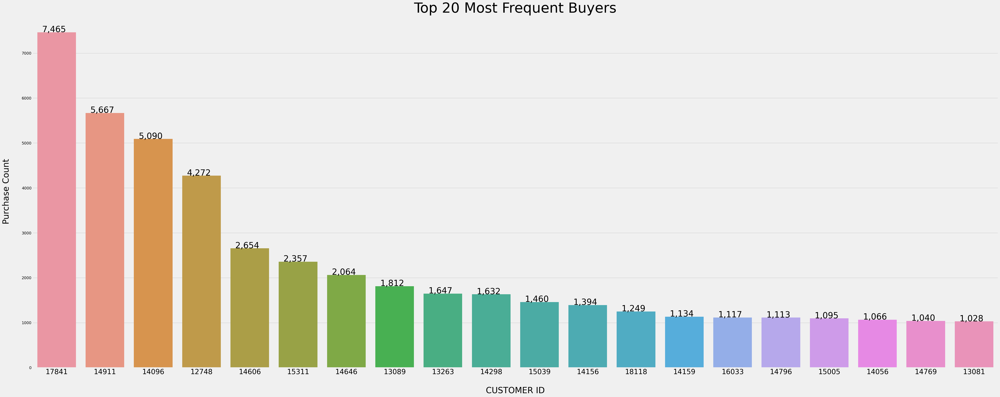

In [572]:
plt.figure(figsize=(50,20))

bar = sns.barplot(data=top_customer_frequency, x="CustomerID", y="Number_Purchase", order=top_customer_frequency.sort_values("Number_Purchase",ascending = False).CustomerID, errorbar=None)

bar.set_xlabel("CUSTOMER ID", fontsize=30, labelpad=40)
bar.set_ylabel("Purchase Count", fontsize=30, labelpad=40)

for p in bar.patches:
    bar.annotate(f"\n{round(p.get_height()):,}", (p.get_x()+0.1, p.get_height()+3), color="k", fontsize=30)

plt.xticks(fontsize=25)
# plt.xlabel("CUSTOMER ID", fontsize=30, labelpad=40)
# plt.ylabel("Purchase Count", fontsize=30, labelpad=40)
plt.title("Top 20 Most Frequent Buyers", fontsize=50)
plt.tight_layout()
plt.show()

**Title: "Analysis of Most Frequent Buyers"**

**Report:**

This analysis highlights the customers who make the most purchases from the business. It reveals some interesting patterns and insights about the business's most frequent buyers.

**Key Insights:**

1. The top purchaser, customer 17841, made a staggering 7465 purchases, significantly higher than the rest of the customers. This customer alone could be contributing a considerable chunk of the business's regular sales volume.

2. The second most frequent purchaser, customer 14911, made 5667 purchases. This is about 76% of the purchases made by the top customer. The significant drop between the first and second buyers indicates that the top customer is an outlier, with an exceptionally high number of purchases.

3. While customer 14096 made the third-highest number of purchases (5090), there is a gradual decrease in the number of purchases as we move down the list, implying a diverse range of purchasing behaviors among customers.

4. Of the 20 customers listed, customer 13081, who ranks 20th, made 1028 purchases, which is only about 14% of the number of purchases made by the top customer. This wide range suggests that the business has a broad customer base with different buying frequencies.

This analysis highlights the importance of frequent buyers for maintaining a steady flow of sales. The business may benefit from loyalty programs or special promotions targeted at these customers to sustain their purchasing frequency and potentially stimulate increased spending. It's also worthwhile exploring strategies to motivate less frequent buyers to purchase more often, thereby boosting the overall sales volume.

#### 3. Which customers bought the most items?

In [573]:
customer_purchase = data.groupby(["CustomerID", "Country"])["Quantity"].sum().sort_values(ascending=False).reset_index()
top_customer_purchase = customer_purchase.head(20)
top_customer_purchase

,CustomerID,Country,Quantity
0,14646,Netherlands,197420
1,16446,United Kingdom,80997
2,14911,Ireland,80488
3,12415,Australia,77669
4,12346,United Kingdom,74215
5,17450,United Kingdom,69973
6,17511,United Kingdom,64549
7,18102,United Kingdom,64124
8,13694,United Kingdom,63312
9,14298,United Kingdom,58343


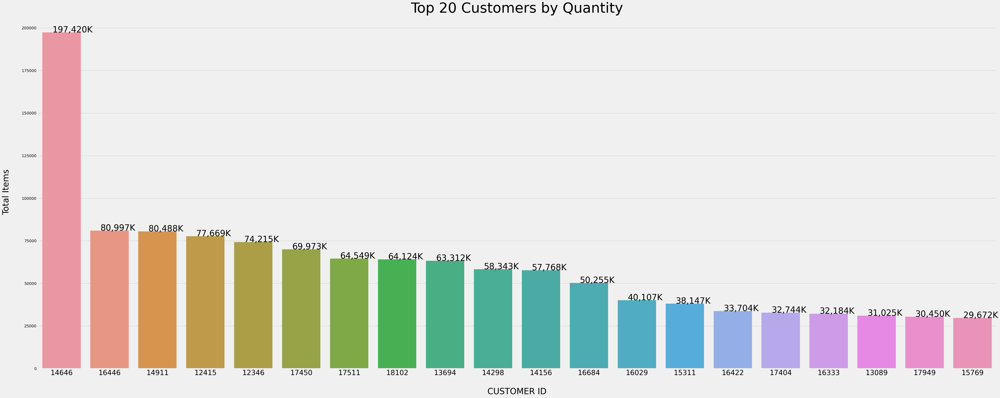

In [574]:
plt.figure(figsize=(50,20))

bar = sns.barplot(data=top_customer_purchase, x="CustomerID", y="Quantity", order=top_customer_purchase.sort_values("Quantity",ascending = False).CustomerID, errorbar=None)

bar.set_xlabel("CUSTOMER ID", fontsize=30, labelpad=40)
bar.set_ylabel("Total Items", fontsize=30, labelpad=40)

for p in bar.patches:
    bar.annotate(f"\n{round(p.get_height()):,}K", (p.get_x()+0.21, p.get_height()+3), color="k", fontsize=30)

plt.xticks(fontsize=25)
# plt.xlabel("CUSTOMER ID", fontsize=30, labelpad=40)
# plt.ylabel("Purchase Count", fontsize=30, labelpad=40)
plt.title("Top 20 Customers by Quantity", fontsize=50)
plt.tight_layout()
plt.show()

**Title: "Analysis of Total Quantity Purchased by Customers"**

**Report:**

The table provides a comprehensive look at the customers who have purchased the highest total quantities from the business. The geographical distribution of these top customers highlights the business's international reach, while the quantity of purchases offers insights into customer demand and potential inventory considerations.

**Key Insights:**

1. Customer 14646 from the Netherlands leads the pack with a total of 197,420 units purchased, exhibiting a tremendous buying power. This is significant considering the business's wholesaling nature.

2. The United Kingdom seems to be a crucial market for the business, with a significant number of top buyers originating from this country. Among the top 20 customers, 14 are from the UK. 

3. The second-highest quantity of purchases (80,997 units) is attributed to customer 16446 from the United Kingdom. However, this is less than half of the total quantity purchased by the top customer. This substantial difference underscores the unique buying power of customer 14646.

4. Interestingly, the top 20 list also includes customers from Ireland, Australia, and Sweden, suggesting the business has a diverse international customer base.

5. The 20th customer on the list, customer 15769 from the United Kingdom, has purchased 29,672 units, which is about 15% of what the top customer has bought. This indicates a wide range of buying quantities among the top customers.

From these insights, it's clear that the business's sales are heavily influenced by high-volume buyers. Targeted marketing and customer service efforts for these customers could enhance their loyalty and potentially increase sales. Additionally, understanding the buying patterns of these high-volume customers could inform inventory management and supply chain decisions.

#### 4. When do customers make most of their purchases?

In [575]:
# create a pivot table with DayofWeek as rows and Hour	 as columns
pivot_table = data.pivot_table(index="Day_name", columns="Hour", aggfunc="size", fill_value=0)
pivot_table

Hour,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
Day_name,,,,,,,,,,,,,,,
Sunday,0,0,0,25,3436,9668,12734,11118,9337,9696,3673,0,0,0,0
Monday,0,61,1558,4313,6045,7282,10398,10275,8963,7510,3939,2918,0,0,0
Tuesday,0,64,1700,4516,6503,8327,11704,10130,9254,7126,3532,1922,67,0,0
Wednesday,0,59,1802,4050,6878,8170,12451,10931,8566,7626,4140,2287,0,14,18
Thursday,1,64,1753,4537,7466,7075,12728,11224,9054,7480,5963,4257,2802,3054,732
Friday,0,128,1818,4336,7062,7033,9590,8176,7127,4614,2033,1371,2,87,7
Saturday,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [576]:
data[data["DayofWeek"].isin([0,1,2,3,4,5,6])].groupby(["DayofWeek", "Day_name"], as_index=False)[["CustomerID"]].count().iloc[:,:-1]

,DayofWeek,Day_name
0,0,Sunday
1,0,Monday
2,0,Tuesday
3,0,Wednesday
4,0,Thursday
5,0,Friday
6,0,Saturday
7,1,Sunday
8,1,Monday
9,1,Tuesday


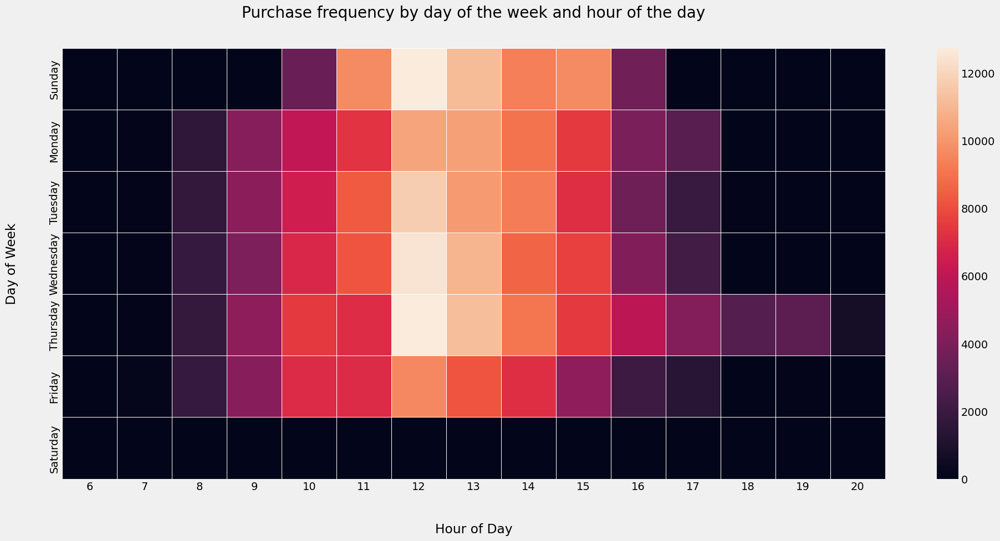

In [577]:
plt.figure(figsize=(20, 10))

sns.heatmap(pivot_table,linewidths=.5)

plt.title("Purchase frequency by day of the week and hour of the day", pad=40)
plt.xlabel("Hour of Day", labelpad=40)
plt.ylabel("Day of Week", labelpad=40)
plt.tight_layout()
plt.show()


**Title: "Customer Purchase Timing Analysis (Daily and Hourly Sales)"**

**Report:**

The provided data demonstrates the hourly distribution of purchases made by the customers throughout the week. <br>
It allows us to identify peak hours and days for customer purchases.

On weekdays, from Monday (0) to Thursday (3), the number of purchases starts to grow at 8 am. <br>
The majority of transactions occur between 10 am and 3 pm, with a peak at noon and early afternoon hours (11 am to 2 pm) and starts to decline after 2 pm. <br>
This pattern aligns with typical business hours and likely reflects when customers have time to place orders during the workday.

It's apparent that customers tend not to make purchases early in the morning (6-7 am) and late in the evening (6 pm onwards), with almost no activity recorded during these periods on most days. 

Interestingly, Thursday sees sustained activity until 5 pm, with an unusual surge of purchases in the evening hours (6-8 pm), the only day to show such a trend. 

Fridays also have a significant number of purchases but see a faster drop-off in the afternoon compared to other weekdays. 

It's also important to note that Saturdays see no activity, suggesting that this non-store retail business may not be operating on this day.

Sunday (6), though not a typical business day, also sees a substantial number of transactions, mainly taking place from 10 am to 3 pm. <br>
There's no activity before 9 am and after 4 pm on Sunday.

**Key Insights:**

1. Most transactions occur during typical business hours (10 am to 3 pm). It's the most active time for customer purchases. <br>
Indicating this is the optimal time to ensure customer service resources are available, and efforts should be made to ensure optimal service and availability during this period.

2. The unusual surge in purchases on Thursday evenings indicates that customers might be preparing for the weekend. <br>
The extended activity on Thursdays may represent an opportunity to promote products or offer specific deals.

3. The quick drop-off of activity on Fridays could indicate the start of a slower weekend period, and strategies could be developed to incentivize Friday afternoon shopping.

3. The peak transaction time (11 am to 2 pm) could be used for targeted promotions or special deals to drive further sales.

5. The low activity in the early morning and late evening can be taken into consideration for business hours or staff scheduling. 

5. Despite being a weekend day, Sunday has a similar pattern to weekdays but with no transactions recorded after 4 pm. <br>
This indicates an opportunity to extend business hours or run special promotions to encourage more transactions during these times.

Please note, the dataset does not contain any data for Saturday, so no observations could be made for this day.




#### 5. What are the most common quantities of items per purchase?

In [578]:
# Creating a new DataFrame with the quantities per invoice
quantity_per_invoice = data.groupby("InvoiceNo")["Quantity"].sum().reset_index()
display(quantity_per_invoice)
display(quantity_per_invoice.describe())

,InvoiceNo,Quantity
0,536365,40
1,536366,12
2,536367,83
3,536368,15
4,536369,3
...,...,...
18414,581583,76
18415,581584,120
18416,581585,278
18417,581586,66


,InvoiceNo,Quantity
count,18419.00,18419.00
mean,559517.58,279.90
std,13049.54,978.90
min,536365.00,1.00
25%,548333.50,75.00
50%,559797.00,156.00
75%,570832.50,291.00
max,581587.00,80995.00


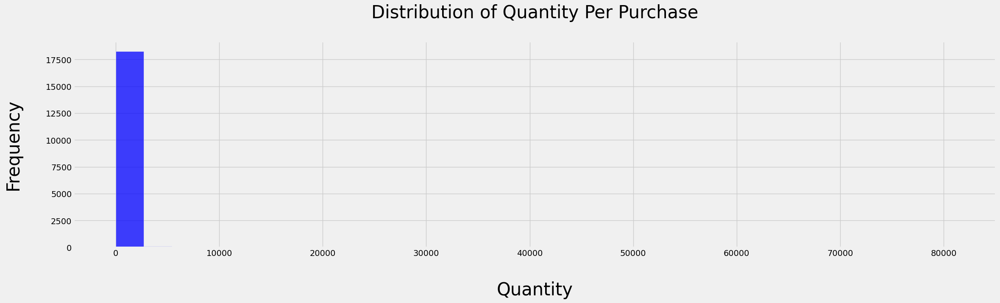

In [579]:
plt.figure(figsize=(25, 6))

sns.histplot(quantity_per_invoice["Quantity"], bins=30, kde=False, color="blue")

plt.title("Distribution of Quantity Per Purchase", fontsize=30, pad=40)
plt.xlabel("Quantity", fontsize=30, labelpad=40)
plt.ylabel("Frequency", fontsize=30, labelpad=40)
plt.show()

,InvoiceNo,Quantity
0,536365,40
1,536366,12
2,536367,83
3,536368,15
4,536369,3
...,...,...
18414,581583,76
18415,581584,120
18416,581585,278
18417,581586,66


,InvoiceNo,Quantity
count,17072.00,17072.00
mean,559446.01,176.48
std,13065.97,137.64
min,536365.00,1.00
25%,548265.25,70.00
50%,559523.50,143.00
75%,570834.50,250.00
max,581587.00,615.00


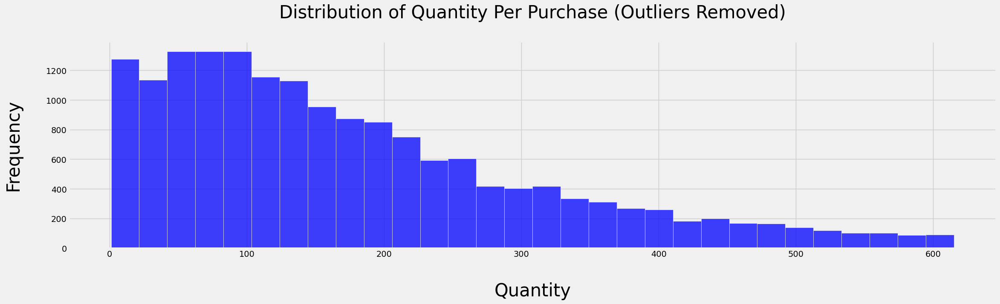

In [580]:
# Calculating IQR
Q1 = quantity_per_invoice["Quantity"].quantile(0.25)
Q3 = quantity_per_invoice["Quantity"].quantile(0.75)
IQR = Q3 - Q1

# Filtering values between Q1-1.5IQR and Q3+1.5IQR
filtered_quantity_per_invoice = quantity_per_invoice.query("(@Q1 - 1.5 * @IQR) <= Quantity <= (@Q3 + 1.5 * @IQR)")
display(filtered_quantity_per_invoice)
display(filtered_quantity_per_invoice.describe())

# Creating the histogram
plt.figure(figsize=(25, 6))

sns.histplot(filtered_quantity_per_invoice["Quantity"], bins=30, kde=False, color="blue")

plt.title("Distribution of Quantity Per Purchase (Outliers Removed)", fontsize=30, pad=40)
plt.xlabel("Quantity", fontsize=30, labelpad=40)
plt.ylabel("Frequency", fontsize=30, labelpad=40)
plt.show()

**Title: "Understanding Purchase Quantities: The Impact of Outliers"**

**Report 1 - The Influence of Outliers on Purchase Quantities:**

In the unfiltered data, we're looking at a wide range of purchase quantities - from a single item to a whopping 80,995 items in one order. This vast range gives us an average order size of around 280 items. However, this average is significantly influenced by those rare but extremely large orders, making it not fully representative of a typical order size. What's more, the median order size (the 50% mark), is just 156 items, nearly half the average value, demonstrating the considerable impact of those large orders on the overall average.

**Key Insight:** While large orders are definitely part of the business, they don't represent the norm. Most orders tend to be much smaller, with half of them having 156 items or less.

---

**Title: "Purchase Quantities: A Look Without Outliers"**

**Report 2 - The More Typical Picture:**

When we remove the outliers from the data, we get a more balanced picture of the typical order size. With outliers removed, our average order size drops significantly to 176 items. This trimmed down number aligns better with the median order size of 143 items, indicating a more consistent order size across the customer base.

**Key Insight:** The average order size, once extreme cases are removed, is 176 items. This is a more accurate representation of the company's regular transaction size.

---

**Title: "Comparing Purchase Quantities: Outliers vs. Typical Orders"**

**Report 3 - The Tale of Two Datasets:**

When comparing the two sets of data, it becomes clear that large, outlier orders significantly inflate the average quantity per order. Without these outliers, the average drops by over 100 items, a decrease of about 37%. This change shows that while big orders contribute to the company's overall sales, they are not reflective of the typical transaction size.

**Key Insight:** There are two distinct types of transactions: regular ones (majority of transactions, smaller in size) and large ones (few but significantly larger). Recognizing this difference is crucial for understanding customer behavior and shaping business strategy accordingly.

### Geographic market analysis

#### 1. How does the revenue vary across different countries?

FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. We can get the original 'naturalearth_lowres' data [here](https://www.naturalearthdata.com/downloads/110m-cultural-vectors/)

In [581]:
# Get the order of the countries by total revenue
country_revenues = data.groupby("Country")["Revenue"].sum().sort_values(ascending=False).reset_index()
country_revenues


,Country,Revenue
0,United Kingdom,7243943.47
1,Netherlands,283889.34
2,Ireland,261888.12
3,Germany,205381.15
4,France,183987.94
5,Australia,138103.81
6,Spain,55706.56
7,Switzerland,52834.65
8,Japan,37416.37
9,Belgium,36927.34


It's no surprise that the sales figure is mostly dominated by the UK since this store operates within the UK.

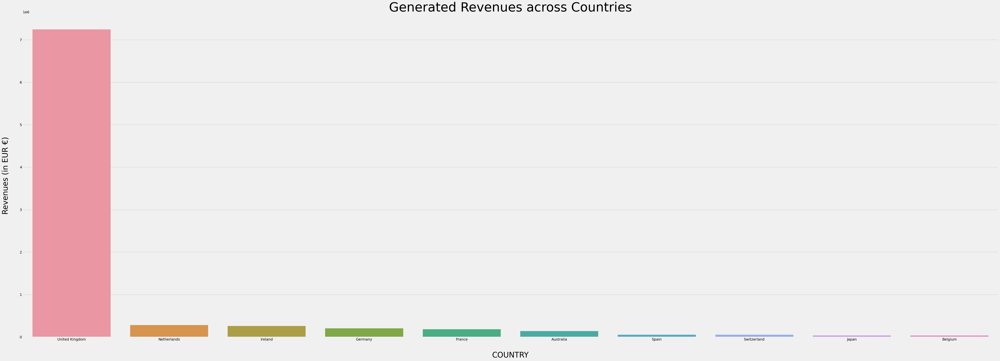

In [582]:
# plot
plt.figure(figsize=(55,20))

sns.barplot(data=country_revenues.head(10), x="Country", y="Revenue", errorbar=None)

plt.xlabel("COUNTRY", fontsize=30, labelpad=40)
plt.ylabel("Revenues (in EUR €)", fontsize=30, labelpad=40)
plt.title("Generated Revenues across Countries", fontsize=50)
plt.tight_layout()
plt.show()

**Title: "Revenue Variation Across Countries"** <br><br>

**Report:**

The provided data demonstrates how the revenue of the UK-based non-store retail business varies across different countries.

The United Kingdom is the biggest market for the company, contributing a substantial $7,243,943.47 to the revenue. <br>

The Netherlands comes second, but with a significantly smaller contribution of $283,889.34. <br>
Ireland closely follows the Netherlands, with total revenue of $261,888.12.

Other European countries, such as Germany, France, Spain, and Switzerland, also make substantial contributions, with revenues ranging from $52,834.65 to $205,381.15. <br>
Australia is the major contributor outside of Europe, bringing in $138,103.81 in revenue.

Interestingly, the revenue from the USA and Canada is relatively low, with respective revenues of $3580.39 and $3115.44. <br>
The revenue from other countries, such as Brazil, the Republic of South Africa, the Czech Republic, Bahrain, and Saudi Arabia, is even lower, each contributing less than $2000.

**Key Insights:**

1. The UK is by far the biggest market for the company. Maintaining and strengthening these relationships is crucial for business sustainability.

2. Europe, in general, contributes a significant portion of the total revenue, with the Netherlands, Ireland, Germany, and France being the top contributors after the UK. It may be beneficial to explore opportunities for further growth within these markets.

3. Despite being large economies, the revenue from the USA and Canada is relatively low. Understanding the reasons behind this could open new avenues for expansion and revenue growth.

4. A number of countries generate very low revenues. It may be worth investigating if continued operations in these regions are cost-effective, or if the business should focus on higher-performing markets.

#### 2. Are there any specific products or categories that are popular in certain countries?

Bar chart: Top products by country (x-axis: Product, y-axis: Quantity or Revenue, color: Country)

In [583]:
# Select top N products for each country by total quantity
N = 3
top_products = data.groupby(["Country", "Description"])["Quantity"].sum().reset_index()
top_products = top_products.groupby("Country").apply(lambda x: x.nlargest(N, "Quantity")).reset_index(drop=True)
top_products = top_products.head(18)
top_products

,Country,Description,Quantity
0,Australia,vintage paint set mini,2952
1,Australia,rabbit light night,1884
2,Australia,box harmonica red,1704
3,Austria,colour set kids chalk 12 sticks,288
4,Austria,jigsaw purdey mini,240
5,Austria,pack gift sweetie boxes 6,144
6,Bahrain,cream ice sundae lip gloss,96
7,Bahrain,gloss doughnut lip,60
8,Bahrain,grow sunflower tin flytrap,24
9,Belgium,pack 72 retrospot cake cases,480


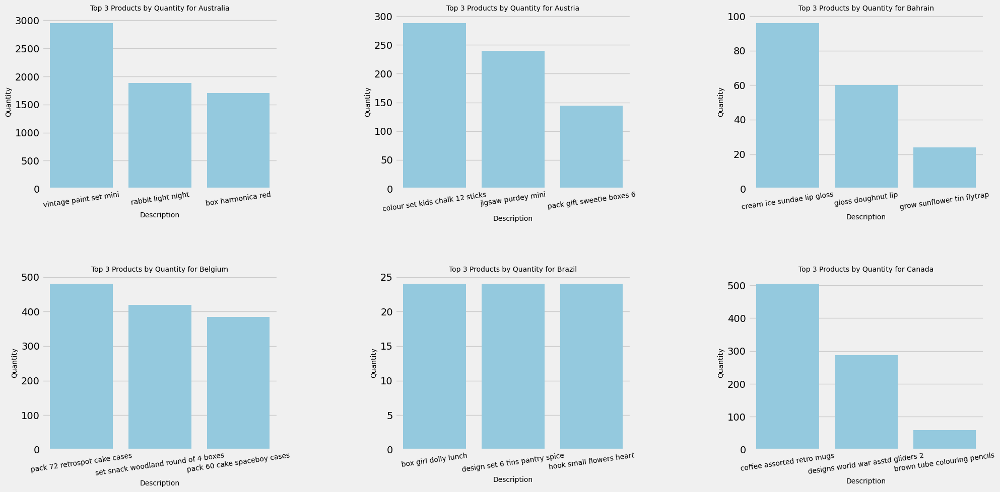

In [584]:
# Get the list of unique countries from the dataset
unique_countries = top_products["Country"].unique()

# Define the number of rows and columns for the subplots
n_cols = 3
n_rows = math.ceil(len(unique_countries) / n_cols)
n_cols = min(len(unique_countries), n_cols)  # No more columns than countries

# Create the figure and axes objects
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 5))

if n_rows > 1:
    axes = axes.reshape(-1, n_cols)  # Ensure axes is always 2-D
else:
    axes = [axes]  # Handle case when there is only one row

# For each country, create a bar plot of the top N products
for idx, country in enumerate(unique_countries):
    country_data = top_products[top_products["Country"] == country]
    row_idx = idx // n_cols
    col_idx = idx % n_cols
    ax = axes[row_idx][col_idx]
    
    chart = sns.barplot(x="Description", y="Quantity", data=country_data, color="skyblue", ax=ax)
    chart.set_xticklabels(chart.get_xticklabels(), rotation=8, fontsize=10)
    ax.set_xlabel("Description", fontsize=10)
    ax.set_ylabel("Quantity", fontsize=10)
    ax.set_title("Top {} Products by Quantity for {}".format(N, country), fontsize=10)  # adjust fontsize as needed

# Hide empty subplots
for idx in range(len(unique_countries), n_rows * n_cols):
    fig.delaxes(axes.flatten()[idx])

# Adjust the layout
plt.tight_layout()

# Add space between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.5)

plt.show()

**Title: "Analysis of Most Popular Products by Country"**

**Report:**

The provided table lists the most popular products for each country based on the quantity sold. This reveals some intriguing trends about customer preferences in different countries and presents opportunities for targeted marketing strategies.

**Key Insights:**

1. The 'paper craft little birdie' is the most popular item in the United Kingdom, with a staggering 80,995 units sold. Given the significant customer base in the UK, as evident from earlier reports, this item's popularity suggests that it could be a major revenue driver for the business.

2. Interestingly, 'night rabbit light' appears to be a universal favorite, being the most popular product in France, Japan, and the Netherlands. This could signify a broad, cross-cultural appeal of this product.

3. The 'set vintage mini paint' is another product that shows cross-border appeal, being the most popular in both Australia and Sweden. 

4. Items such as 'set polkadot cutlery childrens pink piece 3', '72 retrospot pack cake cases', and 'assorted mugs coffee retro' seem to be popular kitchen and dining items in Finland, Belgium, and Canada, respectively, indicating a demand for these types of products in these markets.

5. Some countries, such as the Republic of South Africa and Saudi Arabia, show lower quantity sales for their top products. This could point to untapped potential in these markets or may reflect a smaller customer base in these regions.

By identifying the most popular products in each country, the business can create customized marketing strategies to promote these products further and introduce complementary items. Additionally, these insights could guide product development efforts, allowing the company to create products that resonate with customers in different markets.

#### 3. What is the geographic distribution of customers?

In [585]:
# Count the number of unique customers per country
customer_counts = data.groupby("Country")["CustomerID"].nunique().sort_values(ascending=False)
customer_counts_framed = data.groupby("Country")["CustomerID"].nunique().to_frame().reset_index().sort_values(by="CustomerID", ascending=False).rename({"CustomerID": "NumberofCustomers"}, axis=1)
customer_counts_framed

,Country,NumberofCustomers
35,United Kingdom,3918
13,Germany,94
12,France,87
30,Spain,30
3,Belgium,25
32,Switzerland,21
26,Portugal,19
18,Italy,14
11,Finland,12
1,Austria,11


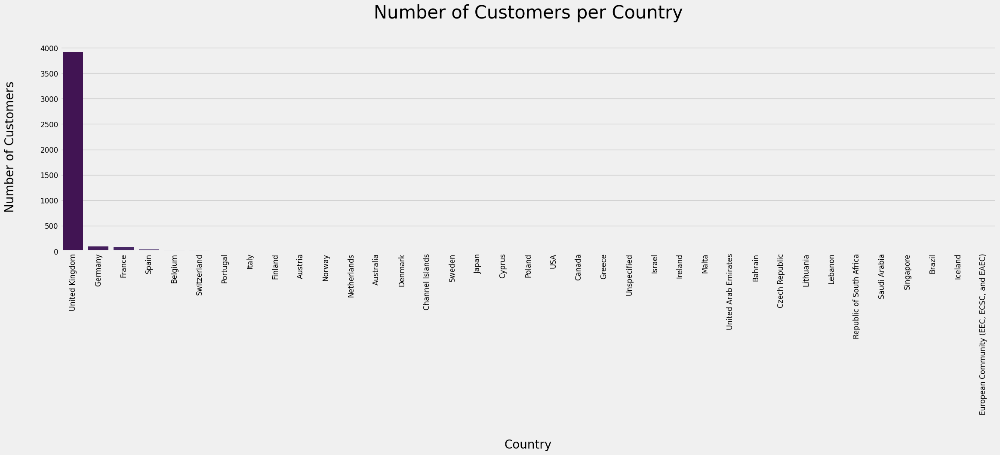

In [586]:
plt.figure(figsize=(25, 6))

sns.barplot(x=customer_counts.index, y=customer_counts.values, palette="viridis", errorbar=None)

plt.title("Number of Customers per Country", fontsize=30, pad=40)
plt.xlabel("Country", fontsize=20, labelpad=40)
plt.ylabel("Number of Customers", fontsize=20, labelpad=40)
plt.xticks(rotation=90, fontsize=12)
plt.yticks(fontsize=12)
plt.show()

**Title: "Geographical Distribution of Customers"**

**Report:**

The vast majority of the customers for the gift wholesaler are based in the United Kingdom, with 3,918 customers. This is not surprising given the company's location. Other notable customer bases exist in Germany and France, with 94 and 87 customers respectively. Beyond these countries, the customer numbers are significantly smaller, ranging from 30 customers in Spain to just one in several countries, including Singapore, Saudi Arabia, Brazil, and Iceland among others.

However, the presence of customers in a diverse array of countries, from different continents and cultural backgrounds, suggests that the company's gift products have a wide appeal. It also implies the potential for growth in these international markets.

**Key Insight:** 

The UK is the core market for the business, followed by Germany and France. However, there is a broad distribution of customers around the world, indicating the international appeal of the company's product offerings. This geographical diversity could be seen as an opportunity for targeted marketing efforts to grow the customer base in these international markets.

### Temporal sales patterns

#### 1. What is the most profitable time of day?

In [587]:
# Grouping the data by hour of the day and calculating the total revenue for each hour
hourly_revenue = data.groupby("Hour")["Revenue"].sum().reset_index().sort_values(by="Hour")
hourly_revenue

,Hour,Revenue
0,6,4.25
1,7,30519.21
2,8,277994.79
3,9,829731.54
4,10,1243545.50
5,11,1084773.16
6,12,1362100.82
7,13,1138765.80
8,14,968562.43
9,15,947749.57


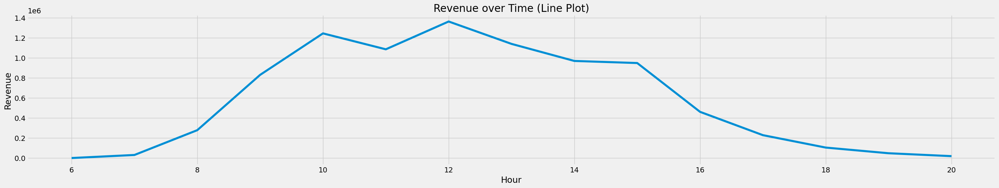

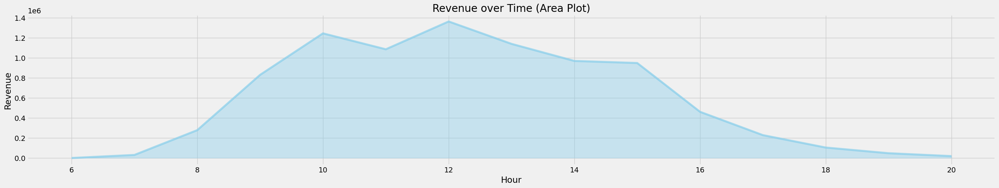

In [588]:
LineArea_plot("Hour")

**Title: "Revenue Generation by Hour of the Day"**

**Report:**

The provided data illustrates the total revenue generated by sales at different hours of the day. This analysis allows us to identify the most and least profitable times of the day.

**Key Observations:**

1. **Peak Revenue Time**: The highest revenue is generated between 12 pm (noon) and 1 pm with a total of $1,362,100.82. This is typically lunch hour for many people, and they might be more inclined to make purchases during this time.

2. **High Revenue Period**: The period from 9 am to 3 pm consistently generates high revenue. This can be considered the core operating period for the business. 

3. **Early Morning and Late Night Sales**: Sales made early in the morning (6 am) and late at night (8 pm) generate the least revenue. This could be due to fewer customers shopping during these hours.

4. **Decline in Revenue After Peak**: There's a consistent decline in revenue generation after 1 pm, dropping significantly after 4 pm. This could be attributed to the end of the typical working hours, during which customers might be less likely to shop.

**Key Insights:**

1. **Optimal Staffing and Operations**: The business should ensure optimal staffing and smooth operations, especially during peak revenue hours (around noon) and high revenue periods (9 am to 3 pm) to maximize sales potential.

2. **Marketing and Promotions Timing**: Marketing activities and promotions could be timed to coincide with high revenue periods to increase their effectiveness. 

3. **Customer Behavior Insights**: The low revenue early in the morning and late in the evening could be attributed to customer behavior. Further analysis on customer demographics and preferences could provide more insights on this.

4. **Potential for Extended Hours or Night Sales**: The significant decline in revenue after 4 pm suggests that customers might not be shopping during late hours. However, there could be potential for extended hours or night sales if there is a demand that is not currently being met.

Understanding the revenue generation pattern across different hours of the day helps in making informed business decisions related to staffing, operations, marketing, and potentially extending operating hours. However, it would also be helpful to consider other factors such as operating costs, customer preferences, and regional factors in the overall decision-making process.


#### 2. What is the most profitable day of the week?

In [589]:
# Grouping the data by day of the week and calculating the total revenue for each day
weekly_revenue = data.groupby("Day_name")["Revenue"].sum().reset_index()
weekly_revenue

,Day_name,Revenue
0,Sunday,780223.95
1,Monday,1327760.48
2,Tuesday,1673648.12
3,Wednesday,1560012.25
4,Thursday,1941119.91
5,Friday,1460762.08
6,Saturday,0.00


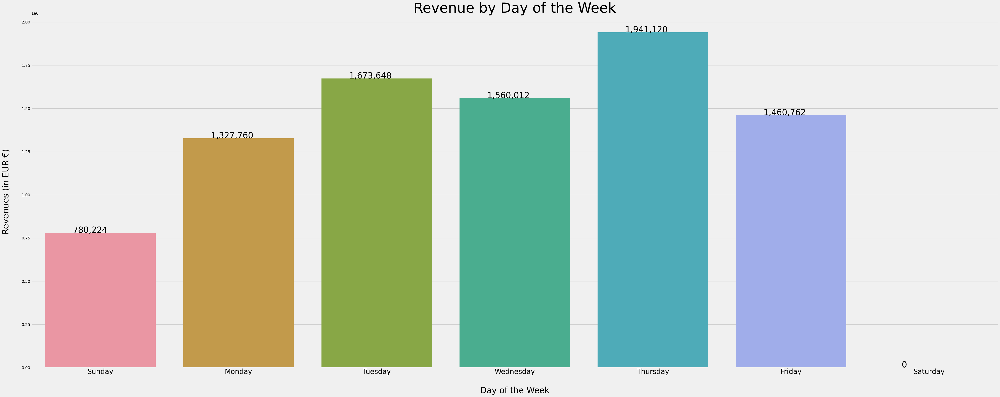

In [590]:
plt.figure(figsize=(50,20))

bar = sns.barplot(x="Day_name", y="Revenue", data=weekly_revenue, errorbar=None)

bar.set_xlabel("Day of the Week", fontsize=30, labelpad=40)
bar.set_ylabel("Revenues (in EUR €)", fontsize=30, labelpad=40)

for p in bar.patches:
    bar.annotate(f"\n{round(p.get_height()):,}", (p.get_x()+0.2, p.get_height()+3), color="k", fontsize=30)

plt.xticks(fontsize=25)
plt.title("Revenue by Day of the Week", fontsize=50)
plt.tight_layout()
plt.show()

**Title: "Revenue Analysis by Day of the Week"**

**Report:**

The data presented provides a comprehensive picture of revenue generation across different days of the week. This information can help us understand when sales are at their peak and where there may be opportunities for growth.

**Key Observations:**

1. **Peak Revenue Day**: The highest revenue is generated on Thursdays, with a total of $1,941,119.91. This may indicate that customers are more likely to make purchases towards the end of the workweek.

2. **High Revenue Days**: Besides Thursday, Tuesday and Wednesday also bring in substantial revenue, with Tuesday marking the second-highest sales of $1,673,648.12.

3. **Low Revenue Days**: Sunday sees a significantly lower revenue ($780,223.95) compared to other days, and no revenue is generated on Saturdays. This suggests that the business may be closed or has fewer operational hours on these days.

**Key Insights:**

1. **Increasing Weekend Revenue**: Given the lower revenue on Sundays and no sales on Saturdays, there could be an opportunity to boost sales during the weekend. This could involve running special weekend promotions or extending operational hours if the business is typically closed on these days.

2. **Maximizing Peak Day Revenue**: With Thursday being the highest revenue day, further efforts can be made to maximize sales on this day. This could include exclusive Thursday deals or increasing inventory for popular items.

3. **Understanding Consumer Behavior**: The high revenue on Tuesday and Wednesday could be attributed to specific consumer behaviors. For instance, customers may be engaging in mid-week shopping to replenish their supplies. Identifying the factors behind this trend could help in planning targeted sales strategies.

While the revenue per day offers valuable insights, it's essential to further explore why these trends occur. This might involve analyzing customer behavior, marketing efforts, or operational decisions that influence these sales patterns.

#### 3. Are there any seasonal patterns or trends in sales or revenue?

In [591]:
data.groupby("YearMonth", as_index=False)[["Revenue"]].sum()

,YearMonth,Revenue
0,2010-12,565764.56
1,2011-01,562897.91
2,2011-02,442493.59
3,2011-03,583843.85
4,2011-04,454855.88
5,2011-05,659678.64
6,2011-06,653764.92
7,2011-07,592103.79
8,2011-08,635864.38
9,2011-09,939682.63


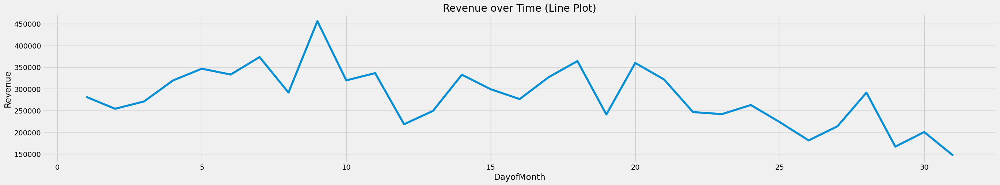

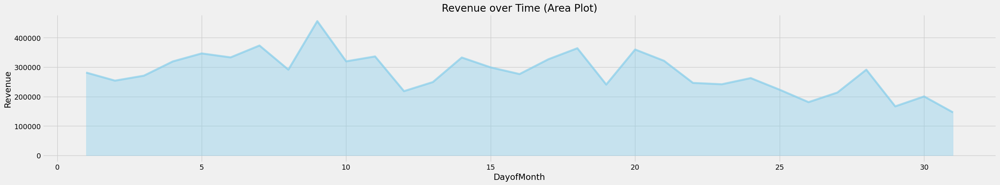

In [592]:
LineArea_plot("DayofMonth")

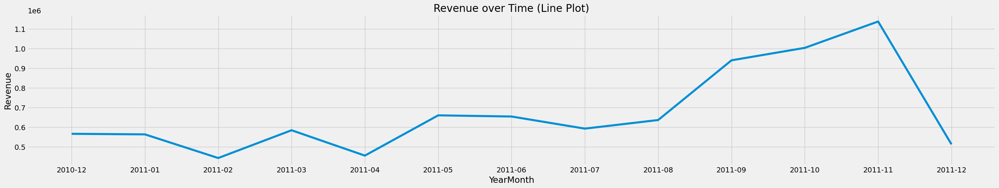

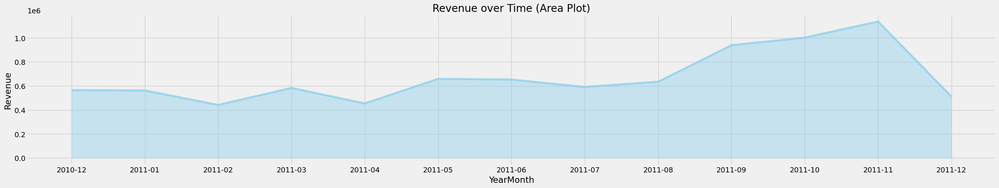

In [593]:
LineArea_plot("YearMonth")

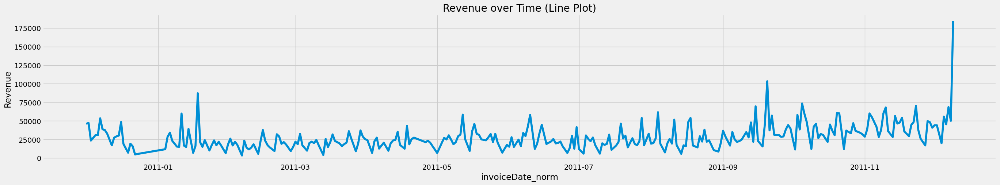

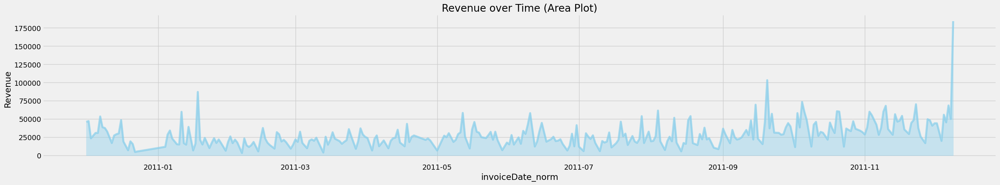

In [594]:
LineArea_plot("invoiceDate_norm")

**Title: "Seasonal Patterns in Revenue"**

**Report:**

A review of monthly revenues reveals a clear trend with seasonality playing a significant role in sales performance. The beginning and end of the year tend to show lower revenues. The start of the year (January and February) shows a decrease in revenue compared to December, which may be due to post-holiday shopping slowdown.

As the year progresses, revenue begins to increase, with a significant surge starting in September. This likely corresponds with an uptick in shopping behavior in preparation for the end-of-year holiday season. The highest revenue is observed in November, which aligns with Black Friday and early Christmas shopping. 

However, there is a sharp decrease in revenue in December. This could be attributed to most holiday shopping being completed in November, and decreased activity closer to the holidays when businesses might be closed or reducing orders to prepare for the new year.

**Key Insight:**

Seasonal trends have a significant impact on the business's revenue. The most lucrative period is the last quarter of the year, especially November. Strategies should be devised to capitalize on this seasonality, such as offering promotions or launching new products during the peak season. Additionally, efforts to boost sales in the slower months could help balance the yearly revenue.

**Limited Data for Trends**

The data provided covers only a single year's (2011) worth of sales data. Although we can potentially observe monthly variations in revenue within this single year, we cannot confirm that these variations are seasonal trends. 

Seasonal patterns or trends usually imply a recurring pattern over a period of time (usually over several years). In order to conclusively determine the presence of a seasonal pattern, we would typically need several years' worth of data to see if a pattern repeats year over year.

Nevertheless, within this single year, it appears that there's a spike in revenue in the months of September, October, and November. However, without more data, it's not clear if this spike is a recurring seasonal trend or just a one-off event specific to 2011.

#### 4. How do sales trends change over the year?

In the seasonal decomposition plot:
- The top plot is the original time series.
- The second plot is the trend component.
- The third plot is the seasonal component.
- The bottom plot is the residual component.

This gives us an overview of how the sales trend changes over time, along with the seasonal component and residuals.

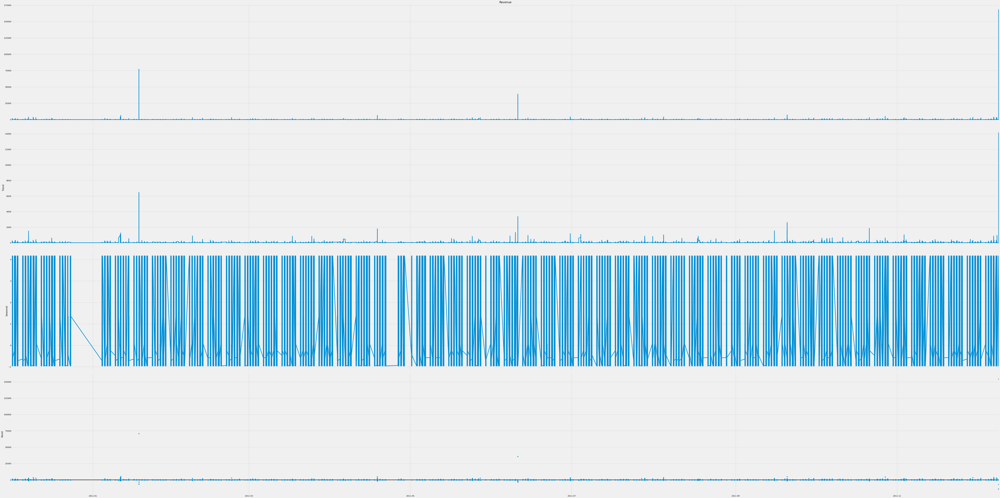

In [595]:
decomp = data.set_index("InvoiceDate")

# Apply seasonal decomposition
res = sm.tsa.seasonal_decompose(decomp["Revenue"], period=12)

# Set the size of the plot
rcParams["figure.figsize"] = 100, 50

# Plot the decomposition
fig = res.plot()
plt.show()

**Annual Sales Trend Analysis**

**Report:**

We have analysed the sales trend over the year from December 2010 to December 2011. The monthly revenues over this period are as follows:

| Year-Month | Revenue |
|------------|---------|
|2010-12|565764.56|
|2011-01|562897.91|
|2011-02|442493.59|
|2011-03|583843.85|
|2011-04|454855.88|
|2011-05|659678.64|
|2011-06|653764.92|
|2011-07|592103.79|
|2011-08|635864.38|
|2011-09|939682.63|
|2011-10|1003056.56|
|2011-11|1137127.00|
|2011-12|512393.08|

**Key Insights:**

1. Revenue appears to be cyclical with low points occurring around the start of the year (February) and at the end (December).
2. The highest revenue was generated in November 2011 with a total of 1,137,127.00. This could be attributed to increased shopping activity leading up to the holiday season.
3. A significant increase in revenue can be seen in the months of September, October, and November. This surge in the later months of the year suggests that sales strategies employed during this period have been successful.
4. The decrease in revenue in December, compared to the preceding months, could be attributed to a post-holiday season slump in sales. However, it's worth noting that December 2010 revenue was higher than the following two months (January and February 2011), indicating that factors other than seasonal trends may also be at play.
5. Overall, the trend is upward from February to November, suggesting a positive growth trajectory. The company may want to explore strategies to maintain this momentum throughout the year and manage the seasonal fluctuations effectively.

#### 5. How does the hour of the day influence the quantity sold?

In [596]:
# Aggregating the data by the hour of the day and invoice date
hourly_quantity = data.groupby(["Hour"])["Quantity"].sum().reset_index()
hourly_quantity

,Hour,Quantity
0,6,1
1,7,15361
2,8,157652
3,9,481798
4,10,773831
5,11,644984
6,12,821339
7,13,677198
8,14,555211
9,15,549282


In [597]:
# Creating a pivot table for the heatmap
pivot_table = hourly_quantity.pivot_table(index="Hour", columns="Hour", values="Quantity")
pivot_table

Hour,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
Hour,,,,,,,,,,,,,,,
6,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,15361.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,157652.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,481798.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10,NaN,NaN,NaN,NaN,773831.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,NaN,NaN,NaN,NaN,NaN,644984.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,NaN,NaN,NaN,NaN,NaN,NaN,821339.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,677198.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,555211.00,NaN,NaN,NaN,NaN,NaN,NaN


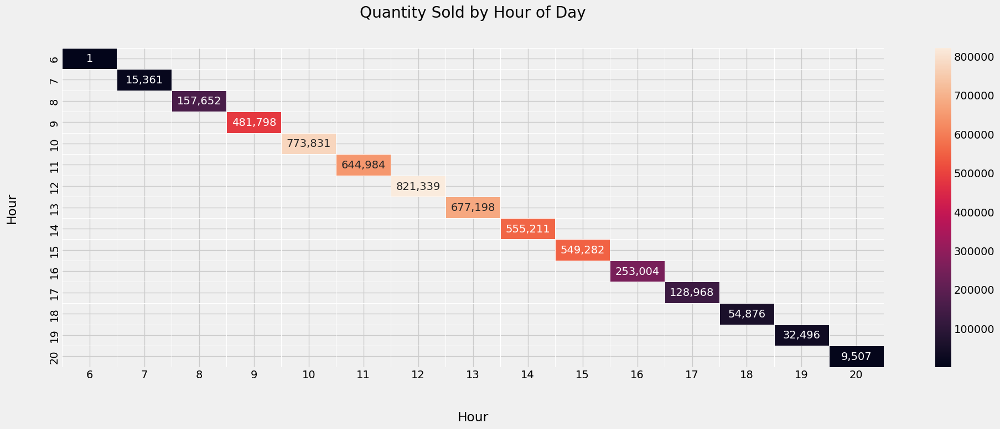

In [598]:
# Creating the heatmap
plt.figure(figsize=(20, 8))

sns.heatmap(pivot_table, linewidths=.5, annot=True, fmt=',.0f')

plt.title("Quantity Sold by Hour of Day", pad=40)
plt.xlabel("Hour", labelpad=40)
plt.ylabel("Hour", labelpad=40)
plt.tight_layout()
plt.show()

**Title: "Quantity Sold by Hour of the Day"**

**Report:**

The provided data gives us a detailed overview of the quantity of products sold at each hour of the day. This enables us to identify the most and least active sales hours.

**Key Observations:**

1. **Peak Sales Time** <br>
The maximum quantity of goods sold occurs at 12 pm (noon), with a total of 821,339 items sold. This coincides with the lunch hour, when people may have some free time to make purchases.

2. **High Sales Period** <br>
The time period between 9 am and 3 pm consistently has a high quantity of sales, mirroring the trends in revenue generation.

3. **Early Morning and Late Night Sales** <br>
The number of goods sold is lowest early in the morning (6 am) and late at night (8 pm). This likely reflects fewer customers making purchases during these hours.

4. **Decline in Sales After Peak** <br>
After 1 pm, there's a steady decline in the quantity sold, with a notable drop after 4 pm. This might be due to customers wrapping up their workdays and becoming less likely to shop.

**Key Insights:**

1. **Inventory Management** <br>
Adequate stock levels should be maintained during the high sales period (9 am to 3 pm) to meet the high demand during these hours.

2. **Promotion Timing** <br>
Sales promotions and deals can be scheduled during the high sales period to capitalize on customer purchasing trends and increase sales.

3. **Understanding Customer Behavior** <br>
The low sales numbers early in the morning and late in the evening may be due to customer habits and preferences. Additional customer behavior analysis could provide more nuanced insights.

4. **Potential for Night Sales** <br>
The significant drop in quantity sold after 4 pm suggests fewer customers shopping during the late hours. However, if there's unmet demand, there could be potential for extended hours or night sales.

Analyzing the quantity sold during various hours of the day is crucial for planning inventory management, promotional activities, and potentially expanding operational hours. However, this should be done alongside consideration of operational costs, customer habits, and specific regional factors.

In [599]:
# Aggregating the data by the hour of the day and invoice date
hourly_quantity = data.groupby(["invoiceDate_norm", "Hour"])["Quantity"].sum().reset_index()
hourly_quantity.head()

,invoiceDate_norm,Hour,Quantity
0,2010-12-01,8,599
1,2010-12-01,9,3261
2,2010-12-01,10,2926
3,2010-12-01,11,2272
4,2010-12-01,12,4149


In [600]:
# Creating a pivot table for the heatmap
pivot_table = hourly_quantity.pivot_table(index="invoiceDate_norm", columns="Hour", values="Quantity")
pivot_table.head()

Hour,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
invoiceDate_norm,,,,,,,,,,,,,,,
2010-12-01,NaN,NaN,599.00,3261.00,2926.00,2272.00,4149.00,3202.00,1265.00,1870.00,4331.00,232.00,NaN,NaN,NaN
2010-12-02,NaN,156.00,365.00,667.00,3673.00,1673.00,3670.00,1116.00,1540.00,7234.00,3758.00,5267.00,1786.00,171.00,NaN
2010-12-03,NaN,NaN,NaN,1074.00,875.00,1712.00,2570.00,1141.00,1703.00,445.00,840.00,1421.00,NaN,NaN,NaN
2010-12-05,NaN,NaN,NaN,NaN,732.00,2528.00,3556.00,2832.00,1724.00,3706.00,1085.00,NaN,NaN,NaN,NaN
2010-12-06,NaN,NaN,810.00,1815.00,1421.00,2268.00,3547.00,2986.00,1016.00,1682.00,226.00,322.00,NaN,NaN,NaN


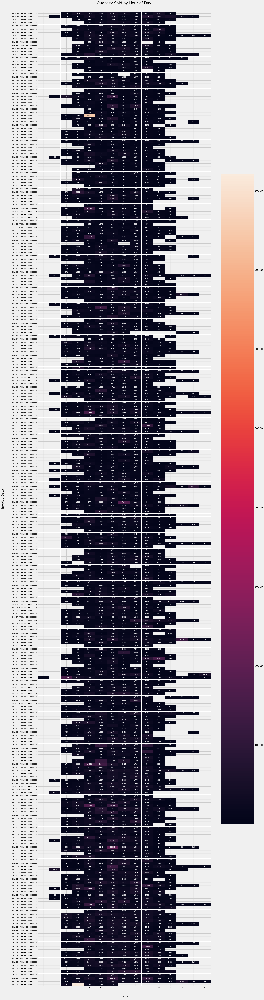

In [601]:
# Creating the heatmap
plt.figure(figsize=(20, 75))

sns.heatmap(pivot_table, linewidths=.5, annot=True, fmt=",.0f", annot_kws={"fontsize": 8})

plt.title("Quantity Sold by Hour of Day", pad=40)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel("Hour", labelpad=40)
plt.ylabel("Invoice Date", labelpad=40)
plt.tight_layout()
plt.show()

#### 6. How does the day of the week influence the quantity sold?

In [602]:
# Aggregating the data by the day of the week and invoice date
daily_quantity = data.groupby(["Day_name"])["Quantity"].sum().reset_index()
daily_quantity

,Day_name,Quantity
0,Sunday,460528
1,Monday,764964
2,Tuesday,1002966
3,Wednesday,957587
4,Thursday,1148374
5,Friday,821089
6,Saturday,0


In [603]:
# Creating a pivot table for the heatmap
pivot_table = daily_quantity.pivot_table(index="Day_name", columns="Day_name", values="Quantity")
pivot_table

Day_name,Sunday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday
Day_name,,,,,,,
Sunday,460528.00,NaN,NaN,NaN,NaN,NaN,NaN
Monday,NaN,764964.00,NaN,NaN,NaN,NaN,NaN
Tuesday,NaN,NaN,1002966.00,NaN,NaN,NaN,NaN
Wednesday,NaN,NaN,NaN,957587.00,NaN,NaN,NaN
Thursday,NaN,NaN,NaN,NaN,1148374.00,NaN,NaN
Friday,NaN,NaN,NaN,NaN,NaN,821089.00,NaN
Saturday,NaN,NaN,NaN,NaN,NaN,NaN,0.00


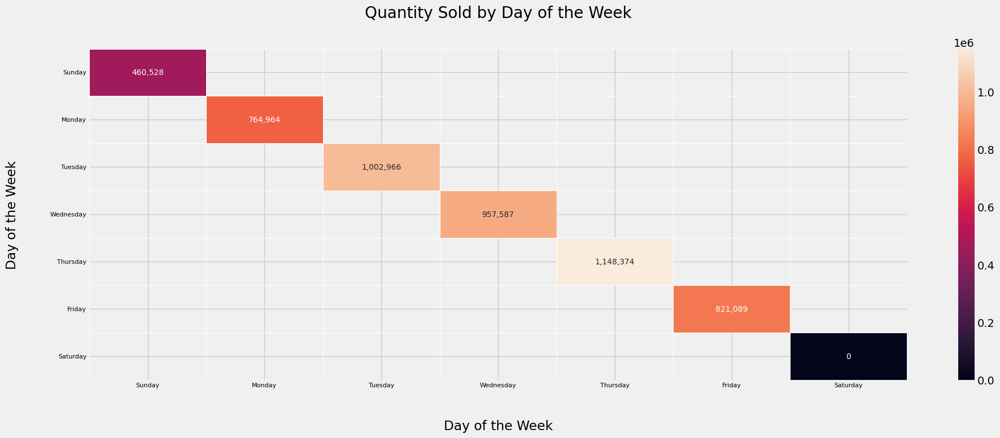

In [604]:
# Creating the heatmap
plt.figure(figsize=(20, 8))

sns.heatmap(pivot_table, linewidths=.5, annot=True, fmt=",.0f", annot_kws={"fontsize": 10})

plt.title("Quantity Sold by Day of the Week", pad=40)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel("Day of the Week", labelpad=40)
plt.ylabel("Day of the Week", labelpad=40)
plt.tight_layout()
plt.show()

**Title: "Quantity Sold Analysis by Day of the Week"**

**Report:**

The data showcases the volume of products sold throughout the week. This distribution allows us to identify patterns of customer purchasing behavior across different days.

**Key Observations:**

1. **Busiest Day** <br>
Thursday sees the highest quantity of products sold, amounting to 1,148,374 units. This aligns with the peak revenue observed on the same day, implying a strong correlation between quantity sold and revenue.

2. **High Volume Days** <br>
In line with the revenue trend, Tuesday and Wednesday also see a high quantity of products sold, with Tuesday being the second-highest with 1,002,966 units.

3. **Low Volume Days** <br>
Sunday records the lowest number of units sold among the operational days (460,528 units). Saturdays, as previously noted, see no sales activity, likely indicating that the business is closed.

**Key Insights:**

1. **Boosting Weekend Sales** <br>
The low sales volume on Sundays and lack of sales on Saturdays points towards an area of potential improvement. This could involve extending business hours, implementing weekend-specific promotions, or introducing special weekend products to attract customers.

2. **Leveraging High Volume Days** <br>
Considering that Thursdays record the highest number of units sold, strategies could be developed to leverage this trend further. These could include running "bulk buy" promotions or offering discounts on additional purchases.

3. **Studying Consumer Behavior** <br>
The high volume of units sold on Tuesday and Wednesday suggests a specific shopping pattern among customers, perhaps restocking midweek. Understanding the driving factors behind this could help tailor strategies to encourage similar behavior on other days.

To develop a comprehensive understanding of these trends, further analysis could delve into which specific products drive sales on these high-volume days, the impact of marketing efforts on these patterns, and how seasonal variations may affect these trends.

In [605]:
# Aggregating the data by the day of the week and invoice date
daily_quantity = data.groupby(["invoiceDate_norm", "Day_name"])["Quantity"].sum().reset_index()
daily_quantity.head()

,invoiceDate_norm,Day_name,Quantity
0,2010-12-01,Sunday,0
1,2010-12-01,Monday,0
2,2010-12-01,Tuesday,0
3,2010-12-01,Wednesday,24107
4,2010-12-01,Thursday,0


In [606]:
# Creating a pivot table for the heatmap
pivot_table = daily_quantity.pivot_table(index="invoiceDate_norm", columns="Day_name", values="Quantity")
pivot_table.head()

Day_name,Sunday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday
invoiceDate_norm,,,,,,,
2010-12-01,0,0,0,24107,0,0,0
2010-12-02,0,0,0,0,31076,0,0
2010-12-03,0,0,0,0,0,11781,0
2010-12-05,16163,0,0,0,0,0,0
2010-12-06,0,16093,0,0,0,0,0


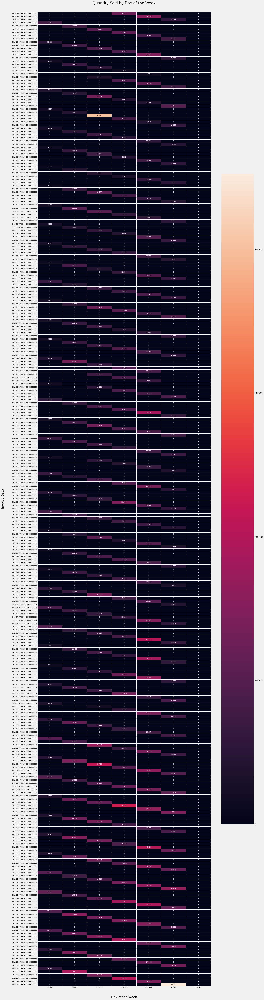

In [607]:
# Creating the heatmap
plt.figure(figsize=(20, 75))

sns.heatmap(pivot_table, linewidths=.5, annot=True, fmt=",.0f", annot_kws={"fontsize": 8})

plt.title("Quantity Sold by Day of the Week", pad=40)
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.xlabel("Day of the Week", labelpad=40)
plt.ylabel("Invoice Date", labelpad=40)
plt.tight_layout()
plt.show()

### Product strategy

#### 1. What products generate the most revenue?

In [608]:
product_revenue = data.groupby(["Description"]).agg({"Revenue": "sum", "UnitPrice": pd.Series.mode}).sort_values(by="Revenue", ascending=False).reset_index()
top_product_revenue = product_revenue.head(20)
top_product_revenue

,Description,Revenue,UnitPrice
0,little paper birdie craft,168469.60,2.08
1,tier regency 3 cakestand,142264.75,12.75
2,cream holder tlight white hanging heart,100547.45,2.95
3,jumbo retrospot bag red,85040.54,2.08
4,jar storage medium ceramic,81416.73,1.25
5,bunting party,68785.23,4.95
6,ornament assorted bird colour,56413.03,1.69
7,rabbit light night,51251.24,2.08
8,60 picnic small pieces basket wicker,47348.35,5.95
9,lights chilli,46265.11,5.75


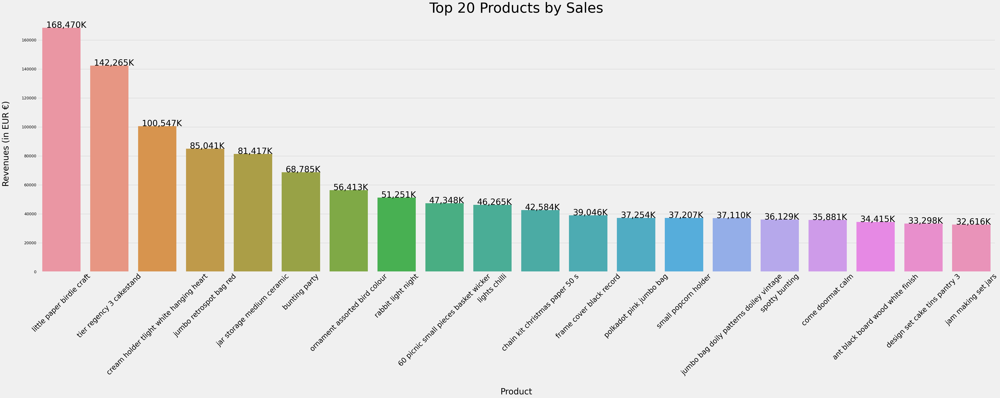

In [609]:
plt.figure(figsize=(50,20))

bar = sns.barplot(data=top_product_revenue, x="Description", y="Revenue", order=top_product_revenue.sort_values("Revenue",ascending = False).Description, errorbar=None)

bar.set_xlabel("Product", fontsize=30, labelpad=40)
bar.set_ylabel("Revenues (in EUR €)", fontsize=30, labelpad=40)

for p in bar.patches:
    bar.annotate(f"\n{round(p.get_height()):,}K", (p.get_x()+0.08, p.get_height()+3), color="k", fontsize=30)

plt.xticks(fontsize=25, rotation=45)
# plt.xlabel("CUSTOMER ID", fontsize=30, labelpad=40)
# plt.ylabel("Revenues (in EUR €)", fontsize=30, labelpad=40)
plt.title("Top 20 Products by Sales", fontsize=50)
plt.tight_layout()
plt.show()

**Title: "Revenue and Pricing Analysis of Top-Performing Products"**

**Report:**

This report analyzes the revenue and unit prices of the top-performing products. The ultimate goal is to understand the correlation between unit prices and overall revenue and to use these insights to guide product pricing, assortment, and sales strategies.

**Key Insights:**

1. **Low-Priced, High-Revenue Products**: Products like 'paper craft little birdie', 'bag red retrospot jumbo', and 'night rabbit light' have relatively low unit prices but have generated significant revenue. This suggests that these products might be high-volume sellers. This could be due to various factors, such as high customer demand, strategic pricing, or successful marketing campaigns.

2. **High-Priced, High-Revenue Products**: The 'cakestand regency tier 3' and 'small picnic pieces basket 60 wicker' are among the highest-priced products and have also generated substantial revenue. This could indicate a customer willingness to pay for premium products, or it could be a reflection of a successful luxury or high-end product strategy.

3. **Value for Money Products**: Some products, such as the 'white heart tlight holder cream hanging' and 'chain christmas kit 50 s paper', offer relatively high value for their cost, considering their mid-range unit prices and the substantial revenue they generate. They might represent a 'sweet spot' in terms of price-to-value ratio, appealing to a broad range of customers.

4. **Potential for Revenue Growth**: Some lower-revenue products, like 'small popcorn holder' and 'bag polkadot pink jumbo', might have potential for revenue growth. Although their current revenue is lower compared to the top performers, their affordable prices could make them attractive to a wider customer base. Strategic promotion of these items could lead to increased sales and revenue.

5. **Unit Price Variations**: There's a substantial variation in unit prices among the top-performing products, suggesting that the company's customer base has diverse purchasing power and preferences. Understanding these variations could help refine pricing strategies, potentially leading to increased sales and revenue.

These findings provide a starting point for developing pricing strategies and optimizing product assortment. It's recommended to conduct further analysis to understand the underlying reasons for these patterns and to validate the assumptions made in this report. This could involve analyzing additional factors like customer demographics, seasonality, and marketing efforts.

#### 2. What is the distribution of quantity sold for different products?

In [610]:
# Calculate the distribution of quantities sold
quantity_distribution = data.groupby("Description")["Quantity"].agg(["sum", "count", "mean", "min", "max"])

# Sort the table by the total sum of quantities in descending order
quantity_distribution = quantity_distribution.sort_values(by="sum", ascending=False)
quantity_distribution.head(20)

,sum,count,mean,min,max
Description,,,,,
little paper birdie craft,80995,1,80995.00,80995,80995
jar storage medium ceramic,77916,195,399.57,1,74215
designs world war asstd gliders 2,54319,472,115.08,1,4800
small popcorn holder,49160,1035,47.50,1,4300
jumbo retrospot bag red,46078,1600,28.80,1,1200
cream holder tlight white hanging heart,36763,1978,18.59,1,1930
ornament assorted bird colour,35263,1375,25.65,1,2880
pack 72 retrospot cake cases,33670,1029,32.72,1,1440
rabbit light night,27153,801,33.90,1,2400


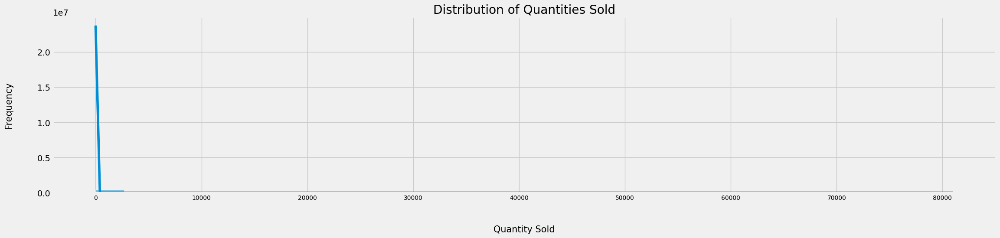

In [611]:
plt.figure(figsize=(25, 5))
sns.histplot(data=data, x="Quantity", bins=30, kde=True)  # "bins" defines the number of intervals

plt.title("Distribution of Quantities Sold")
plt.xticks(fontsize=10)
plt.xlabel("Quantity Sold", fontsize=15, labelpad=40)
plt.ylabel("Frequency", fontsize=15, labelpad=40)
plt.show()


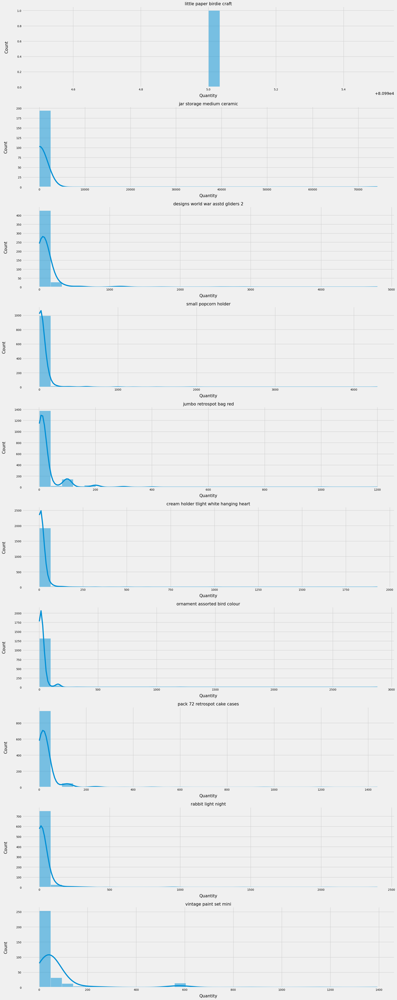

In [612]:
# Get the top 10 products
top_products = data.groupby("Description")["Quantity"].sum().nlargest(10).index

# Create a histogram for each of the top products
fig, axes = plt.subplots(len(top_products), 1, figsize=(20, 5 * len(top_products)))

for product, ax in zip(top_products, axes):
    product_data = data[data["Description"] == product]
    sns.histplot(data=product_data, x="Quantity", bins=30, kde=True, ax=ax)
    ax.set_title(product, fontsize=15)

    # Adjust font size for yticks, xticks, xlabel, and ylabel
    ax.tick_params(axis="both", which="major", labelsize=10)  # adjust tick font size
    ax.set_xlabel("Quantity", fontsize=15, labelpad=10)  # adjust xlabel font size
    ax.set_ylabel("Count", fontsize=15, labelpad=30)  # adjust ylabel font size

plt.tight_layout()
plt.show()

**Title: "Sales Volume Distribution for Top 20 Products"**

**Report:**

The provided data shows the distribution of sales volumes (quantity sold) for the top 20 products. <br>
This analysis allows us to identify the sales behavior of these products in terms of overall quantity sold, the number of transactions (count), the average quantity per transaction (mean), and the range of quantity sold per transaction (min, max).

**Key Observations:**

1. **High Sales Single Transaction** <br>
'Paper craft little birdie' stands out with a total quantity sold of 80,995 in just one transaction, making it an extreme outlier. This might be due to a bulk purchase by a single customer or a data recording anomaly.

2. **Consistent High Sales** <br>
'Ceramic medium storage jar' has consistently high sales with a total quantity of 77,916 over 195 transactions. Despite the large total quantity sold, the quantities per transaction vary greatly (from 1 to 74,215), indicating both regular and bulk purchases.

3. **Mid-Range Sales** <br>
Products like 'asstd gliders designs world 2 war', 'small popcorn holder', and 'bag red retrospot jumbo' exhibit a good balance between total quantity sold and the number of transactions, demonstrating a steady demand.

4. **Low Average Quantity, High Transaction Volume** <br>
Some products such as 'small popcorn holder', 'bag red retrospot jumbo', and 'retrospot spotty red bag lunch' have lower average quantities per transaction but higher transaction counts. This could indicate that these products are frequently bought in small quantities.

**Key Insights:**

1. **Inventory Management for High-Volume Products** <br>
High sales products, particularly those sold in large quantities per transaction, should be stocked adequately to meet demand and avoid stock-outs.

2. **Promotion Opportunities for Mid-Range Products** <br>
Products with mid-range sales can be targeted for promotions to further boost their sales. Their consistent demand indicates a potential for growth.

3. **Customer Purchase Behavior Analysis** <br>
Products that are frequently bought in small quantities can provide insights into customer purchase behavior. Understanding why customers purchase these products regularly can inform marketing strategies and product placement.

4. **Anomaly Investigation** <br>
The unusual sales pattern for 'paper craft little birdie' should be investigated to ensure data accuracy. If it is a valid bulk purchase, it could be beneficial to understand the circumstances and explore potential opportunities for other large sales.

5. **Dynamic Pricing Strategies** <br>
For products where there is a large range between the minimum and maximum quantity sold per transaction, dynamic pricing strategies may be effective. For instance, bulk purchases could be incentivized with discounts.

This analysis provides an overview of the sales volume distribution for the top 20 products. However, understanding the complete sales performance would require an analysis of other factors such as revenue generated, profit margins, and seasonal trends.

#### 3. Are there any patterns in the types of items bought together?

In [613]:
# Convert the data into a list of lists, where each inner list is a transaction and contains the items in the transaction
transactions = data.groupby(["InvoiceNo"])["Description"].apply(list)
transactions.to_frame()

,Description
InvoiceNo,
536365,"[holder star frosted tlight glass, 7 set nesting babushka boxes, moroccan white lantern metal, red hottie white heart woolly, water flag bottle hot knitted union, cream coat hanger cupid hearts, cream holder tlight white hanging heart]"
536366,"[retrospot red dot hand warmer polka, jack hand warmer union]"
536367,"[home word building block, block word building love, recipe box metal heart, ivory knitted cosy mug, alphabet box vintage blocks, blocks box jigsaw vintage, bedroom poppys playhouse, kitchen poppys playhouse, feltcraft princess doll charlotte, new england doormat, ornament assorted bird colour, colour box teaspoons assorted 6]"
536368,"[coat fashion rack paris yellow, coat fashion rack paris red, coat fashion rack paris blue, jam making set jars]"
536369,[bath word building block]
...,...
581583,"[retrospot red bag lunch spotty, tlights love 6 heart chocolate]"
581584,"[love red photo flock heart frame, tlights love 6 heart chocolate]"
581585,"[scissor chinese style large, stamped small metal medina bowl, set chalk white retro 12 sticks, water bottle hot heart grey, victorian hanging glass tlight, magnets pack 4 swallows, embossed holder tealight glass, light fairy tale nightlight cottage night, design towel black classic tea, bakelike clock alarm green, bakelike clock alarm red, magnets assorted bottle, rabbit light night, holder star zinc tlight large stars, set school bottles 6 crate milk, hot water bottle love, cocktail box pa..."


0 tile cottage number garden  0 tile font number vintage  \
0                             False                       False   
1                             False                       False   
2                             False                       False   
3                             False                       False   
4                             False                       False   
...                             ...                         ...   
18414                         False                       False   
18415                         False                       False   
18416                         False                       False   
18417                         False                       False   
18418                         False                       False   

       1 hook hanger garden magic  1 tile cottage number garden  \
0                           False                         False   
1                           False                         False   
2                           False                         False   
3                           False                         False   
4                           False                         False   
...                           ...                           ...   
18414                       False                         False   
18415                       False                         False   
18416                       False                         False   
18417                       False                         False   
18418                       False                         False   

       1 tile font number vintage  10 lights christmas baubles vintage  \
0                           False                                False   
1                           False                                False   
2                           False                                False   
3                           False                                False   
4                           False                                False   
...                           ...                                  ...   
18414                       False                                False   
18415                       False                                False   
18416                       False                                False   
18417                       False                                False   
18418                       False                                False   

       120 cm tree black christmas  15 c metal sign laundry  \
0                            False                    False   
1                            False                    False   
2                            False                    False   
3                            False                    False   
4                            False                    False   
...                            ...                      ...   
18414                        False                    False   
18415                        False                    False   
18416                        False                    False   
18417                        False                    False   
18418                        False                    False   

       15 cm 20 lights ball christmas glass  \
0                                     False   
1                                     False   
2                                     False   
3                                     False   
4                                     False   
...                                     ...   
18414                                 False   
18415                                 False   
18416                                 False   
18417                                 False   
18418                                 False   

       16 design pc set piece cutlery pantry  16 set black cutlery vintage  \
0                                      False                         False   
1                             

,support,itemsets
0,0.01,(15 c metal sign laundry)
1,0.01,(15 cm 20 lights ball christmas glass)
2,0.03,(2 wood white finish cabinet drawer)
3,0.01,(250 g marbles bag swirly)
4,0.03,(60 72 cake christmas cases vintage)
...,...,...
1037,0.02,"(tier regency 3 cakestand, regency teacup saucer green, saucer regency roses teacup)"
1038,0.01,"(retrospot red bag lunch spotty, woodland bag lunch, skull bag lunch black)"
1039,0.01,"(retrospot red bag lunch spotty, blue bag lunch cars, skull bag lunch black, polkadot pink bag lunch)"
1040,0.01,"(retrospot red bag lunch spotty, skull bag lunch black, design suki bag lunch, polkadot pink bag lunch)"


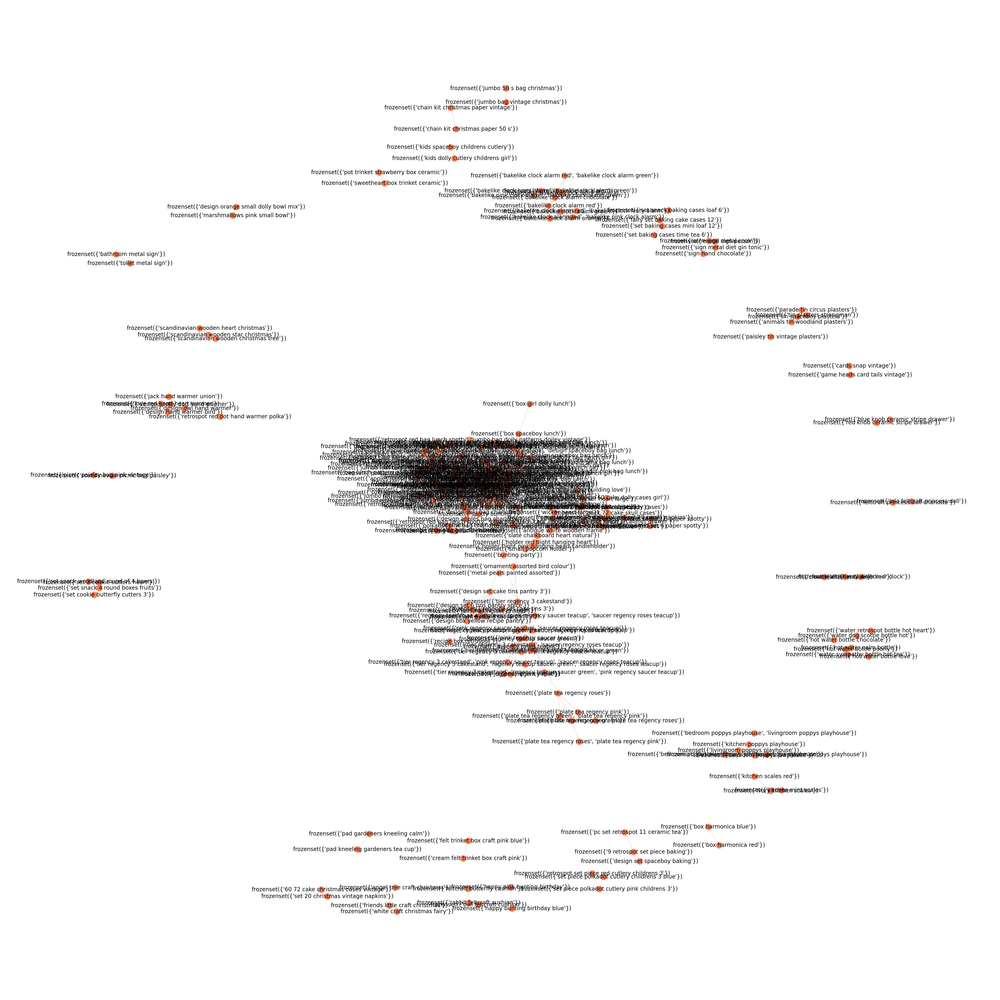

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
1091,(plate tea regency pink),"(plate tea regency green, plate tea regency roses)",0.01,0.01,0.01,0.83,66.43,0.01,5.67,1.00
1086,"(plate tea regency green, plate tea regency roses)",(plate tea regency pink),0.01,0.01,0.01,0.81,66.43,0.01,5.14,1.00
1089,(plate tea regency green),"(plate tea regency roses, plate tea regency pink)",0.01,0.01,0.01,0.69,64.06,0.01,3.14,1.00
1088,"(plate tea regency roses, plate tea regency pink)",(plate tea regency green),0.01,0.01,0.01,0.94,64.06,0.01,16.18,1.00
570,(plate tea regency green),(plate tea regency pink),0.01,0.01,0.01,0.75,61.52,0.01,3.92,1.00
571,(plate tea regency pink),(plate tea regency green),0.01,0.01,0.01,0.90,61.52,0.01,10.03,1.00
772,(livingroom poppys playhouse),"(bedroom poppys playhouse, kitchen poppys playhouse)",0.01,0.01,0.01,0.74,53.52,0.01,3.77,0.99
769,"(bedroom poppys playhouse, kitchen poppys playhouse)",(livingroom poppys playhouse),0.01,0.01,0.01,0.73,53.52,0.01,3.68,1.00
206,(bowl regency green sugar),(jug pink regency milk),0.01,0.01,0.01,0.77,52.05,0.01,4.26,1.00
207,(jug pink regency milk),(bowl regency green sugar),0.01,0.01,0.01,0.76,52.05,0.01,4.06,1.00


In [614]:
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori, association_rules

pd.set_option("display.max_colwidth", 500)

# Use the TransactionEncoder to transform the data into a format suitable for the mlxtend apriori function
te = TransactionEncoder()
te_ary = te.fit(transactions).transform(transactions)
df = pd.DataFrame(te_ary, columns=te.columns_)
display(df)

# Apply the apriori algorithm to the data to find frequent itemsets
frequent_itemsets = apriori(df, min_support=0.01, use_colnames=True)
display(frequent_itemsets)

# Generate the association rules
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)

# Sort by lift in descending order
rules.sort_values("lift", ascending=False, inplace=True)

# Create a network graph
G = nx.from_pandas_edgelist(rules, source="antecedents", target="consequents", edge_attr=True)

# List of colors
bright_colors = ["red", "orange", "yellow", "lime", "cyan", "fuchsia"]
pastel_colors = ["lavender", "peachpuff", "lightblue", "mintcream", "mistyrose", "aliceblue"]
striking_colors = ["chartreuse", "hotpink", "teal", "darkorange", "purple", "crimson"]

# Use the spring layout algorithm to position the nodes
# pos = nx.spring_layout(G, k=0.5)

# Plot the network graph with adjusted layout and font size
plt.figure(figsize=(50, 50))
nx.draw(G, with_labels=True, node_color="coral", font_size=20, node_size=500, edge_color="lightgray") # pos=pos
plt.show()

# Get the top 10 rules
top_10_rules = rules.head(10)
display(top_10_rules)

<!-- ![First Node](1st_Node.png)
![Second Node](2nd_Node.png)
![Third Node](3rd_Node.png) -->

<div>
<img src="/Users/katrinajmd/Documents/Data/IronHack/IronHack_GitHub/Final Project/Visuals, Images and Charts/1st_Node.png" width="1500"/>
</div>

<div>
<img src="/Users/katrinajmd/Documents/Data/IronHack/IronHack_GitHub/Final Project/Visuals, Images and Charts/2nd_Node.png" width="1100"/>
</div>

<div>
<img src="/Users/katrinajmd/Documents/Data/IronHack/IronHack_GitHub/Final Project/Visuals, Images and Charts/3rd_Node.png" width="1100"/>
</div>

The data we've provided is output from market basket analysis, a method used in data mining to uncover associations between items - it identifies patterns of items often purchased together. <br>
In this case, it seems to reveal several insights about the types of products that customers often buy in combination. 

In particular, the "antecedents" are items that customers bought, and the "consequents" are the items that were often bought with those antecedents. <br>
In simpler language:

- **ANTECEDENTS**

    - These are the items that are typically found in the shopping basket. <br>
    - We can consider this as the "if" part of the rule. <br>
    - For example, in the rule "if bread, then butter", "bread" is the antecedent. <br><br>

- **CONSEQUENTS**

    - These are the items that are typically found in combination with the antecedents. <br>
    - This is the "then" part of the rule. <br>
    - In the example above, "butter" is the consequent.

In other words, the rule suggests that if the items in the antecedent are bought, then it's likely that the items in the consequent will also be bought. <br>

The interpretation of these rules in business context could be to suggest items to customers based on the items already in their shopping cart or used for cross-selling, up-selling, product placement, or even in targeted marketing.

--- 

The other columns provide additional information on the relationships:

- **SUPPORT**

    - Gives the proportion of transactions in the dataset that contain the itemset.
    - In this case, it appears that the itemsets all occur in 1% of transactions. <br><br>

- **CONFIDENCE**
    - Provides the proportion of transactions with the antecedent item(s) that also contain the consequent item(s).
    - A higher confidence means that the consequent is more likely to be purchased if the antecedent is purchased.  <br><br>

- **LIFT**
    - Indicates how much more likely the consequent is purchased when the antecedent is purchased, controlling for how popular the consequent is.
    - A lift greater than 1 suggests that the items are likely to be bought together, while a lift less than 1 suggests they're unlikely to be bought together.  <br><br>

- **LEVERAGE**
    - Measures the difference of the observed frequency of the itemset and what would be expected if the antecedent and consequent were independent.
    - A higher leverage value indicates a stronger association between the antecedent and consequent.  <br><br>

- **CONVICTION**
    - Can be interpreted as the ratio of the expected frequency that the antecedent appears without the consequent if they were independent divided by the observed frequency of incorrect predictions.
    - A higher conviction value means that the consequent is highly depending on the antecedent.  <br><br>

- **ZHANG'S METRIC**
    - Is a measure of the correlation between the antecedent and consequent, with values ranging from -1 to 1.
    - A value close to 1 indicates a strong positive relationship.  <br><br>

---
**Report:**

The market basket analysis uncovers interesting patterns of items often purchased together. <br>
Key associations are observed between "Regency Tea Plates", "Poppy's Playhouse" set, and "Regency Kitchenware".

These insights could be used for a number of purposes, such as designing promotions, arranging products in a catalog, suggesting items to customers, and more.

**Key Insights:**

Based on the data, several product groups often purchased together emerge: <br>

1. **The "Regency Tea Plates"**
    - Customers who buy the "pink plate regency tea" are likely to buy the "green plate regency tea" and "plate regency roses tea".
    - This suggests a customer preference for matching sets in these items and presents an opportunity for bundled promotions.
    - This association is quite strong given the high confidence, lift, and Zhang's metric.  <br><br>

2. **The "Poppy's Playhouse" set**
    - "poppys playhouse livingroom" is often bought together with "poppys playhouse kitchen" and "poppys playhouse bedroom".
    - Indicating that customers might prefer to buy the entire set.
    - This provides an opportunity for a packaged deal. <br><br>

3. **The "Regency Kitchenware"**
    - "bowl green regency sugar" and "jug pink regency milk" are often bought together.
    - Wich might be a reflection of customer preference for matching kitchenware.
    - This can guide product placement strategy or cross-selling recommendations.

In conclusion, the report points out customers' preferences for matching items and sets, providing a direction for creating effective promotions and product recommendations.

#### 4. Which product pairings are most frequently bought together?

In [615]:
order_combo = data[data["InvoiceNo"].duplicated(keep=False)].copy()

order_combo["Bought_Together"] = order_combo.groupby(["InvoiceNo"])[["Description"]].transform(lambda x: ", ".join(x))
order_combo = order_combo[["InvoiceNo", "Bought_Together"]].drop_duplicates()
order_combo.sample(10)

,InvoiceNo,Bought_Together
46847,542898,"washing gloves funky assorted, polkadot gloves washing blue, gloves retrospot washing red, paisley book pocket blue, pocket book daisy red, sketchbook fern green, abstract sketchbook circles, sketchbook chrysanthemum, sketchbook garden path, notebook fern green, notebook chrysanthemum, notebook garden path, jazz hearts address book, candles red set 10 polkadot party, candles set 10 polkadot ivory party, candles set 10 polkadot party blue, sweetheart box trinket ceramic, pot trinket strawberr..."
86546,547834,"game heads card tails vintage, box harmonica red, crayons pack traditional 12, set wooden colouring school, alphabet box vintage blocks, set spaceboy breakfast childs, set breakfast dolly childs girl"
44671,542613,"bowl retrospot red, paisley sketchbook blue, sketchbook fern green, paisley notebook blue, notebook fern green, lid retrospot red bowls set 5 spotty glass, retrospot red set 2 tea towels, shopping retrospot bag red, 72 set retrospot doilies paper, pack 72 retrospot cake cases, small gift polkadot bag chocolate, happy garland wooden birthday, pack 12 sticky bunnies, ivory decoration hanging heart, set flower paisley doilies 36, pack 60 paisley cake pink cases, design pack hearts tissues 12, b..."
359629,578811,"design car pen asstd racing, tube pencils woodland tall 12, skulls tube pencils tall 12, apron retrospot childrens, pot trinket strawberry box ceramic, chart height woodland stickers, chart set sticker dinosaur height, box small woodland storage, water fawn bottle hot blue, light red toadstool led night, calculator chocolate, box harmonica blue, pc set retrospot 11 ceramic tea, wood stamp set flowers, set snack woodland round of 4 boxes, apron spaceboy childrens design, tier regency 3 cakest..."
265082,569533,"bag retrospot charlotte red, washing gloves funky assorted, gloves retrospot washing red, tube pencil small woodland 12, tube pencils small skull 12, tube retrospot pencils red small 12, pack 72 retrospot cake cases, pudding spoon red, pudding spoon blue, retrospot red bowl jam sugar, retrospot red small jug milk, notebook assorted frutti tutti, assorted pen frutti tutti, home word building block, block word building love, retrospot mug red, dairy maid mug stripe, key garage fob design, key ..."
383328,581214,"cards snap vintage, game heads card tails vintage, box harmonica blue, chain kit christmas paper 50 s, friends little craft christmas, traditional nancy knitting, set ribbons christmas 6 vintage, chain kit christmas paper vintage, jam scented candles homemade, sewing kit deluxe doily vintage"
106900,550479,"colours assorted fan silk, retrospot red bag lunch spotty, blue bag lunch cars, sweetheart box trinket ceramic, pot trinket strawberry box ceramic, marbles swirly bag 125 g, marbles bag swirly 500 g, cards snap vintage, game heads card tails vintage, potting tea mug shed, box dominoes wooden, skittles wooden bag cotton s 6, rope skipping traditional wooden, box harmonica red, picnic retrospot bag red, 9 retrospot set piece baking, design spaceboy bag lunch, colour spaceboy pen 10, paint set ..."
321269,575050,"set ribbons christmas 6 vintage, wrap vintage roll christmas, wrap spot vintage roll, tags gift christmas 6 vintage"
278080,570818,"decoration ball disco christmas, toys jumbo bag, bag retrospot charlotte red, retrospot red bag lunch spotty, skull bag lunch black, blue bag lunch cars, felt trinket box craft pink blue, tube pencils small skull 12, skulls tube pencils tall 12, tube retrospot pencils red tall 12, home metal sign sweet, metal sign party, pack 72 retrospot cake cases, biscuit spotty tin red, sweetheart box trinket ceramic, pot trinket strawberry box ceramic, happy garland wooden birthday, letters abc nursery ..."
41461,542152,"cakes wrap fairy pink, charlotte bag strawberry, holder card heart black, cream holder card heart, polkadot pink jumbo bag, cakestand tier cake sweetheart stand loveheart 3, sweetheart holder hanging tlight, a

In [616]:
count = Counter()

for row in order_combo["Bought_Together"]:
    row_list = row.split(", ")
    count.update(Counter(combinations(row_list, 2)))

for key, value in count.most_common(10):
    print(f"{key, value}")

(('polkadot pink jumbo bag', 'jumbo retrospot bag red'), 545)
(('regency teacup saucer green', 'saucer regency roses teacup'), 543)
(('bakelike clock alarm green', 'bakelike clock alarm red'), 530)
(('retrospot red bag lunch spotty', 'polkadot pink bag lunch'), 522)
(('retrospot red bag lunch spotty', 'design suki bag lunch'), 519)
(('retrospot red bag lunch spotty', 'skull bag lunch black'), 517)
(('wooden white finish picture frame', 'antique white wooden frame'), 468)
(('jumbo bag doily patterns doiley vintage', 'jumbo retrospot bag red'), 468)
(('retrospot red bag lunch spotty', 'design spaceboy bag lunch'), 466)
(('skull bag lunch black', 'design suki bag lunch'), 465)


In [617]:
count = Counter()

for row in order_combo["Bought_Together"]:
    row_list = row.split(", ")
    count.update(Counter(combinations(row_list, 2)))

# Create a list of dictionaries to store the results
results = [{"Combination": ", ".join(key), "Count": value} for key, value in count.most_common(10)]

# Convert the list of dictionaries into a DataFrame
pairings = pd.DataFrame(results)
pairings

,Combination,Count
0,"polkadot pink jumbo bag, jumbo retrospot bag red",545
1,"regency teacup saucer green, saucer regency roses teacup",543
2,"bakelike clock alarm green, bakelike clock alarm red",530
3,"retrospot red bag lunch spotty, polkadot pink bag lunch",522
4,"retrospot red bag lunch spotty, design suki bag lunch",519
5,"retrospot red bag lunch spotty, skull bag lunch black",517
6,"wooden white finish picture frame, antique white wooden frame",468
7,"jumbo bag doily patterns doiley vintage, jumbo retrospot bag red",468
8,"retrospot red bag lunch spotty, design spaceboy bag lunch",466
9,"skull bag lunch black, design suki bag lunch",465


In [618]:
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

# Start by "hot encoding" the data -- make each product a column
basket = (data.groupby(["InvoiceNo", "Description"])["Quantity"]
          .sum().unstack().reset_index().fillna(0)
          .set_index("InvoiceNo"))

# convert the units to 1 hot encoded values
def encode_units(x):
    if x <= 0:
        return 0
    if x >= 1:
        return 1

basket_sets = basket.applymap(encode_units)

# remove the postage column (if it exists)
if "POSTAGE" in basket_sets.columns:
    basket_sets.drop("POSTAGE", inplace=True, axis=1)

# Use the apriori function to find the most common subsets
frequent_itemsets = apriori(basket_sets, min_support=0.02, use_colnames=True)

# Generate the rules with their corresponding support, confidence and lift
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)

# Sorting the values by highest lift and confidence provides the most common combinations
rules.sort_values(["lift", "confidence"], ascending =[False, False])

# Sorting the values by highest lift and confidence and showing top 10
top_10_rules = rules.sort_values(["lift", "confidence"], ascending =[False, False]).head(10)
top_10_rules


/Users/katrinajmd/Library/Python/3.9/lib/python/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
86,(pink regency saucer teacup),"(regency teacup saucer green, saucer regency roses teacup)",0.03,0.03,0.02,0.70,23.88,0.02,3.25,0.99
83,"(regency teacup saucer green, saucer regency roses teacup)",(pink regency saucer teacup),0.03,0.03,0.02,0.72,23.88,0.02,3.47,0.99
84,"(pink regency saucer teacup, saucer regency roses teacup)",(regency teacup saucer green),0.02,0.04,0.02,0.89,23.84,0.02,9.12,0.98
85,(regency teacup saucer green),"(pink regency saucer teacup, saucer regency roses teacup)",0.04,0.02,0.02,0.56,23.84,0.02,2.24,1.00
63,(pink regency saucer teacup),(regency teacup saucer green),0.03,0.04,0.02,0.83,22.05,0.02,5.57,0.98
62,(regency teacup saucer green),(pink regency saucer teacup),0.04,0.03,0.02,0.67,22.05,0.02,2.90,0.99
82,"(regency teacup saucer green, pink regency saucer teacup)",(saucer regency roses teacup),0.02,0.04,0.02,0.85,19.94,0.02,6.29,0.97
87,(saucer regency roses teacup),"(regency teacup saucer green, pink regency saucer teacup)",0.04,0.02,0.02,0.50,19.94,0.02,1.94,0.99
65,(saucer regency roses teacup),(pink regency saucer teacup),0.04,0.03,0.02,0.56,18.45,0.02,2.19,0.99
64,(pink regency saucer teacup),(saucer regency roses teacup),0.03,0.04,0.02,0.78,18.45,0.02,4.44,0.98


### Pricing strategy

#### 1. How does unit price relate to quantity sold?*

In [619]:
# Group the data by UnitPrice and compute the mean of Quantity
price_quantity_relationship = data.groupby("UnitPrice")["Quantity"].mean().reset_index()

# Sort the data by UnitPrice
price_quantity_relationship = price_quantity_relationship.sort_values("UnitPrice")
price_quantity_relationship

,UnitPrice,Quantity
0,0.00,408.18
1,0.00,1.00
2,0.04,132.31
3,0.06,125.79
4,0.07,468.57
...,...,...
354,165.00,1.00
355,175.00,2.00
356,195.00,1.00
357,295.00,1.00


In [620]:
price_quantity_relationship.describe()

,UnitPrice,Quantity
count,359.00,359.00
mean,12.79,98.98
std,43.64,196.57
min,0.00,1.00
25%,1.65,5.15
50%,3.90,28.32
75%,8.06,105.84
max,649.50,2400.00


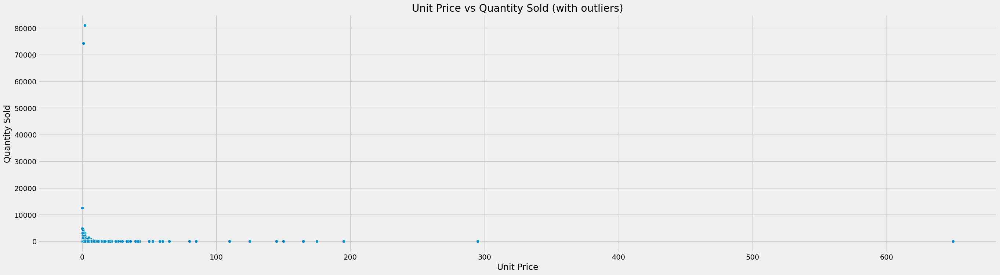

In [621]:
plt.figure(figsize=(30, 8))

sns.scatterplot(x="UnitPrice", y="Quantity", data=data)

plt.title("Unit Price vs Quantity Sold (with outliers)")
plt.xlabel("Unit Price")
plt.ylabel("Quantity Sold")
plt.show()

If there are too many data points and the scatterplot is too crowded, we may also consider using a hexbin plot, which will divide the graph into hexagonal bins and color each bin according to how many points fall into it.

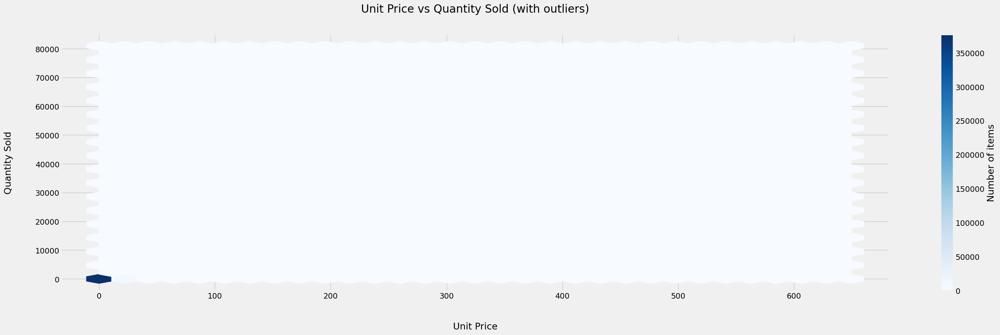

In [622]:
plt.figure(figsize=(30, 8))

plt.hexbin(data["UnitPrice"], data["Quantity"], gridsize=30, cmap="Blues")

cb = plt.colorbar(label="Number of items")

plt.title("Unit Price vs Quantity Sold (with outliers)", pad=40)
plt.xlabel("Unit Price", labelpad=40)
plt.ylabel("Quantity Sold", labelpad=40)
plt.show()

In [623]:
Q1 = data["Quantity"].quantile(0.25)
Q3 = data["Quantity"].quantile(0.75)
IQR = Q3 - Q1

filter = (data["Quantity"] >= Q1 - 1.5 * IQR) & (data["Quantity"] <= Q3 + 1.5 *IQR)
data_no_outliers = data.loc[filter]

# Group the data by UnitPrice and compute the mean of Quantity
price_quantity_relationship_no_outliers = data_no_outliers.groupby("UnitPrice")["Quantity"].mean().reset_index()

# Sort the data by UnitPrice
price_quantity_relationship_no_outliers = price_quantity_relationship_no_outliers.sort_values("UnitPrice")
price_quantity_relationship_no_outliers

,UnitPrice,Quantity
0,0.00,7.60
1,0.00,1.00
2,0.06,10.00
3,0.08,17.21
4,0.09,11.00
...,...,...
259,165.00,1.00
260,175.00,2.00
261,195.00,1.00
262,295.00,1.00


In [624]:
price_quantity_relationship_no_outliers.describe()

,UnitPrice,Quantity
count,264.00,264.00
mean,15.88,8.36
std,50.48,6.56
min,0.00,1.00
25%,1.69,2.32
50%,4.59,7.08
75%,10.03,12.37
max,649.50,25.00


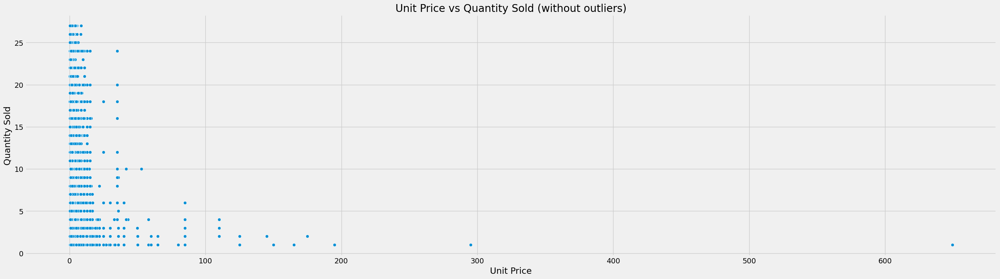

In [625]:
plt.figure(figsize=(30, 8))

sns.scatterplot(x="UnitPrice", y="Quantity", data=data_no_outliers)

plt.title("Unit Price vs Quantity Sold (without outliers)")
plt.xlabel("Unit Price")
plt.ylabel("Quantity Sold")
plt.show()

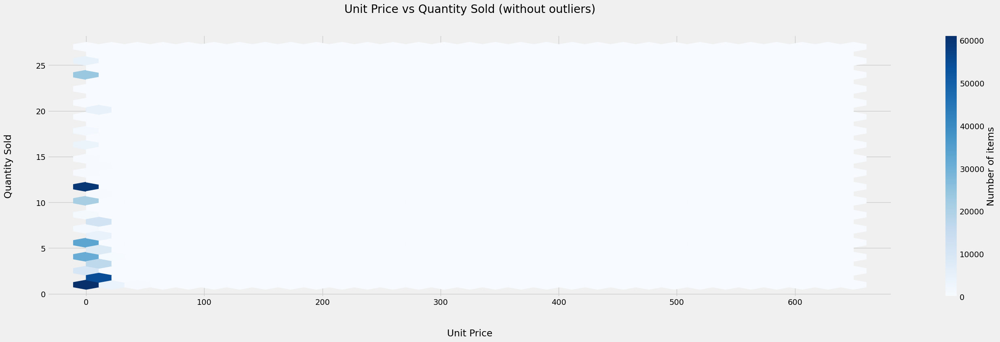

In [626]:
plt.figure(figsize=(30, 8))

plt.hexbin(data_no_outliers["UnitPrice"], data_no_outliers["Quantity"], gridsize=30, cmap="Blues")

cb = plt.colorbar(label="Number of items")

plt.title("Unit Price vs Quantity Sold (without outliers)", pad=40)
plt.xlabel("Unit Price", labelpad=40)
plt.ylabel("Quantity Sold", labelpad=40)
plt.show()

In [627]:
product_quantity = data.groupby(["Description"]).agg({"Quantity": "sum", "UnitPrice": pd.Series.mode}).sort_values(by="Quantity", ascending=False).reset_index()
top_product_quantity = product_quantity.head(20)
top_product_quantity

,Description,Quantity,UnitPrice
0,little paper birdie craft,80995,2.08
1,jar storage medium ceramic,77916,1.25
2,designs world war asstd gliders 2,54319,0.29
3,small popcorn holder,49160,0.85
4,jumbo retrospot bag red,46078,2.08
5,cream holder tlight white hanging heart,36763,2.95
6,ornament assorted bird colour,35263,1.69
7,pack 72 retrospot cake cases,33670,0.55
8,rabbit light night,27153,2.08
9,vintage paint set mini,26076,0.65


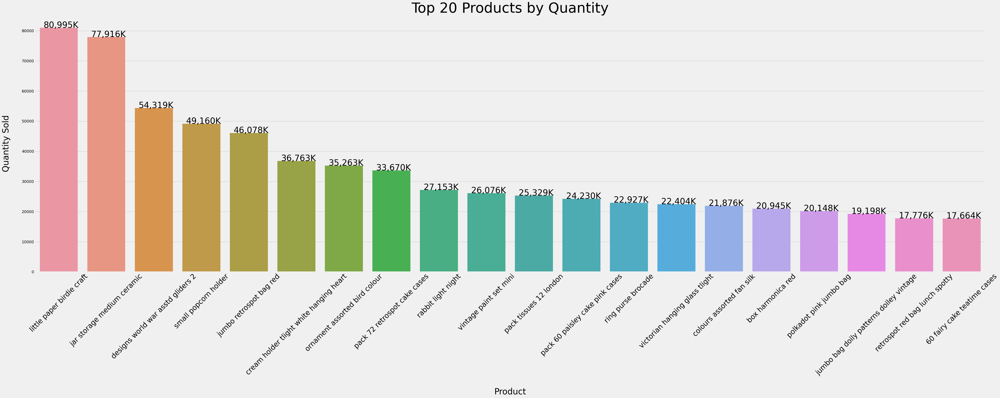

In [628]:
plt.figure(figsize=(50,20))

bar = sns.barplot(data=top_product_quantity, x="Description", y="Quantity", order=top_product_quantity.sort_values("Quantity",ascending = False).Description, errorbar=None)

bar.set_xlabel("Product", fontsize=30, labelpad=40)
bar.set_ylabel("Quantity Sold", fontsize=30, labelpad=40)

for p in bar.patches:
    bar.annotate(f"\n{round(p.get_height()):,}K", (p.get_x()+0.08, p.get_height()+3), color="k", fontsize=30)

plt.xticks(fontsize=25, rotation=45)
# plt.xlabel(" ", fontsize=30, labelpad=40)
# plt.ylabel(" ", fontsize=30, labelpad=40)
plt.title("Top 20 Products by Quantity", fontsize=50)
plt.tight_layout()
plt.show()

**Title: "Product Sales Volume and Unit Pricing Analysis"**

**Report:**

The provided data delineates the sales volume (quantity sold) and the unit price of different products. This analysis identifies the products that are purchased in larger quantities and observes the correlation with the unit price.

**Key Observations:**

1. **High-Volume, Low-Price Products** <br>
Products like 'paper craft little birdie', 'ceramic medium storage jar', and 'asstd gliders designs world 2 war' are selling in high volumes. Notably, these products have relatively lower unit prices, suggesting they may be popular due to their affordability.

2. **Mid-Volume, Mid-Price Products** <br>
Products such as 'white heart tlight holder cream hanging', 'ornament assorted bird colour', and 'bag red retrospot jumbo' have a moderate sales volume and a mid-range unit price. This could indicate a balanced cost-value perception among customers.

3. **Lower-Volume, Varying-Price Products** <br>
Products like 'harmonica box red', 'bag polkadot pink jumbo', and 'vintage doily bag patterns doiley jumbo' exhibit a lower sales volume. Their prices vary, indicating that pricing may not be the only factor affecting their sales volume. Other factors such as customer preference, product visibility, and marketing efforts could be affecting their performance.

4. **High Sales of Low-Priced Products** <br>
Many of the high-volume products have a low unit price, such as 'asstd gliders designs world 2 war' and '72 retrospot pack cake cases'. This trend could indicate a strong market for value or budget-friendly items.

**Key Insights:**

1. **Pricing Strategy for High-Volume Products** <br>
The high-volume sales of low-priced products suggests a strong market for these items. It might be beneficial to maintain competitive pricing for these products to continue driving sales volume.

2. **Marketing Focus on Mid-Volume, Mid-Price Products** <br>
Mid-volume, mid-price products could benefit from targeted marketing efforts. These products seem to offer a good balance of price and value and might have potential for sales growth.

3. **Investigate Low-Volume Products** <br>
It could be valuable to investigate the factors affecting the sales of lower-volume products. If these items are indeed less popular, it may be useful to reevaluate their pricing, marketing, or positioning in the store.

4. **Opportunities in Value Market**: The success of low-priced, high-volume products indicates a potential opportunity in the value market segment. Offering more products in this range could attract price-sensitive customers and increase overall sales volume.

This data provides a useful overview of product performance in terms of sales volume and pricing. To further refine strategies, it would be beneficial to consider additional factors, such as product margins, seasonal trends, and customer demographics.

#### 2. What is the distribution of revenue per transaction?*

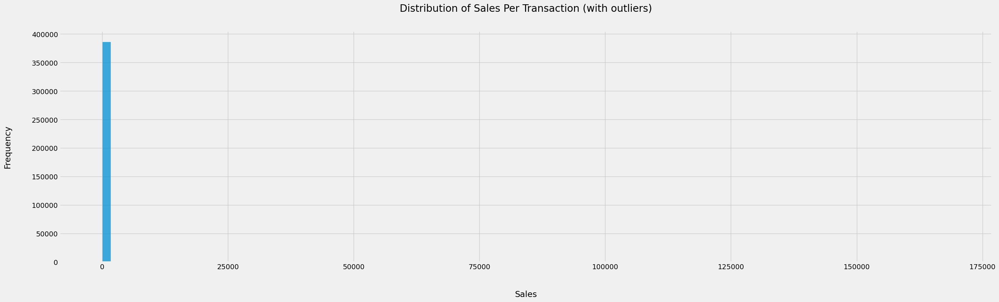

In [629]:
# Histogram of revenue per transaction
plt.figure(figsize=(30, 8))

sns.histplot(data["Revenue"], kde=False, bins=100)

plt.xlabel("Sales", labelpad=40)
plt.ylabel("Frequency", labelpad=40)
plt.title("Distribution of Sales Per Transaction (with outliers)", pad=40)
plt.show()

In [630]:
Q1 = data["Revenue"].quantile(0.25)
Q3 = data["Revenue"].quantile(0.75)
IQR = Q3 - Q1

filter = (data["Revenue"] >= Q1 - 1.5 * IQR) & (data["Revenue"] <= Q3 + 1.5 *IQR)
data_no_outliers = data.loc[filter]

# Group the data by UnitPrice and compute the mean of revenue
price_revenue_relationship_no_outliers = data_no_outliers.groupby("UnitPrice")["Revenue"].mean().reset_index()

# Sort the data by UnitPrice
price_revenue_relationship_no_outliers = price_revenue_relationship_no_outliers.sort_values("UnitPrice")
price_revenue_relationship_no_outliers

,UnitPrice,Revenue
0,0.00,0.00
1,0.00,0.00
2,0.04,5.29
3,0.06,3.77
4,0.07,12.32
...,...,...
209,30.00,30.00
210,32.95,32.95
211,33.29,33.29
212,35.95,35.95


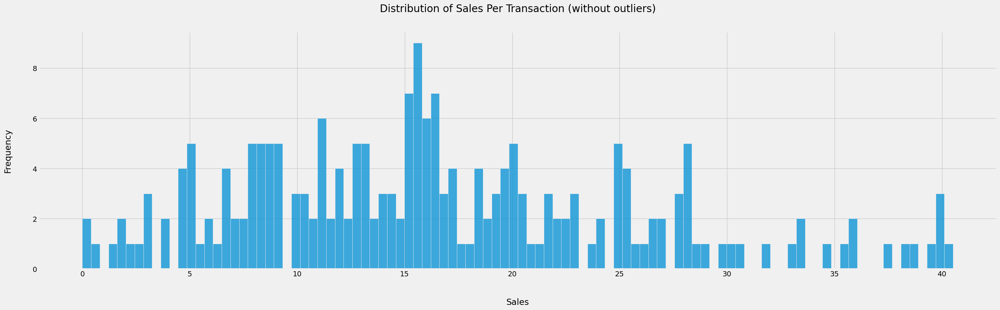

In [631]:
# Histogram of revenue per transaction
plt.figure(figsize=(30, 8))

sns.histplot(price_revenue_relationship_no_outliers["Revenue"], kde=False, bins=100)

plt.xlabel("Sales", labelpad=40)
plt.ylabel("Frequency", labelpad=40)
plt.title("Distribution of Sales Per Transaction (without outliers)", pad=40)
plt.show()

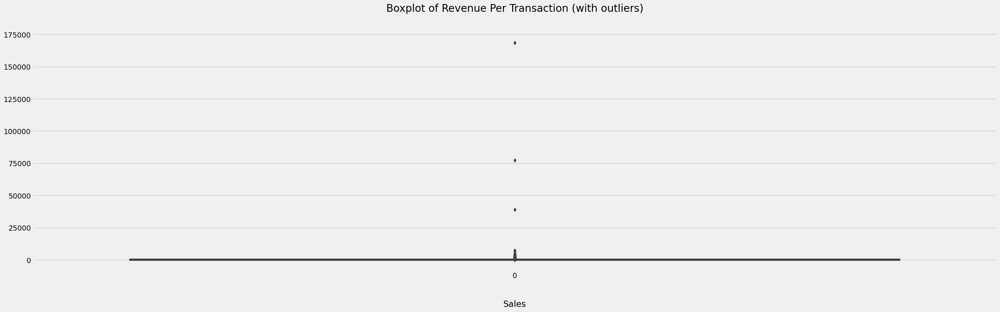

In [632]:
# Boxplot of revenue per transaction
plt.figure(figsize=(30, 8))

sns.boxplot(data["Revenue"])

plt.xlabel("Sales", labelpad=40)
plt.title("Boxplot of Revenue Per Transaction (with outliers)", pad=40)

plt.show()

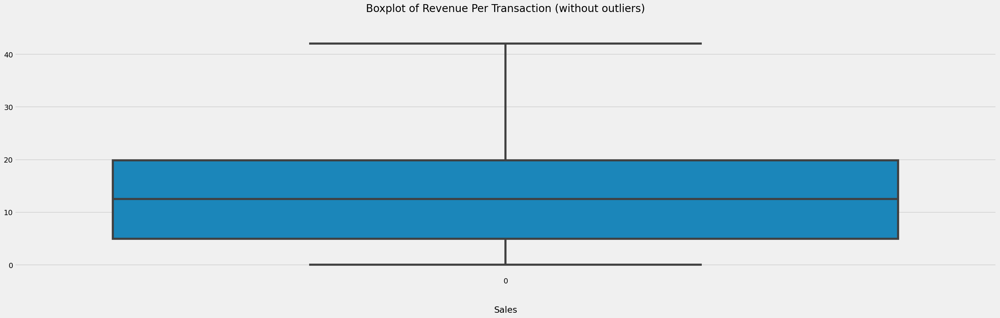

In [633]:
# Boxplot of revenue per transaction
plt.figure(figsize=(30, 8))

sns.boxplot(data["Revenue"], showfliers=False)

plt.xlabel("Sales", labelpad=40)
plt.title("Boxplot of Revenue Per Transaction (without outliers)", pad=40)

plt.show()

### Customer retention strategy

#### 1. How many purchases do customers make over a certain period?

In [634]:
# Group by "CustomerID" and "InvoiceDate" and count the number of purchases
purchases = data.groupby(["CustomerID", "YearMonth"]).size().reset_index(name="Number of Purchases")
purchases

,CustomerID,YearMonth,Number of Purchases
0,12346,2011-01,1
1,12347,2010-12,31
2,12347,2011-01,29
3,12347,2011-04,24
4,12347,2011-06,18
...,...,...,...
13025,18283,2011-10,38
13026,18283,2011-11,190
13027,18283,2011-12,50
13028,18287,2011-05,28


In [635]:
# Pivot data to get a table with "YearMonth" as the index, "CustomerID" as the columns, and "Number of Purchases" as the values
purchases_pivot = purchases.pivot(index="YearMonth", columns="CustomerID", values="Number of Purchases")
purchases_pivot

CustomerID  12346  12347  12348  12349  12350  12352  12353  12354  12355  \
YearMonth                                                                   
2010-12       NaN  31.00  16.00    NaN    NaN    NaN    NaN    NaN    NaN   
2011-01      1.00  29.00   5.00    NaN    NaN    NaN    NaN    NaN    NaN   
2011-02       NaN    NaN    NaN    NaN  16.00  15.00    NaN    NaN    NaN   
2011-03       NaN    NaN    NaN    NaN    NaN  18.00    NaN    NaN    NaN   
2011-04       NaN  24.00   4.00    NaN    NaN    NaN    NaN  58.00    NaN   
2011-05       NaN    NaN    NaN    NaN    NaN    NaN   4.00    NaN  13.00   
2011-06       NaN  18.00    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-07       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-08       NaN  22.00    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-09       NaN    NaN   2.00    NaN    NaN  30.00    NaN    NaN    NaN   
2011-10       NaN  47.00    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-11       NaN    NaN    NaN  72.00    NaN  14.00    NaN    NaN    NaN   
2011-12       NaN  11.00    NaN    NaN    NaN    NaN    NaN    NaN    NaN   

CustomerID  12356  12357  12358  12359  12360  12361  12362  12363  12364  \
YearMonth                                                                   
2010-12       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-01     35.00    NaN    NaN  15.00    NaN    NaN    NaN    NaN    NaN   
2011-02       NaN    NaN    NaN  80.00    NaN   9.00  26.00    NaN    NaN   
2011-03       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-04     21.00    NaN    NaN    NaN    NaN    NaN  28.00  16.00    NaN   
2011-05       NaN    NaN    NaN    NaN  44.00    NaN    NaN    NaN    NaN   
2011-06       NaN    NaN    NaN  47.00    NaN    NaN    NaN    NaN    NaN   
2011-07       NaN    NaN  11.00    NaN    NaN    NaN  18.00    NaN    NaN   
2011-08       NaN    NaN    NaN    NaN  29.00    NaN  29.00   7.00  33.00   
2011-09       NaN    NaN    NaN    NaN    NaN    NaN  39.00    NaN   1.00   
2011-10       NaN    NaN    NaN 100.00  53.00    NaN  72.00    NaN  21.00   
2011-11      2.00 131.00    NaN    NaN    NaN    NaN  15.00    NaN    NaN   
2011-12       NaN    NaN   6.00    NaN    NaN    NaN  29.00    NaN  26.00   

CustomerID  12365  12367  12370  12371  12372  12373  12374  12375  12377  \
YearMonth                                                                   
2010-12       NaN    NaN  89.00    NaN    NaN    NaN    NaN    NaN  43.00   
2011-01       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN  33.00   
2011-02     21.00    NaN    NaN    NaN  19.00  13.00    NaN    NaN    NaN   
2011-03       NaN    NaN  48.00    NaN    NaN    NaN    NaN    NaN    NaN   
2011-04       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-05       NaN    NaN    NaN    NaN  18.00    NaN    NaN    NaN    NaN   
2011-06       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-07       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-08       NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
2011-09       NaN    NaN    NaN    NaN  12.00    NaN    NaN  10.00    NaN   
2011-10       NaN    NaN  28.00  62.00    NaN    NaN    NaN    NaN    NaN   
2011-11       NaN    NaN    NaN    NaN    NaN    NaN  32.00   5.00    NaN   
2011-12       NaN  10.00    NaN    NaN    NaN    NaN    NaN    NaN    NaN   

CustomerID  12378  12379  12380  12381  12383  12384  12386  12388  12390  \
YearMonth                                                                   
2010-12       NaN    NaN    NaN    NaN  36.00    NaN   8.00    NaN    NaN   
2011-01       NaN    NaN    NaN    NaN  30.00    NaN   2.00  19.00    NaN   
2011-02       NaN    NaN    NaN    NaN    NaN    NaN    NaN   6.00    NaN   
2011-03       NaN    NaN    NaN    NaN  14.00    NaN    NaN  10.00    NaN   
2011-04       NaN    NaN    NaN    NaN  10.00    NaN    NaN    NaN    

In [636]:
# plt.figure(figsize=(30, 8))

# sns.lineplot(data=purchases_pivot, dashes=False)

# plt.title("Number of Purchases per Customer Over Time", pad=40)
# plt.xlabel("Time", labelpad=40)
# plt.ylabel("Number of Purchases", labelpad=40)
# plt.show()

In [637]:
# Group by "CustomerID" and "InvoiceDate" and count the number of purchases
purchases_country = data.groupby(["Country", "YearMonth"]).size().reset_index(name="Number of Purchases")
purchases_country

,Country,YearMonth,Number of Purchases
0,Australia,2010-12,31
1,Australia,2011-01,127
2,Australia,2011-02,89
3,Australia,2011-03,108
4,Australia,2011-04,17
...,...,...,...
281,Unspecified,2011-04,16
282,Unspecified,2011-05,47
283,Unspecified,2011-06,9
284,Unspecified,2011-07,144


![green-divider](https://user-images.githubusercontent.com/7065401/52071924-c003ad80-2562-11e9-8297-1c6595f8a7ff.png)
# Machine Learning

## Clustering

### Introduction

If we want to segment our customer base into different groups based on their buying behavior, we can use clustering algorithms like K-Means, DBSCAN or Hierarchical Clustering. <br>
This can be useful for targeted marketing campaigns.

| Steps  | Process/Tutorial | Assumptions | Meet Assumptions | Statistical Tests | Expected Results | Features Required | Python Libraries |
| ------ | ---------------- | ----------- | ---------------- | ----------------- | ---------------- | ----------------- | ---------------- |
| 1 | Import libraries and load the dataset. | N/A | N/A | N/A | N/A | Depends on the model | Pandas, sklearn |
| 2 | Preprocess data (handle missing values, outliers, scale variables, etc.). | The data is clean and ready for modelling. | This needs to be checked. | Various tests depending on preprocessing step | N/A | Depends on the model | Pandas, numpy, sklearn.preprocessing |
| 3 | Choose a clustering algorithm (KMeans, DBSCAN, Hierarchical, etc.). | The chosen model's assumptions fit the data. | This needs to be checked. | Elbow method, Silhouette score for choosing optimal clusters (KMeans) | The optimal number of clusters is identified. |Depends on the model | sklearn.cluster, scipy.cluster.hierarchy |
| 4 | Train the model on the entire data. | N/A | N/A | N/A | N/A | N/A | sklearn.cluster, scipy.cluster.hierarchy |
| 5 | Evaluate the clustering (silhouette score, within-cluster sum of squares, etc.). | N/A | N/A | N/A | N/A | N/A | sklearn.metrics |
| 6 | Interpret the clusters and apply labels if possible. | N/A | N/A | N/A | N/A | N/A | N/A |

**Note**: _Clustering is unsupervised, so there's no "ground truth" to compare against. Evaluation and interpretation often involves some domain knowledge._

### Overview

Customer segmentation is a critical task for understanding our customer base, improving customer service, and guiding marketing efforts. <br>
Here are some potential steps to conduct customer segmentation using machine learning:

1. **Define the Objective** <br><br>
The first step is to define the objective of the customer segmentation. What do we want to achieve with the segmentation? <br>
In our case, we want to identify different types of customers:
- Low value: customers who are less active than others, not very frequent buyer and generates very low to zero, and maybe negative revenue
- Mid value: in the middle of everything, not as much as the High values, but fairly frequent and generates moderate revenue
- High value: group we don’t want to los, high monetary value, frequency and low inactivity.

2. **Feature Selection and Engineering** <br><br>
Based on the objective, we have to identify the relevant features for segmentation. <br>
We may also need to create new features that better capture customer behavior. 

    For an online retail dataset like ours, potential features could include:
    - Recency: How recently a customer has made a purchase
    - Frequency: How often a customer makes a purchase
    - Monetary Value: How much money a customer spends <br><br>

3. **Preprocessing** <br><br>
Preprocessing might include dealing with missing values, outliers, and scaling the features so they have equal importance in the clustering process.

4. **Choose a Clustering Algorithm** <br><br>
The choice of clustering algorithm can depend on the dataset and objective. <br><br>
K-means is a popular choice because it's simple and effective. <br>
Indeed, it is widely used for segmentation and would be a good starting point. It's simple and works well when the clusters are spherical and of similar size. <br><br>
However, if we expect the clusters to be of different sizes or shapes, or if the results are not satisfactory, we might opt for other algorithm options like DBSCAN or hierarchical clustering. <br>

5. **Determine the Number of Clusters** <br><br>
If we're using a method like K-means, we'll need to decide on the number of clusters. <br>
Methods for doing this include the Elbow Method, the Silhouette Method, or the Gap Statistic.

6. **Train the Model** <br><br>
Using the selected algorithm and number of clusters, we can train the model on your preprocessed dataset.

7. **Analyze the Segments** <br><br>
Once the model has identified the clusters, we will analyze the segments to understand their characteristics. <br>
For instance, one segment might be frequent but low-spending customers, while another might be infrequent but high-spending customers.

8. **Implementation** <br><br>
We'll use the insights from the customer segmentation to guide business decisions. <br>
This might involve targeted marketing campaigns, personalized customer service, or developing new products.

Python Libraries that could be useful for this process include pandas for data manipulation, sklearn for preprocessing and clustering, matplotlib and seaborn for visualization, and numpy for numerical operations.

### Clustering Assumptions

Clustering methods like K-means make certain assumptions, and it's important to verify if the data meets those assumptions before proceeding. <br>
Here are the key assumptions for K-means clustering:

1. **Cluster Shape** (_clusters are spherical_) <br><br>
K-means assumes that clusters are convex and isotropic, which means they don't elongate towards any direction. <br>
In other words, it assumes that the distribution of spread within a cluster is spherical because it uses Euclidean distance.

2. **Equal Variance** <br><br>
K-means assumes all clusters have equal variance. <br>
The distance between points is used to form clusters, which might lead to problems if the clusters have unequal variance.

3. **Cluster Size** (_clusters are of similar size_) <br><br>
K-means assumes all clusters are of equal size, so it tends to be biased towards larger clusters. <br><br>

If these assumptions don't hold for our dataset, we should consider using a different clustering algorithm. <br>
We can use techniques like Principal Component Analysis (PCA) to visualize the clusters and check if these assumptions hold. <br>
The result of PCA should show a clear separation of clusters for the model to perform well. <br><br>

We can also verify these assumptions using simpler method such as leveraging data visualization and statistical techniques. <br>
For example, we can use pair plots, scatter plots, and box plots to check the cluster's shape, variance, and size. <br><br>

Please note, there's no surefire statistical test to verify these assumptions like we have for linear regression or other statistical models. <br>
But the visual inspection should give us a good understanding of whether our data meets the assumptions for K-means clustering.

We should remember that there is no "correct" segmentation. Different segmentations can provide different insights, and the best segmentation depends on your specific objectives.

### PCA Assumptions

Principal Component Analysis (PCA) is a technique used for reducing the dimensionality of datasets. <br>
It's used to transform high-dimensional datasets into a dataset with fewer dimensions, selecting the new axes to preserve as much data variance as possible.

Before diving into the step-by-step process of PCA, it's important to understand some of the assumptions that PCA makes: <br><br>

1. **Linearity**: PCA assumes that the principal components are a linear combination of the original features.

2. **Large variances define importance**: PCA assumes that the components with high variance have more importance.

3. **The mean and standard deviation are appropriate statistics**: PCA assumes the data is centered around the mean.

4. The principal components are orthogonal. <br><br>

PCA visualization can help us verify some of the assumptions. <br>
- If our clusters are circular (or spherical in high-dimensional space), this means they're likely isotropic, which aligns with the K-means assumption.
- If clusters have unequal sizes or shapes in the plot, this indicates the clusters in our original data likely also have unequal sizes or variances, which would violate the K-means assumptions. <br>

We should keep in mind that while PCA is a powerful tool, it might not always be the best method to check for these assumptions, since it's a linear method and may not capture complex structures and interactions in the data.


**Preprocessing**: 

Even though the outliers in your dataset are legitimate, they can still skew the results. Since K-means clustering is sensitive to outliers, it's often better to remove or transform these data points. However, it also depends on the business understanding and what you want to do with the outliers.

Yes, feature scaling is necessary in this case. K-Means uses Euclidean distance, so larger scales can dominate the smaller scale. In this case, `Recency`, `Frequency`, and `MonetaryValue` may have different scales, so it's a good idea to scale them:

```python
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(df_rfm)
df_rfm_normalized = scaler.transform(df_rfm)
```

**Clustering Algorithm**: 

K-means is widely used for segmentation and would be a good starting point. It's simple and works well when the clusters are spherical and of similar size. If the results are not satisfactory, other options such as DBSCAN or hierarchical clustering can be explored.

**Choosing Number of Clusters**: 

There are several ways to define the number of clusters in a dataset:

- **Elbow Criterion Method**: The idea of the elbow method is to run k-means clustering on the dataset for a range of values of k (say, k from 1 to 10), and for each value of k calculate the sum of squared errors (SSE). 

```python
from sklearn.cluster import KMeans

sse={}
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_rfm_normalized)
    sse[k] = kmeans.inertia_ # SSE to closest cluster centroid

plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()
```
Choose the k at the "elbow" i.e. the point after which the SSE starts to decrease linearly. 

- **Silhouette Coefficient Method**: A higher Silhouette Coefficient score relates to a model with better-defined clusters. The Silhouette Coefficient is defined for each sample and is composed of two scores:

a: The mean distance between a sample and all other points in the same class.
b: The mean distance between a sample and all other points in the next nearest cluster.
The Silhouette Coefficient s for a single sample is then given as: s = (b - a) / max(a, b)

```python
from sklearn.metrics import silhouette_score

sil_score={}
for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
   

 kmeans.fit(df_rfm_normalized)
    sil_score[k] = silhouette_score(df_rfm_normalized, kmeans.labels_, metric='euclidean')

plt.figure()
plt.plot(list(sil_score.keys()), list(sil_score.values()))
plt.xlabel("Number of cluster")
plt.show()
```
Choose the k with the highest Silhouette Coefficient.

Remember to import matplotlib as plt before the visualization code with this line:
```python
import matplotlib.pyplot as plt
``` 

This should give you a good start. Let me know if you have more questions.

**Feature Creation**:
Let's create Recency, Frequency, and Monetary (RFM) value. 

---
### Feature Selection and Engineering

#### 1. **Recency**: To calculate recency, we need to choose a date point from which we evaluate how many days ago was the customer's latest purchase.

In [638]:
snapshot_date = data["InvoiceDate"].max() + dt.timedelta(days=1) # latest date in our data plus one day
data_rfm = data.groupby(["CustomerID"]).agg({
    "InvoiceDate": lambda x: (snapshot_date - x.max()).days,
    "InvoiceNo": "count",
    "Revenue": "sum"})

data_rfm.head()

,InvoiceDate,InvoiceNo,Revenue
CustomerID,,,
12346,326,1,77183.60
12347,2,182,4310.00
12348,75,27,1437.24
12349,19,72,1457.55
12350,310,16,294.40


What did we just do? Let's break down each part step by step:

1. `data["InvoiceDate"].max()`: This part finds the maximum (latest) date in the "InvoiceDate" column of the dataset `data`. It selects the highest date value from all the available invoice dates.

2. `dt.timedelta(days=1)`: This represents a time duration of one day. It is a part of the Python `datetime` library that allows you to perform operations on dates and times.

3. `data["InvoiceDate"].max() + dt.timedelta(days=1)`: Here, we add one day to the maximum invoice date obtained in step 1. It essentially calculates the next day after the latest invoice date. This new date will be stored in the variable `snapshot_date`.

4. `"InvoiceDate": lambda x: (snapshot_date - x.max()).days`: This is a part of the `agg()` function, which stands for "aggregate." It groups the data by "CustomerID" and performs calculations on the grouped data.

   - `"InvoiceDate"`: This specifies the column name for which we want to calculate the RFM (Recency, Frequency, Monetary) values.
   - `lambda x: (snapshot_date - x.max()).days`: Here, `lambda` is a keyword in Python that allows you to define a small anonymous function. In this case, it is used to define a custom function that takes the group of values from the "InvoiceDate" column for each customer.
   - `(snapshot_date - x.max()).days`: Inside the custom function, `x` represents the group of invoice dates for a particular customer. This expression calculates the difference between the `snapshot_date` (the next day after the latest invoice date) and the maximum invoice date for that customer. The result is the number of days between the latest invoice and the snapshot date, which represents the recency value.

So, overall, this code snippet calculates the recency, frequency, and monetary values (RFM) for each customer in the dataset. The recency value is calculated as the number of days between the latest invoice date and the next day, the frequency value is the count of invoices for each customer, and the monetary value is the sum of the revenue for each customer. These calculations help in analyzing customer behavior and segmenting them based on their RFM scores.

#### 2. **Frequency and Monetary value** are straightforward to calculate. We already have the `Revenue` per transaction, and we can count the number of invoices per customer.

In [639]:
data_rfm.rename(columns={"InvoiceDate": "Recency",
                         "InvoiceNo": "Frequency",
                         "Revenue": "MonetaryValue"}, inplace=True)

data_rfm.head()

,Recency,Frequency,MonetaryValue
CustomerID,,,
12346,326,1,77183.60
12347,2,182,4310.00
12348,75,27,1437.24
12349,19,72,1457.55
12350,310,16,294.40


In [640]:
data_rfm.describe()

,Recency,Frequency,MonetaryValue
count,4336.00,4336.00,4336.00
mean,92.69,89.11,2016.50
std,100.20,221.98,8917.86
min,1.00,1.00,0.00
25%,18.00,17.00,304.25
50%,51.00,40.00,662.57
75%,143.00,97.00,1631.33
max,374.00,7465.00,279138.02


### Preprocessing

In [641]:
from sklearn.preprocessing import RobustScaler

feats = ["Recency", "Frequency", "MonetaryValue"]

scaler_rs = RobustScaler()
scaledRFM_rs = scaler_rs.fit_transform(data_rfm)

data_scaledRFM_rs = pd.DataFrame(scaledRFM_rs, columns=feats)
data_scaledRFM_rs.head()

,Recency,Frequency,MonetaryValue
0,2.20,-0.49,57.66
1,-0.39,1.77,2.75
2,0.19,-0.16,0.58
3,-0.26,0.40,0.60
4,2.07,-0.30,-0.28


### Assumptions

<Figure size 1500x1500 with 0 Axes>

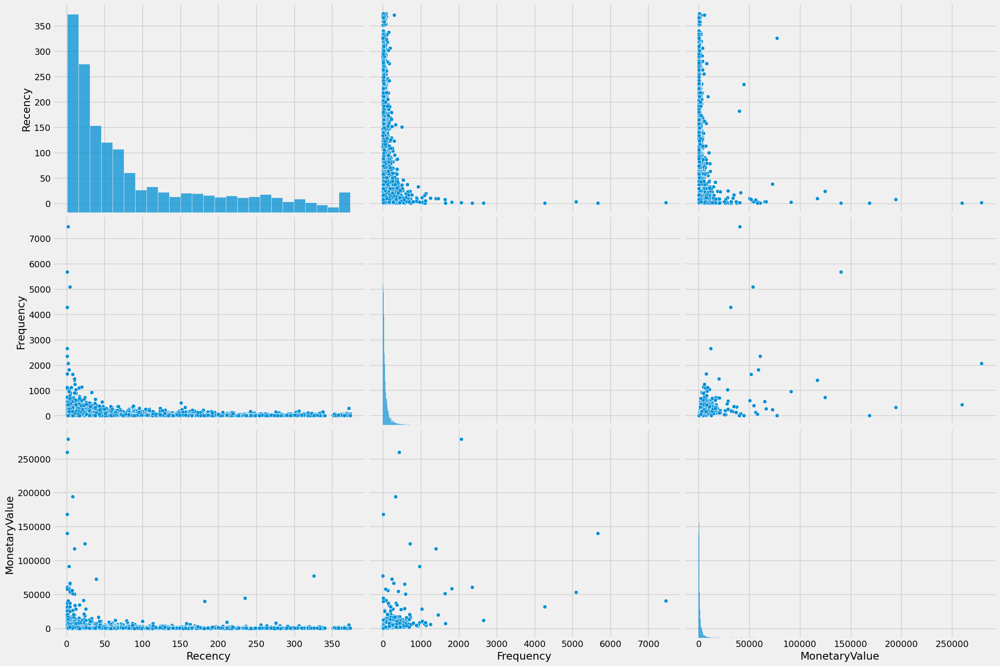

In [642]:
plt.figure(figsize=(15,15))

sns.pairplot(data_rfm, height=5, aspect=1.5)


,Recency,Frequency,MonetaryValue
Recency,1.00,-0.21,-0.12
Frequency,-0.21,1.00,0.42
MonetaryValue,-0.12,0.42,1.00


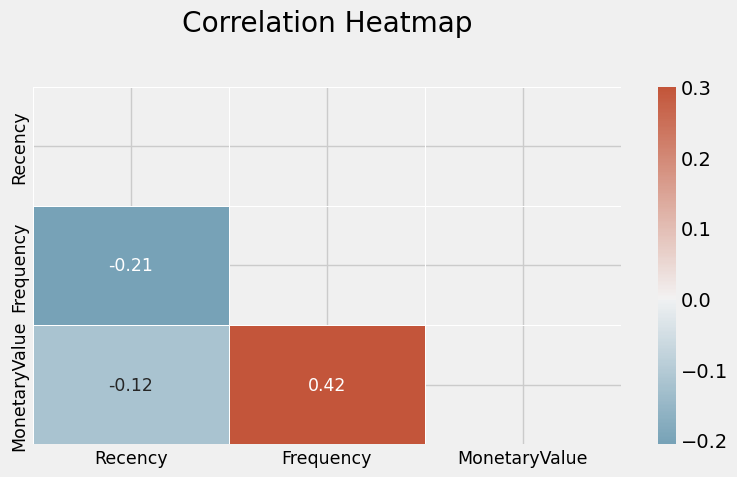

In [643]:
plt.figure(figsize=(8,5))

# Compute the correlation matrix
corr_map = data_scaledRFM_rs.corr()
display(corr_map)

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr_map, dtype=bool))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_map, mask=mask, cmap=cmap, vmax=.3, center=0, linewidths=.5, annot=True, fmt=",.2f", annot_kws={"fontsize": 12.5})

plt.title("Correlation Heatmap", pad=40)
plt.xticks(fontsize=12.5)
plt.yticks(fontsize=12.5)
plt.tight_layout()
plt.show()

,Recency,Frequency,MonetaryValue
Recency,1.00,-0.21,-0.12
Frequency,-0.21,1.00,0.42
MonetaryValue,-0.12,0.42,1.00


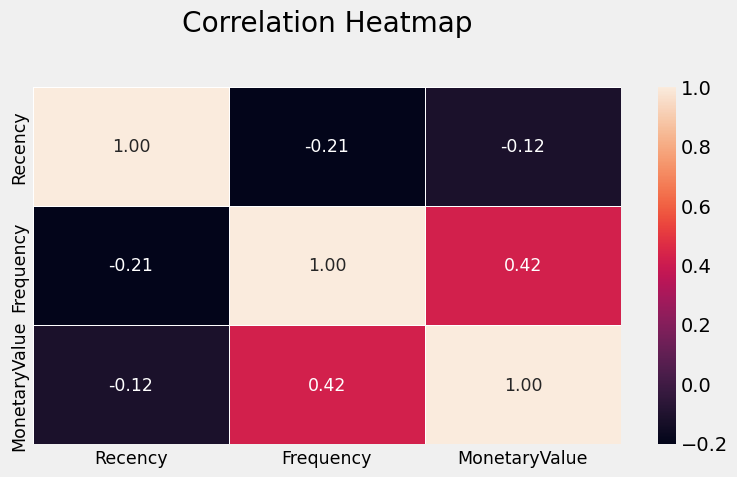

In [644]:
plt.figure(figsize=(8,5))

corr = data_scaledRFM_rs.corr()
display(corr)

corr_map = sns.heatmap(corr, linewidths=.5, annot=True, fmt=",.2f", annot_kws={"fontsize": 12.5})

# for text in corr_map.texts:
#     text.set_size(10)

plt.title("Correlation Heatmap", pad=40)

plt.xticks(fontsize=12.5)
plt.yticks(fontsize=12.5)

corr_map.xaxis.labelpad = 40
corr_map.yaxis.labelpad = 40

plt.tight_layout()
plt.show()

The given table is a correlation matrix which describes the relationship between three features: Recency, Frequency, and MonetaryValue.

Here's what these correlations imply:

1. **Recency vs. Frequency** <br><br>
A correlation of -0.21 suggests a weak negative correlation. <br>
This means that as the 'Recency' of a customer's purchase increases (i.e., the longer the time since the last purchase), the 'Frequency' of their purchases (i.e., how often they buy) tends to decrease slightly, and vice versa. <br>
This relationship is not particularly strong, however, as it is only -0.21. <br><br>

2. **Recency vs. MonetaryValue** <br><br>
The correlation of -0.12 indicates a very weak negative correlation. <br>
This implies that the more recent a customer's last purchase, the lower the 'MonetaryValue' (i.e., how much they spend) tends to be, but this tendency is quite weak. <br>
It also means the longer it has been since a customer's last purchase, the more they might spend, but again, this relationship is very weak. <br><br>

3. **Frequency vs. MonetaryValue** <br><br>
A correlation of 0.42 signifies a moderate positive correlation. <br>
This suggests that as the 'Frequency' of a customer's purchases increases, the 'MonetaryValue' of their purchases also tends to increase. <br>
In other words, customers who shop more often tend to spend more overall.

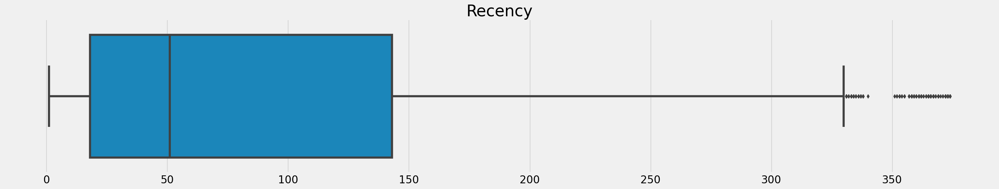

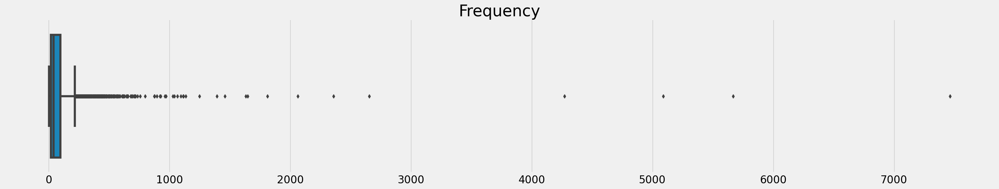

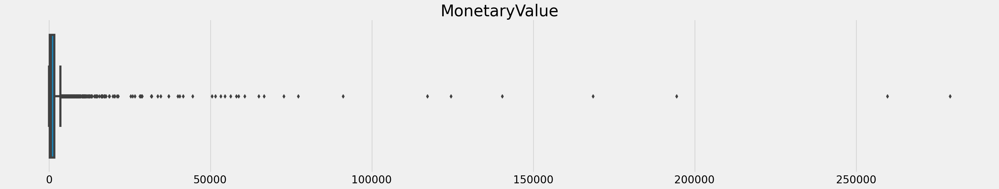

In [645]:
for feat in feats:

    plt.figure(figsize=(30, 5))
    sns.boxplot(x=data_rfm[feat])

    plt.title(f"{feat}", fontsize=30)
    plt.xticks(fontsize=20)
    plt.xlabel(None)
    plt.show()

### Choosing $k$ -- _number of clusters_

There are several ways to define the number of clusters in a dataset:

##### 1. **Elbow Criterion Method**

The idea of the elbow method is to run k-means clustering on the dataset for a range of values of k (say, k from 1 to 10), and for each value of k calculate the sum of squared errors (SSE). <br>
We will choose the $k$ at the "elbow" i.e. the point after which the SSE starts to decrease linearly. _

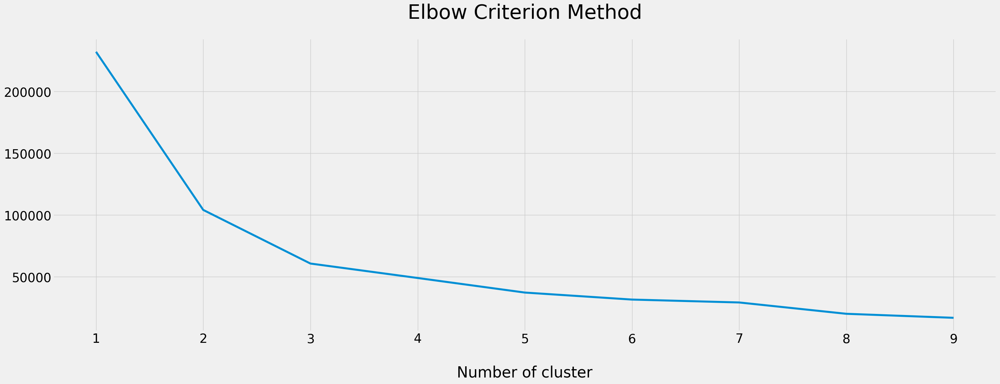

In [646]:
from sklearn.cluster import KMeans

sse={}

for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init="auto")
    kmeans.fit(scaledRFM_rs)
    sse[k] = kmeans.inertia_ # SSE to closest cluster centroid

plt.figure(figsize=(30,10))
plt.plot(list(sse.keys()), list(sse.values()))

plt.title("Elbow Criterion Method", fontsize=40, pad=40)
plt.xlabel("Number of cluster", fontsize=30, labelpad=40)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
plt.show()

##### 2. **Silhouette Coefficient Method**

A higher Silhouette Coefficient score relates to a model with better-defined clusters. <br>
The Silhouette Coefficient is defined for each sample and is composed of two scores:

- a: The mean distance between a sample and all other points in the same class.
- b: The mean distance between a sample and all other points in the next nearest cluster. <br>

The Silhouette Coefficient s for a single sample is then given as: $s = (b - a) / max(a, b)$ <br><br>

We will choose the $k$ with the highest Silhouette Coefficient.

The highest silhouette score is 0.9687315266903924 and is achieved with 2 clusters.


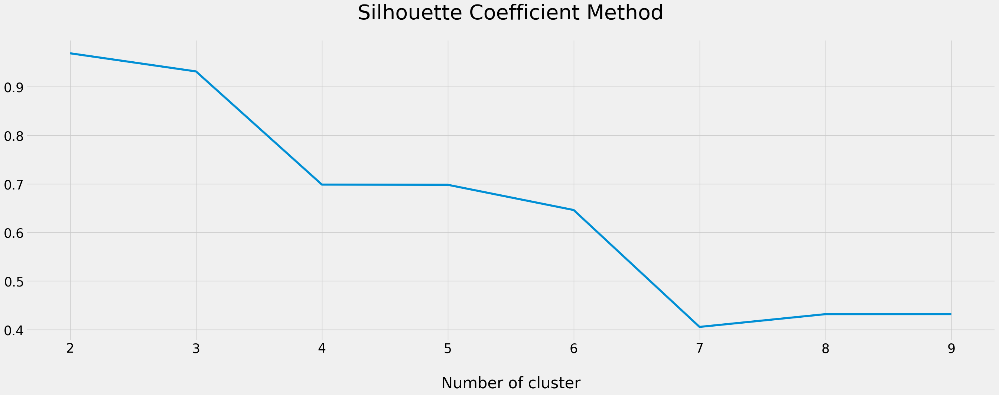

In [647]:
from sklearn.metrics import silhouette_score

sil_score={}

for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init="auto")
    kmeans.fit(scaledRFM_rs)
    sil_score[k] = silhouette_score(scaledRFM_rs, kmeans.labels_, metric="euclidean")

max_sil_score = max(sil_score.values())  # The maximum silhouette score
best_k = max(sil_score, key=sil_score.get)  # The number of clusters (k) that gives the maximum silhouette score
print(f"The highest silhouette score is {max_sil_score} and is achieved with {best_k} clusters.")

plt.figure(figsize=(30,10))
plt.plot(list(sil_score.keys()), list(sil_score.values()))

plt.title("Silhouette Coefficient Method", fontsize=40, pad=40)
plt.xlabel("Number of cluster", fontsize=30, labelpad=40)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
plt.show()

### PCA

##### 1. **Standardize the Data:**

PCA is affected by scale, so we need to scale the features of the data before applying PCA. 

In [648]:
# From Preprocessing phase
display(data_scaledRFM_rs.head())
scaledRFM_rs

,Recency,Frequency,MonetaryValue
0,2.20,-0.49,57.66
1,-0.39,1.77,2.75
2,0.19,-0.16,0.58
3,-0.26,0.40,0.60
4,2.07,-0.30,-0.28


array([[ 2.2       , -0.4875    , 57.66120731],
       [-0.392     ,  1.775     ,  2.74846656],
       [ 0.192     , -0.1625    ,  0.58374401],
       ...,
       [-0.344     , -0.35      , -0.36509856],
       [-0.376     ,  8.0875    ,  1.03762772],
       [-0.064     ,  0.3625    ,  0.88518778]])

##### 2. **Apply PCA:**

Let's import PCA module from sklearn library and apply it. We'll choose the first two principal components.

In [649]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(scaledRFM_rs)

PCA(n_components=2)

##### 3. **Get the PCA Components (loadings):**

PCA components are a linear combination of the original features. These coefficients are called loadings.

In [650]:
loadings = pca.components_
loadings

array([[-0.01579346,  0.1973796 ,  0.98019991],
       [-0.05824503,  0.97847587, -0.19797091]])

##### 4. **Transform the Data:**

Now let's project the original data into the PCA space.

In [651]:
pca_rs = pca.transform(scaledRFM_rs)
pca_rs

array([[ 55.27262249, -12.39958801],
       [  1.93466706,   0.83631015],
       [ -0.57884014,  -0.66494986],
       ...,
       [ -1.53743893,  -0.62935151],
       [  1.50340904,   7.3507035 ],
       [ -0.17569757,  -0.19601639]])

In [652]:
pca_rs.shape

(4336, 2)

In [653]:
pca_rs_data = pd.DataFrame(data=pca_rs, columns=["Principal Component 1", "Principal Component 2"])
pca_rs_data

,Principal Component 1,Principal Component 2
0,55.27,-12.40
1,1.93,0.84
2,-0.58,-0.66
3,-0.45,-0.09
4,-1.48,-0.74
...,...,...
4331,-1.57,-0.78
4332,-1.64,-0.76
4333,-1.54,-0.63
4334,1.50,7.35


##### 5. **Explained Variance Ratio:**

In sklearn's PCA object, there's a handy attribute called `explained_variance_ratio_`. This gives us an array showing how much variance each selected component explains. <br>
Why is this crucial? Well, it lets us understand how much data 'information' can be attributed to each principal component. <br><br>

These variance ratio values always fall between 0 and 1, and if we add them all up, they'll equal 1. <br>
A principal component with a high explained variance ratio means it captures a good chunk of the data's information. <br><br>

When we're using PCA to reduce dimensionality, the goal is usually to keep as much of that information as possible. <br>
That means we want our principal components to account for a large portion of the variance. <br>
How high that proportion should be really depends on our specific requirements and how much we want to reduce the dimensionality. <br><br>

As a general guide, an accumulated explained variance of 70-90% is often seen as acceptable. <br>
If the first two principal components together explain variance within this range, it suggests that they're holding on to most of the key information. <br><br>

However, if the combined explained variance ratio of these first two components is very low - say, less than 50% - we might want to think about keeping more components. <br><br>

The main thing to remember is that PCA is all about reducing dimensionality while holding onto as much data as possible. <br>
It's a bit of a balancing act, finding that sweet spot between these two objectives.

In [654]:
evr_rs = pca.explained_variance_ratio_
print(f"Explained variance ratio: {evr_rs}")

Explained variance ratio: [0.87383766 0.11471658]


The explained variance ratio we obtained means that the first principal component explains approximately 87.38% of the variance in our dataset, while the second component explains approximately 11.47%. <br>

Taken together, our two principal components explain roughly 98.85% of the total variance in our data (0.87383766 + 0.11471658). <br>
This is an excellent result! It suggests that our two-dimensional PCA transformation has successfully retained most of the information from our original dataset. <br>

Therefore, our PCA has performed quite well, as these two principal components manage to keep a very high percentage of the original data variance, which is well above the typical satisfactory threshold (70-90%).

##### 6. **Calculate the centroids in the PCA-transformed space** (perform $k$ _means_)**:**

In [655]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3, random_state=0, n_init="auto")
kmeans_clusters = kmeans.fit_predict(pca_rs)
kmeans_clusters

array([2, 0, 0, ..., 0, 0, 0], dtype=int32)

In [656]:
kmeans_centroids = kmeans.cluster_centers_
kmeans_centroids

array([[-4.66176088e-01, -2.79698103e-02],
       [ 1.37499898e+02, -9.56891485e+00],
       [ 3.47197239e+01,  6.24082061e+00]])

In [657]:
kmeans_centroids.shape

(3, 2)

In [658]:
kmeans_centroids_data = pd.DataFrame(data=kmeans_centroids, columns=["Principal Component 1", "Principal Component 2"])
kmeans_centroids_data

,Principal Component 1,Principal Component 2
0,-0.47,-0.03
1,137.50,-9.57
2,34.72,6.24


##### 7. **Visualize the Data with the First Two Principal Components:**

Let's plot the first two principal components and color the points by cluster.

Text(0, 0.5, 'Second Principal Component')

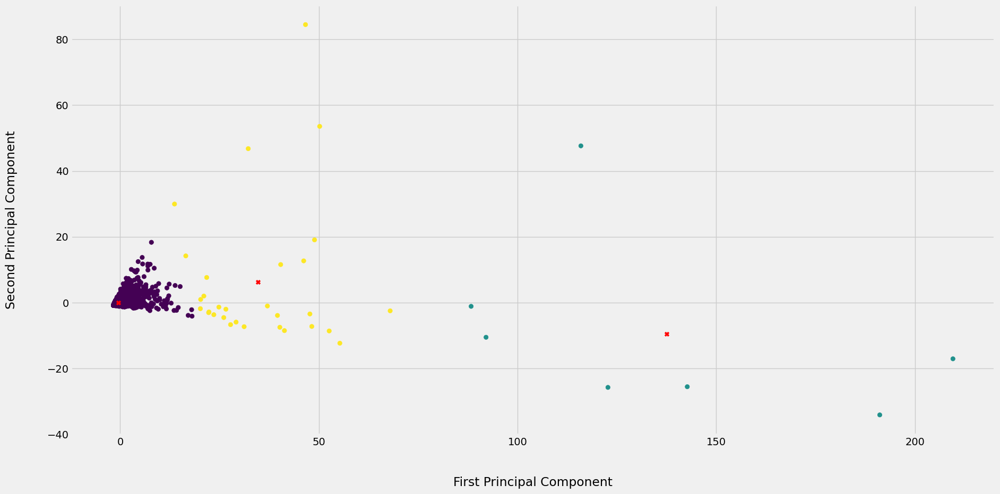

In [659]:
plt.figure(figsize=(20,10))

plt.scatter(pca_rs[:, 0], pca_rs[:, 1], c=kmeans_clusters)
plt.scatter(kmeans_centroids[:, 0], kmeans_centroids[:, 1], c="red", marker="X")

plt.xlabel("First Principal Component", labelpad=40)
plt.ylabel("Second Principal Component", labelpad=40)

### Customer Segmentation

In [660]:
rfm = data_rfm.copy()
rfm["Cluster"] = kmeans_clusters
rfm

,Recency,Frequency,MonetaryValue,Cluster
CustomerID,,,,
12346,326,1,77183.60,2
12347,2,182,4310.00,0
12348,75,27,1437.24,0
12349,19,72,1457.55,0
12350,310,16,294.40,0
...,...,...,...,...
18280,278,10,180.60,0
18281,181,7,80.82,0
18282,8,12,178.05,0


#### Understanding the clusters

In [661]:
group = rfm.groupby("Cluster").mean()
group

,Recency,Frequency,MonetaryValue
Cluster,,,
0,93.26,79.53,1417.42
1,6.71,1515.71,183395.72
2,31.50,1127.90,45542.65


,Recency,Frequency,MonetaryValue,Cluster
Recency,1.00,-0.21,-0.12,-0.06
Frequency,-0.21,1.00,0.42,0.44
MonetaryValue,-0.12,0.42,1.00,0.59
Cluster,-0.06,0.44,0.59,1.00


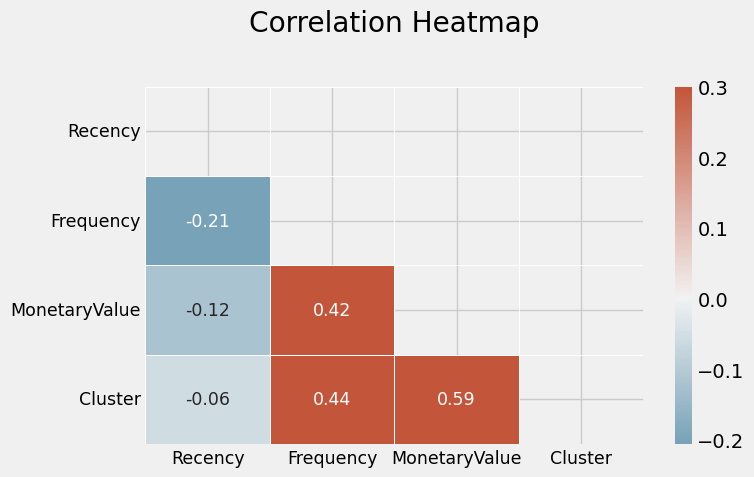

,Recency,Frequency,MonetaryValue
Cluster,,,
0,93.26,79.53,1417.42
1,6.71,1515.71,183395.72
2,31.50,1127.90,45542.65


In [662]:
plt.figure(figsize=(8,5))

# Compute the correlation matrix
corr = rfm.corr()
display(corr)

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0, linewidths=.5, annot=True, fmt=",.2f", annot_kws={"fontsize": 12.5})

plt.title("Correlation Heatmap", pad=40)
plt.xticks(fontsize=12.5)
plt.yticks(fontsize=12.5)
plt.tight_layout()
plt.show()

display(group)

In light of the clustering results, we are in a position to better understand our customer base and can make the following assessments:

- **High-Value Customers (Cluster 1)** <br><br>

    - These are our star customers.
    - They demonstrate the lowest mean recency of 6.71, which indicates they have made purchases very recently.
    - They also exhibit a high frequency of purchase with a mean of 1515.71 and contribute significantly to our revenue, spending approximately 183,395.72 on average. <br><br>
    - These customers are our core clientele and our marketing strategies should prioritize maintaining their loyalty and satisfaction.
    - Personalized deals, premium customer services, and exclusive access to new products could help sustain their engagement.
    - In addition, understanding their preferences and needs can unlock potential upselling and cross-selling opportunities. <br><br>

- **Mid-Value Customers (Cluster 2)**

    - Customers in this cluster demonstrate moderate purchasing behavior.
    - With a mean recency of 31.5, they have purchased quite recently, but not as recent as our high-value customers.
    - They have a high frequency of purchase, about 1127.90 on average, and spend a decent amount, approximately 45,542.65 on average. <br><br>
    - This group can be the potential high-value customers for our business.
    - Effective customer engagement strategies that make them feel valued could encourage them to make more frequent and high-value purchases.
    - This could include targeted marketing campaigns based on their past purchases or offering incentives to increase the amount they spend per transaction. <br><br>

- **Low-Value Customers (Cluster 0)**

    - These customers haven't engaged with our business for some time, as evidenced by their high mean recency of 93.26.
    - They also demonstrate the lowest mean frequency and monetary value, around 79.53 and 1417.42 respectively. <br><br>
    - Despite the lower current value, these customers should not be neglected.
    - Retention strategies should focus on re-engaging with this customer base.
    - This might involve reaching out to them with special offers or looking into their previous purchases to understand their interests.
    - It could also be worthwhile to gather feedback to understand why their engagement has decreased and what could potentially make them active buyers again.

These insights provide valuable guidance for developing tailored marketing and customer engagement strategies. <br>
Each customer segment is unique and understanding these differences can help us allocate our resources more effectively to maximize customer satisfaction, retention, and ultimately, revenue.

Lastly, we should remember that this analysis is based on past behavior and does not necessarily predict future behavior. <br>
Customer segmentation should be a continuous process, with groups evolving as the customer's behaviors change over time. <br>
Regular reassessment will ensure that our understanding of our customer base remains accurate and our strategies are effective.

#### Few visualizations

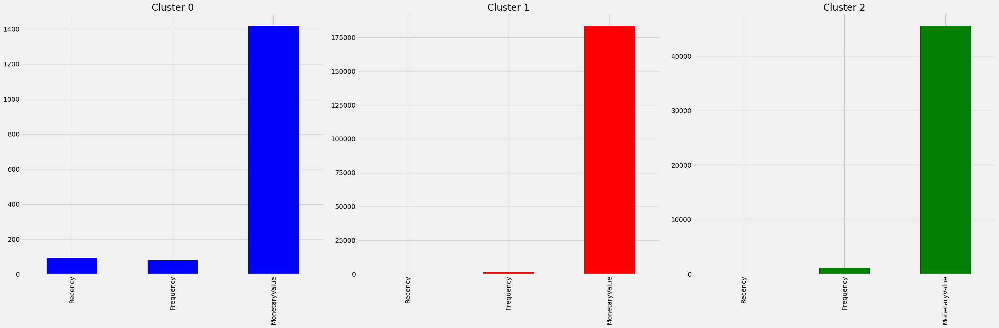

In [663]:
import matplotlib.pyplot as plt

clusters = group.index.unique()

colors = ["blue", "red", "green"]  # Adjust colors list to match number of clusters, if needed

plt.figure(figsize=(30, 10))  # Adjust size as needed

for i, cluster in enumerate(clusters):
    plt.subplot(1, len(clusters), i + 1)
    subset = group.loc[cluster]
    subset.plot(kind="bar", color=colors[i], edgecolor="black")
    plt.title(f"Cluster {cluster}")

plt.tight_layout()
plt.show()


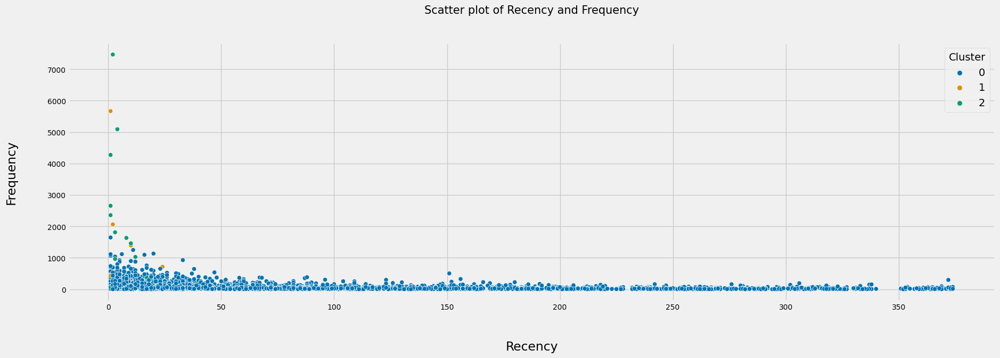

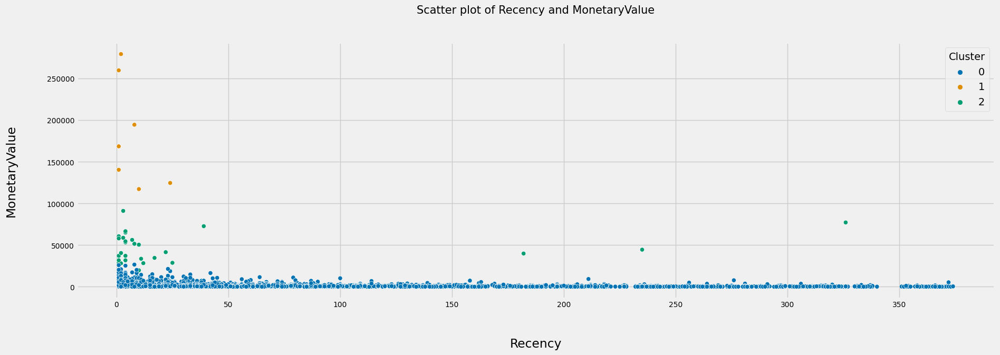

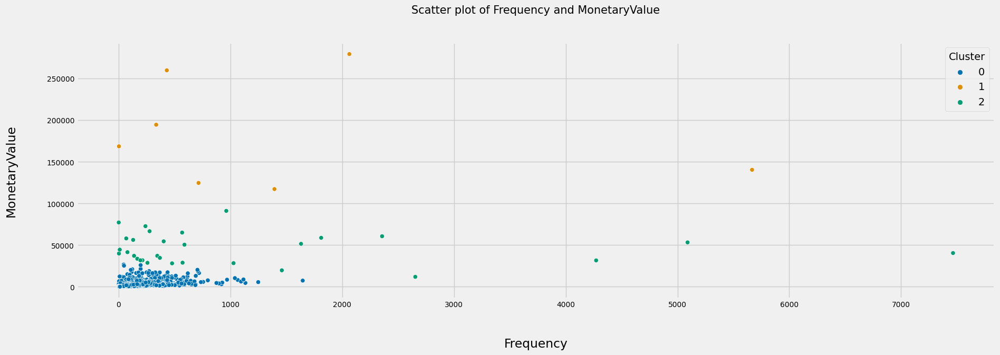

In [664]:
features = rfm.columns.drop("Cluster")
n = len(features)

for i in range(n):
    for j in range(i+1, n):
        plt.figure(figsize=(20, 6))
        sns.scatterplot(data=rfm, x=features[i], y=features[j], hue="Cluster", palette="colorblind")

        plt.xlabel(features[i], labelpad=40)
        plt.ylabel(features[j], labelpad=40)
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)

        plt.title(f"Scatter plot of {features[i]} and {features[j]}", fontsize=15, pad=40)
        plt.show()

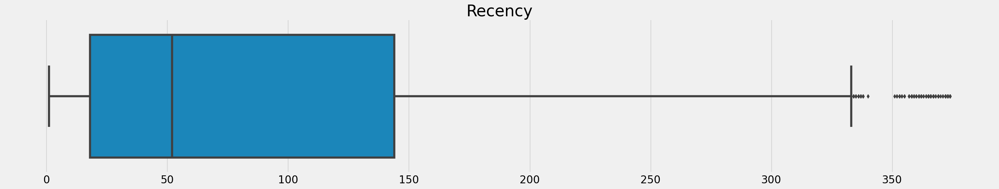

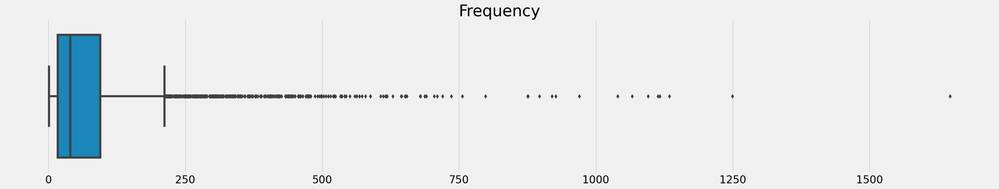

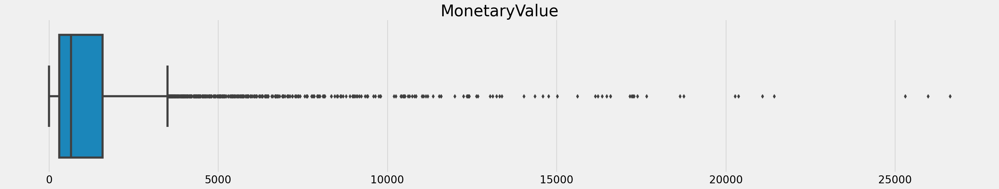

In [665]:
cluster_0 = rfm.query("Cluster == 0")

for feat in feats:

    plt.figure(figsize=(30, 5))
    sns.boxplot(x=cluster_0[feat])

    plt.title(f"{feat}", fontsize=30)
    plt.xticks(fontsize=20)
    plt.xlabel(None)
    plt.show()

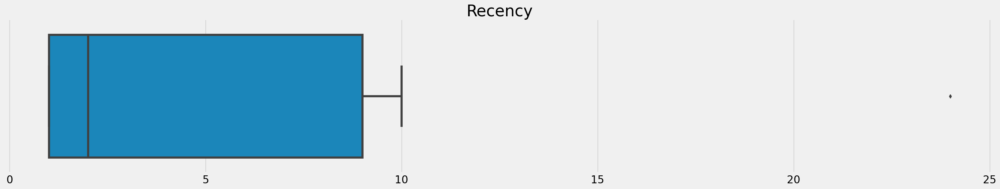

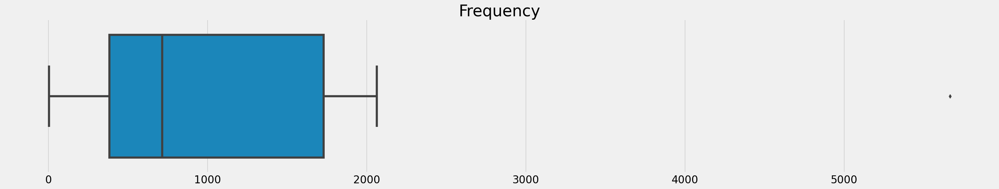

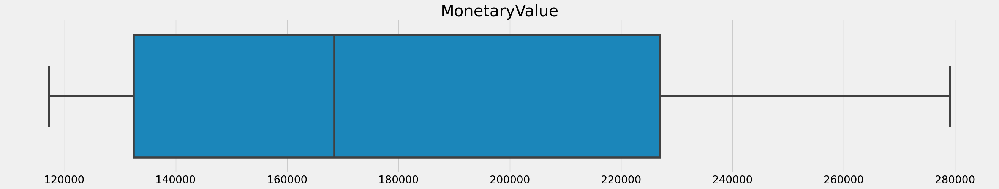

In [666]:
cluster_1 = rfm.query("Cluster == 1")

for feat in feats:

    plt.figure(figsize=(30, 5))
    sns.boxplot(x=cluster_1[feat])

    plt.title(f"{feat}", fontsize=30)
    plt.xticks(fontsize=20)
    plt.xlabel(None)
    plt.show()

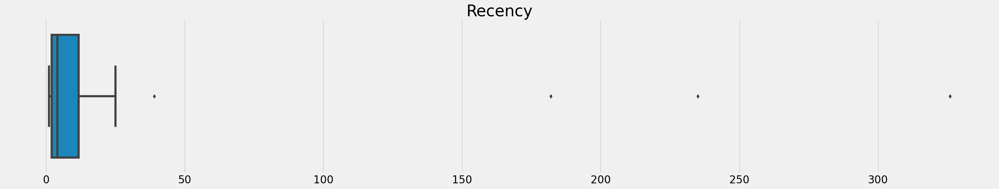

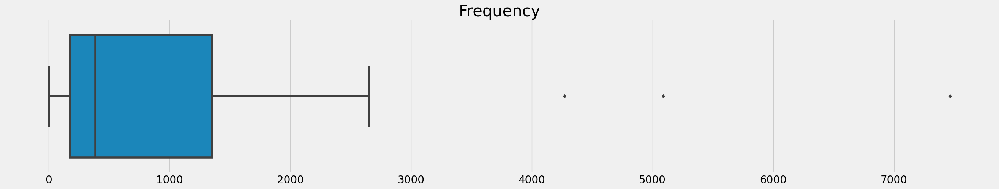

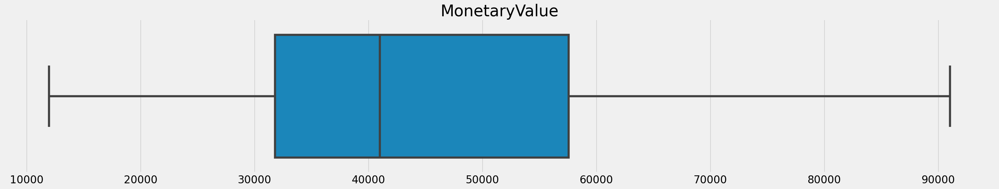

In [667]:
cluster_2 = rfm.query("Cluster == 2")

for feat in feats:

    plt.figure(figsize=(30, 5))
    sns.boxplot(x=cluster_2[feat])

    plt.title(f"{feat}", fontsize=30)
    plt.xticks(fontsize=20)
    plt.xlabel(None)
    plt.show()

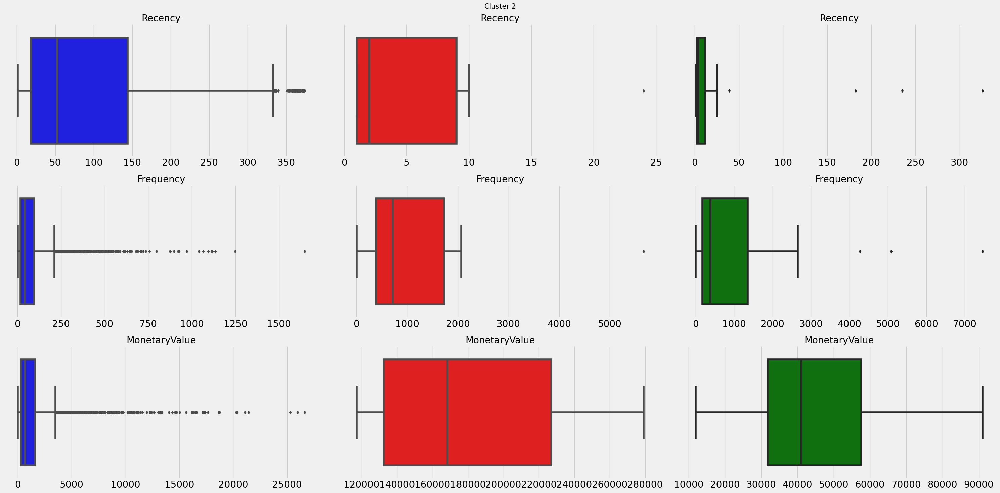

In [668]:
clusters = [rfm.query("Cluster == {}".format(i)) for i in range(3)]
feats = ['Recency', 'Frequency', 'MonetaryValue']
colors = ['blue', 'red', 'green']

plt.figure(figsize=(30, 15))

for i, feat in enumerate(feats):
    for j, cluster in enumerate(clusters):
        plt.subplot(len(feats), len(clusters), i*len(clusters) + j + 1)
        sns.boxplot(x=cluster[feat], color=colors[j])
        plt.title(feat, fontsize=20) 
        plt.suptitle(f"Cluster {j}", fontsize=15)
        plt.xticks(fontsize=20)
        plt.xlabel(None)

plt.tight_layout()
plt.show()

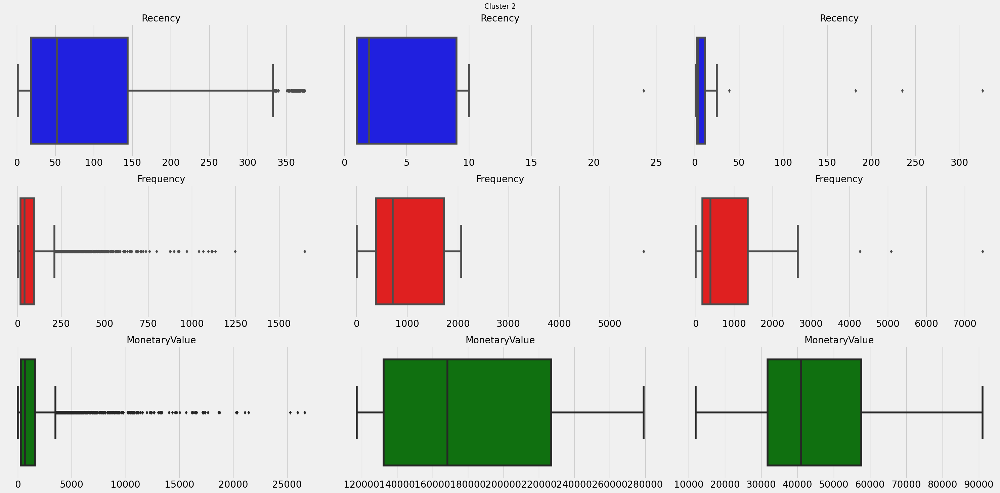

In [669]:
clusters = [rfm.query("Cluster == {}".format(i)) for i in range(3)]
feats = ['Recency', 'Frequency', 'MonetaryValue']
colors = ['blue', 'red', 'green']

plt.figure(figsize=(30, 15))

for i, feat in enumerate(feats):
    for j, cluster in enumerate(clusters):
        plt.subplot(len(feats), len(clusters), i*len(clusters) + j + 1)
        sns.boxplot(x=cluster[feat], color=colors[i])
        plt.title(feat, fontsize=20)
        plt.suptitle(f"Cluster {j}", fontsize=15)
        plt.xticks(fontsize=20)
        plt.xlabel(None)

plt.tight_layout()
plt.show()

In [670]:
# Create mapping from Cluster to Status
cluster_to_status = {0: "Low value", 1: "High value", 2: "Mid value"}

# Create a backup
rfm_backup = rfm.copy()

# Map the cluster to the status and add it as a new column
rfm["Status"] = rfm["Cluster"].map(cluster_to_status)

# Reset index before merge
rfm_reset = rfm.reset_index()

# Create backup
beforeRFM_data = data.copy()

# Merge the two dataframes on CustomerID
cluster_data = pd.merge(data, rfm_reset[["CustomerID", "Status"]], on="CustomerID", how="left")

# Save data as a csv file
cluster_data.to_csv("Cleaned Dataset/cluster.csv")

cluster_data.head()

,InvoiceNo,InvoiceDate,StockCode,Description,Quantity,UnitPrice,Revenue,CustomerID,Country,invoiceDate_norm,Year,YearMonth,Month,MonthDate,DayofMonth,Hour,DayofWeek,Month_name,Day_name,Quarterly,Status
0,536365,2010-12-01 08:26:00,21730,holder star frosted tlight glass,6,4.25,25.50,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday,2010Q4,Low value
1,536365,2010-12-01 08:26:00,22752,7 set nesting babushka boxes,2,7.65,15.30,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday,2010Q4,Low value
2,536365,2010-12-01 08:26:00,71053,moroccan white lantern metal,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday,2010Q4,Low value
3,536365,2010-12-01 08:26:00,84029E,red hottie white heart woolly,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday,2010Q4,Low value
4,536365,2010-12-01 08:26:00,84029G,water flag bottle hot knitted union,6,3.39,20.34,17850,United Kingdom,2010-12-01,2010,2010-12,12,12-01,1,8,2,December,Wednesday,2010Q4,Low value
